In [35]:
# XGBC first version genes
print(X.columns[11],X.columns[28], X.columns[20])
print(X.columns[28],X.columns[11], X.columns[19])

Hn1 Fxyd1 Cplx2
Fxyd1 Hn1 Nrxn3


In [ ]:
# 多项式转换fit
poly_transformer = PolynomialFeatures(degree = 2)
poly_transformer.fit(poly_features)

# Transform the features
poly_features = poly_transformer.transform(poly_features)
poly_features_test = poly_transformer.transform(poly_features_test)
print('Polynomial Features shape: ', poly_features.shape)

# XGB调参

In [1]:
import xgboost as xgb
from package.preprocess import load_data
from sklearn.model_selection import KFold, train_test_split
from package.util.func import *
import gc
import warnings
from sklearn.model_selection import GridSearchCV
warnings.filterwarnings('ignore')
features = load_data.read_data(dataset="dentategyrus", use_gene_list=True)

Running scvelo 0.2.2 (python 3.7.3) on 2020-10-09 12:23.
<function read_data at 0x7fb3b56c1ea0> Running time: 0.7785861492156982 Seconds


In [2]:
features

,ID,Luzp2,Arrdc3,Shisa9,Fxyd1,Sphkap,Dpysl3,Rps27l,Gatm,Nfkbia,...,Golga7b,Ctnnd2,Hepacam,Ptn,Tmem47,Osbpl6,Mapk6,Clic4,Pcdh9,target
0,0,0.0,0.000000,0.619133,0.000000,0.0,0.000000,0.619133,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.00000,0.619133,0.0,0.0,0.619133,3.0
1,1,0.0,0.712705,0.000000,0.712705,0.0,0.000000,0.712705,0.000000,0.000000,...,0.000000,0.000000,0.0,0.712705,1.41549,0.000000,0.0,0.0,0.000000,3.0
2,2,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.920456,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.000000,2.0
3,3,0.0,0.000000,0.000000,0.000000,0.0,0.774725,0.000000,0.000000,0.000000,...,0.460583,0.000000,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.000000,1.0
4,4,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.616411,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2925,2925,0.0,0.555424,0.000000,0.000000,0.0,0.000000,0.555424,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.000000,2.0
2926,2926,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.937405,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.000000,1.0
2927,2927,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.796909,3.0
2928,2928,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,2.310487,2.682322,...,0.000000,1.711935,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.000000,1.0


In [9]:
from imblearn.combine import SMOTETomek

labels = features['target']
features = features.drop(columns=['target'])

print("Raw target type ratio:")
print(pd.DataFrame(labels)['target'].value_counts())

sample_solver = SMOTETomek()
features, labels = sample_solver.fit_sample(features, labels)
print("After imbalance processing type ratio:")
print(pd.DataFrame(labels)['target'].value_counts())

X_train, X_test, y_train, y_test = train_test_split(features, labels, stratify=labels, test_size=0.3,random_state=326)

# Extract the ids
test_ids = X_test['ID']

# Remove the ids and target
X_train = X_train.drop(columns=['ID'])
X_test = X_test.drop(columns=['ID'])
# Extract feature names
feature_names = list(X_train.columns)

print('Training Data Shape: ', X_train.shape)
print('Testing Data Shape: ', X_test.shape)

# Convert to np arrays
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)
    
# Create the kfold object
k_fold = KFold(n_splits=5, shuffle=True, random_state=50)

Raw target type ratio:
3    1279
1     751
2     611
0     289
Name: target, dtype: int64
After imbalance processing type ratio:
0    1195
1    1189
2    1153
3    1109
Name: target, dtype: int64
Training Data Shape:  (3252, 52)
Testing Data Shape:  (1394, 52)


In [492]:
other_params = {'booster': 'gbtree',
            'scale_pos_weight':1,
            'max_depth':10,
            'learning_rate':0.01,
            'n_estimators':500,
            'objective':'multi:softmax',
            'n_jobs':-1,
            'gamma':0,
            'min_child_weight':1,
            'max_delta_step':0,
            'subsample':0.85,
            'colsample_bytree':0.7,
            'reg_alpha':0,
            'reg_lambda':1,
            'seed':1440,
            'missing':None,
            'num_class':4}

cv_params ={'n_estimators': [1600, 1700, 1750, 1800]}

model = xgb.XGBClassifier(**other_params)

optimized_XGB = GridSearchCV(estimator=model, param_grid=cv_params, scoring='accuracy', cv=k_fold, verbose=1, n_jobs=-1)
optimized_XGB.fit(X_train, y_train)
print('每轮迭代运行结果:{0}'.format(optimized_XGB.cv_results_['mean_test_score']))
print('参数的最佳取值:{0}'.format(optimized_XGB.best_params_))
print('最佳模型得分:{0}'.format(optimized_XGB.best_score_))

Fitting 5 folds for each of 4 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:  7.3min finished


[23:54:50] WARNING: /Users/wangxin/xgboost/python-package/build/temp.macosx-10.7-x86_64-3.7/xgboost/src/learner.cc:485: 
Parameters: { scale_pos_weight } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


每轮迭代运行结果:[0.73071535 0.7310221  0.7307144  0.73009996]
参数的最佳取值:{'n_estimators': 1700}
最佳模型得分:0.7310220961833865


In [494]:
cv_params = {'max_depth': [10,11,12,13], 'min_child_weight': [ 1,2,3,4]}
other_params = {'booster': 'gbtree',
            'scale_pos_weight':1,
            'max_depth':10,
            'learning_rate':0.01,
            'n_estimators':1700,
            'objective':'multi:softmax',
            'n_jobs':-1,
            'gamma':0,
            'min_child_weight':1,
            'max_delta_step':0,
            'subsample':0.85,
            'colsample_bytree':0.7,
            'reg_alpha':0,
            'reg_lambda':1,
            'seed':1440,
            'missing':None,
            'num_class':4}

model = xgb.XGBClassifier(**other_params)
optimized_XGB = GridSearchCV(estimator=model, param_grid=cv_params, scoring='accuracy', cv=k_fold, verbose=1, n_jobs=-1)
optimized_XGB.fit(X_train, y_train)
print('每轮迭代运行结果:{0}'.format(optimized_XGB.cv_results_['mean_test_score']))
print('参数的最佳取值：{0}'.format(optimized_XGB.best_params_))
print('最佳模型得分:{0}'.format(optimized_XGB.best_score_))

Fitting 5 folds for each of 16 candidates, totalling 80 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed: 12.5min
[Parallel(n_jobs=-1)]: Done  80 out of  80 | elapsed: 26.8min finished


[10:05:31] WARNING: /Users/wangxin/xgboost/python-package/build/temp.macosx-10.7-x86_64-3.7/xgboost/src/learner.cc:485: 
Parameters: { scale_pos_weight } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


每轮迭代运行结果:[0.7310221  0.72702966 0.72426043 0.72364693 0.73102304 0.72456954
 0.72334113 0.7227248  0.73040907 0.72456907 0.7264138  0.72211225
 0.72979511 0.72949072 0.72579936 0.72426137]
参数的最佳取值：{'max_depth': 11, 'min_child_weight': 1}
最佳模型得分:0.7310230414746544


In [495]:
cv_params = {'gamma': [0, 0.01, 0.03, 0.05, 0.07, 0.1]}
other_params = {'booster': 'gbtree',
            'n_estimators':1700,
            'min_child_weight':1,
            'max_depth':11,
            'learning_rate':0.01,
            'scale_pos_weight':1,
            'objective':'multi:softmax',
            'n_jobs':-1,
            'gamma':0, 
            'max_delta_step':0,
            'subsample':0.85,
            'colsample_bytree':0.7,
            'reg_alpha':0,
            'reg_lambda':1,
            'seed':1440,
            'missing':None,
            'num_class':4}

model = xgb.XGBClassifier(**other_params)
optimized_XGB = GridSearchCV(estimator=model, param_grid=cv_params, scoring='accuracy', cv=k_fold, verbose=1, n_jobs=-1)
optimized_XGB.fit(X_train, y_train)
print('每轮迭代运行结果:{0}'.format(optimized_XGB.cv_results_['mean_test_score']))
print('参数的最佳取值：{0}'.format(optimized_XGB.best_params_))
print('最佳模型得分:{0}'.format(optimized_XGB.best_score_))

Fitting 5 folds for each of 6 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed: 10.7min finished


[10:27:59] WARNING: /Users/wangxin/xgboost/python-package/build/temp.macosx-10.7-x86_64-3.7/xgboost/src/learner.cc:485: 
Parameters: { scale_pos_weight } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


每轮迭代运行结果:[0.73102304 0.73133026 0.73255914 0.72917972 0.73071629 0.72979416]
参数的最佳取值：{'gamma': 0.03}
最佳模型得分:0.7325591397849461


In [496]:
cv_params = {'subsample': [0.4, 0.5, 0.6, 0.7, 0.8], 'colsample_bytree': [0.6, 0.7, 0.8, 0.9]}
other_params = {'booster': 'gbtree',
            'n_estimators':1700,
            'min_child_weight':1,
            'max_depth':11,
            'gamma':0.03, 
            'subsample':0.85,
            'colsample_bytree':0.7,
            'learning_rate':0.01,
            'scale_pos_weight':1,
            'objective':'multi:softmax',
            'n_jobs':-1,
            'max_delta_step':0,
            'reg_alpha':0,
            'reg_lambda':1,
            'seed':1440,
            'missing':None,
            'num_class':4}

model = xgb.XGBClassifier(**other_params)
optimized_XGB = GridSearchCV(estimator=model, param_grid=cv_params, scoring='accuracy', cv=k_fold, verbose=1, n_jobs=-1)
optimized_XGB.fit(X_train, y_train)
print('每轮迭代运行结果:{0}'.format(optimized_XGB.cv_results_['mean_test_score']))
print('参数的最佳取值：{0}'.format(optimized_XGB.best_params_))
print('最佳模型得分:{0}'.format(optimized_XGB.best_score_))

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed: 10.7min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed: 32.9min finished


[11:03:33] WARNING: /Users/wangxin/xgboost/python-package/build/temp.macosx-10.7-x86_64-3.7/xgboost/src/learner.cc:485: 
Parameters: { scale_pos_weight } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


每轮迭代运行结果:[0.72887156 0.73132884 0.73348222 0.7288725  0.72979416 0.73133121
 0.73041144 0.73317594 0.73133215 0.73041002 0.7307144  0.73348269
 0.73164221 0.73256528 0.73040671 0.73225334 0.73041144 0.73164173
 0.7325615  0.73255961]
参数的最佳取值：{'colsample_bytree': 0.8, 'subsample': 0.5}
最佳模型得分:0.733482689353657


In [12]:
cv_params = {'reg_alpha': [1,2,3,4], 'reg_lambda': [1,2,3,4]}
other_params = {'booster': 'gbtree',
            'n_estimators':1700,
            'min_child_weight':1,
            'max_depth':11,
            'gamma':0.03, 
            'subsample':0.5,
            'colsample_bytree':0.8,
            'reg_alpha':0,
            'reg_lambda':1,
            'learning_rate':0.01,
            'objective':'multi:softmax',
            'n_jobs':-1,
            'max_delta_step':0,
            'seed':1440,
            'missing':None,
            'num_class':4}

model = xgb.XGBClassifier(**other_params)
optimized_XGB = GridSearchCV(estimator=model, param_grid=cv_params, scoring='accuracy', cv=k_fold, verbose=1, n_jobs=-1)
optimized_XGB.fit(X_train, y_train)
print('每轮迭代运行结果:{0}'.format(optimized_XGB.cv_results_['mean_test_score']))
print('参数的最佳取值：{0}'.format(optimized_XGB.best_params_))
print('最佳模型得分:{0}'.format(optimized_XGB.best_score_))

Fitting 5 folds for each of 16 candidates, totalling 80 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed: 13.4min
[Parallel(n_jobs=-1)]: Done  80 out of  80 | elapsed: 26.4min finished


每轮迭代运行结果:[0.74169443 0.74077278 0.73738816 0.73677325 0.73369916 0.73308425
 0.73154531 0.73154579 0.73031596 0.7293943  0.73246981 0.72724046
 0.72662602 0.72447076 0.72416401 0.72324093]
参数的最佳取值：{'reg_alpha': 1, 'reg_lambda': 1}
最佳模型得分:0.7416944345976604


In [13]:
cv_params = {'learning_rate': [0.01, 0.03, 0.05, 0.07, 0.1]}
other_params = {'booster': 'gbtree',
            'n_estimators':1700,
            'min_child_weight':1,
            'max_depth':11,
            'gamma':0.03, 
            'subsample':0.5,
            'colsample_bytree':0.8,
            'reg_alpha':1,
            'reg_lambda':1,
            'learning_rate':0.03,
            'objective':'multi:softmax',
            'n_jobs':-1,
            'max_delta_step':0,
            'seed':1440,
            'missing':None,
            'num_class':4}

model = xgb.XGBClassifier(**other_params)
optimized_XGB = GridSearchCV(estimator=model, param_grid=cv_params, scoring='accuracy', cv=k_fold, verbose=1, n_jobs=-1)
optimized_XGB.fit(X_train, y_train)
print('每轮迭代运行结果:{0}'.format(optimized_XGB.cv_results_['mean_test_score']))
print('参数的最佳取值：{0}'.format(optimized_XGB.best_params_))
print('最佳模型得分:{0}'.format(optimized_XGB.best_score_))

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  7.3min finished


每轮迭代运行结果:[0.74169443 0.74169585 0.74046556 0.73400922 0.73769633]
参数的最佳取值：{'learning_rate': 0.03}
最佳模型得分:0.7416958525345623


In [ ]:
## XGB

In [59]:
pd.read_csv("./DG_raw.csv")

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,2920,2921,2922,2923,2924,2925,2926,2927,2928,2929
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0
3,3,2.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,...,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13908,13908,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13909,13909,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
13910,13910,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13911,13911,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [49]:
pd.read_csv("./lamanno_downsampled.csv")

,Unnamed: 0,1772096_095_C09,1772121_291_D10,1772122_201_E04,1772122_226_A12,1772078_001_H05,1772122_220_G10,1772122_223_C09,1772122_203_F08,1772122_199_C05,...,1772122_200_E06,1772078_002_E07,1772122_236_F02,1772122_207_G01,1772122_264_C10,1772121_291_G08,1772122_236_G05,1772122_223_C10,1772122_220_A09,1772122_223_E04
0,'MARC1',0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,'MARC2',0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,'MARCH1',0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,'MARCH10',0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,'MARCH2',0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20555,ZYG11A,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20556,ZYG11B,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
20557,ZYX,0,0,0,0,0,1,0,0,1,...,0,0,0,1,0,0,0,0,0,0
20558,ZZEF1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [41]:
pd.read_csv("./DG_denoised.csv")

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X2920,X2921,X2922,X2923,X2924,X2925,X2926,X2927,X2928,X2929
0,0.002,0.005,0.003,0.001,0.003,0.001,0.002,0.001,0.018,0.002,...,0.001,0.004,0.006,0.004,0.019,0.001,0.002,0.003,0.019,0.004
1,0.139,0.675,0.140,0.043,0.152,0.053,0.121,0.049,0.049,0.144,...,0.092,0.065,0.089,0.166,0.141,0.115,0.064,0.083,0.061,0.125
2,0.086,0.069,0.153,0.106,0.084,0.155,0.084,0.098,0.072,0.104,...,0.334,0.138,0.091,0.118,0.096,0.211,0.146,0.082,0.081,0.112
3,0.592,0.201,0.265,0.183,0.248,0.251,0.451,0.222,0.087,0.347,...,0.206,0.410,0.330,0.441,0.225,0.230,0.174,0.303,0.096,0.311
4,0.018,0.004,0.033,0.018,0.014,0.006,0.034,0.025,0.005,0.024,...,0.007,0.064,0.053,0.027,0.002,0.024,0.005,0.033,0.010,0.033
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13908,0.024,0.006,0.033,0.001,0.035,0.001,0.049,0.001,0.008,0.079,...,0.001,0.036,0.067,0.044,0.002,0.005,0.001,0.034,0.013,0.038
13909,0.155,0.061,0.103,0.004,0.122,0.003,0.151,0.006,0.133,0.198,...,0.007,0.156,0.309,0.156,0.044,0.018,0.006,0.165,0.158,0.395
13910,0.259,0.131,0.163,0.283,0.319,0.410,0.287,0.275,0.170,0.336,...,0.142,0.184,0.536,0.309,0.262,0.228,0.281,0.266,0.162,0.321
13911,0.012,0.001,0.008,0.001,0.009,0.001,0.009,0.001,0.001,0.007,...,0.001,0.016,0.019,0.014,0.002,0.003,0.001,0.013,0.001,0.020


In [40]:
after.drop(after.columns[0], axis=1, inplace=True)

In [17]:
print(X.columns[11],X.columns[28], X.columns[20])
print(X.columns[28],X.columns[11], X.columns[19])

Hn1 Fxyd1 Cplx2
Fxyd1 Hn1 Nrxn3


In [18]:
print(X.columns[21],X.columns[20], X.columns[44])
print(X.columns[20],X.columns[21], X.columns[37])

Nfix Cplx2 Nfib
Cplx2 Nfix Pnp


# pipe test

In [3]:
import scvelo as scv
adata = scv.datasets.dentategyrus()
scv.pp.filter_and_normalize(adata, min_shared_counts=30, n_top_genes=2000)
# this is on pca space，compute moments
scv.pp.moments(adata, n_pcs=30, n_neighbors=30, mode='connectivities')
# scv.tl.recover_dynamics(adata)
scv.tl.velocity(adata, mode='stochastic')

Filtered out 11019 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [4]:
scv.tl.velocity_graph(adata)
# scv.tl.umap(adata)
# scv.pl.velocity_graph(adata)

computing velocity graph
    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


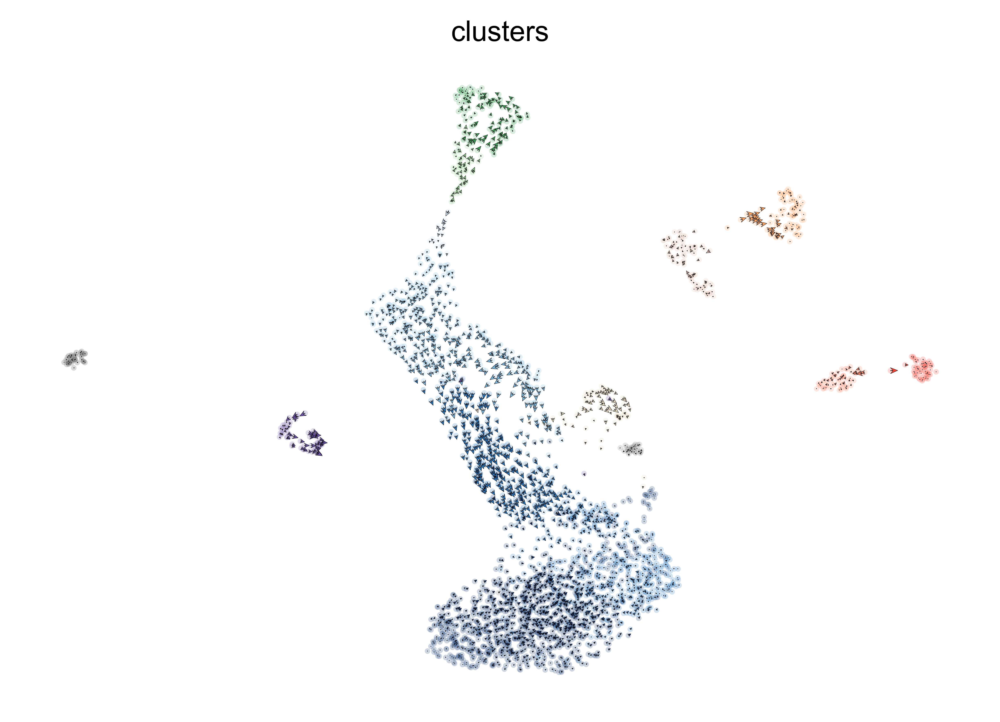

In [6]:
scv.pl.velocity_embedding(adata, basis='umap', arrow_length=1.5, arrow_size=1.5, dpi=1000)

In [62]:
from package.preprocess import feature_engineering
gene_list = feature_engineering.feature_selection(adata, top_k=20)

ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [115]:
from package.util.func import *
V = pd.DataFrame(adata.obsm["velocity_umap"], columns=["V_xcom", "V_ycom"])
direction = get_direction(V, num_class= 4)

In [159]:
adata.X.A

array([[0.        , 0.99865717, 0.        , ..., 0.        , 0.        ,
        3.252782  ],
       [0.7127054 , 0.        , 0.7127054 , ..., 0.        , 0.        ,
        1.979208  ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        3.6176643 ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        2.959073  ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        3.340669  ],
       [0.        , 0.        , 0.        , ..., 0.5411462 , 0.        ,
        3.683129  ]], dtype=float32)

In [166]:
X = pd.DataFrame(adata.X.A, columns=adata.var_names)
X = pd.DataFrame(X, columns=gene_list.tolist())
F = pd.concat([X, direction], axis=1)
F = F.reset_index().rename(columns={'index': 'ID'})
F

,ID,Fdps,Shisa9,Slc6a1,Rap1a,Spock2,Hn1,Tmsb10,Brinp3,Pgm2l1,...,Serpine2,Utrn,Ptprz1,Tcf3,Pnp,Glud1,Ntm,Sept7,Atp2b1,target
0,0,0.000000,0.619133,0.000000,0.000000,0.000000,0.998657,0.000000,0.0,0.000000,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.619133,0.998657,0.0
1,1,0.000000,0.000000,0.712705,0.000000,0.000000,1.124606,1.415490,0.0,0.000000,...,0.0,0.0,1.64055,0.0,0.712705,1.124606,0.0,0.000000,0.000000,0.0
2,2,0.000000,0.000000,0.000000,0.000000,0.920456,0.000000,0.000000,0.0,0.000000,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.920456,0.920456,0.0
3,3,0.000000,0.000000,0.000000,0.460583,0.460583,1.205968,3.370047,0.0,0.000000,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,1.013415,1.0
4,4,0.000000,0.000000,0.000000,0.616411,0.000000,0.000000,0.994931,0.0,0.000000,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,0.616411,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2925,2925,0.910418,0.000000,0.000000,0.000000,0.000000,0.555424,1.937510,0.0,0.555424,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.910418,0.000000,1.0
2926,2926,0.000000,0.000000,0.000000,0.000000,0.000000,2.474303,4.094797,0.0,0.000000,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,0.937405,1.0
2927,2927,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.796909,0.0,0.000000,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,1.234699,0.796909,0.0
2928,2928,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,...,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,1.184739,1.0


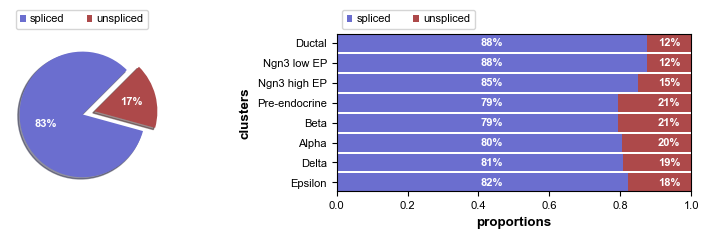

Filtered out 21611 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


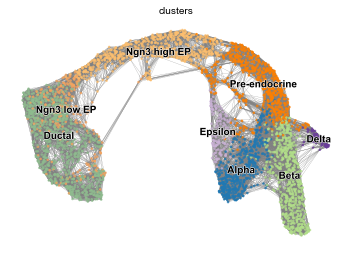

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


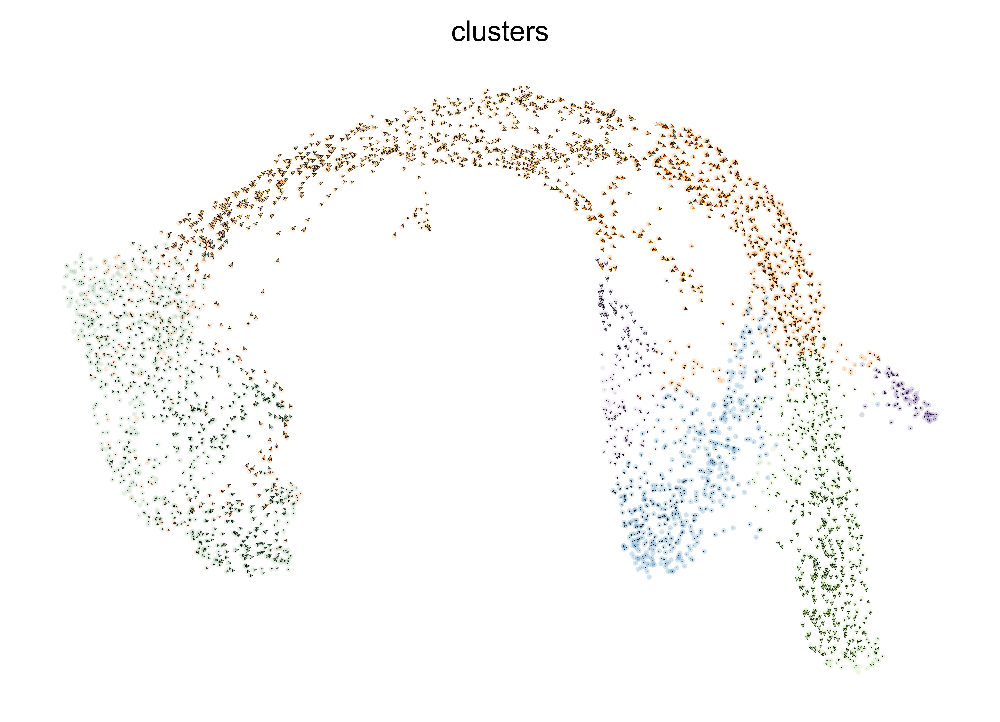

<function gain_data at 0x7f833a631e18> Running time: 46.03170919418335 Seconds
ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.9718048572540283 Seconds


,ID,Zdbf2,Pax6,Unc5c,Heg1,Pde1c,Ptprs,Sdk1,Ptpn3,Notch2,...,Ica1,Tmcc3,Prune2,Hacd1,Nnat,Krt19,Hspa8,Pclo,Zcchc16,target
0,0,0.000000,0.811065,0.0,0.0,0.0,0.0,0.811065,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.252936,1.558336,0.000000,0.0,1.0
1,1,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.833514,0.000000,0.0,3.0
2,2,1.397169,1.716605,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.925000,1.397169,0.925000,0.000000,1.716605,0.000000,2.315620,0.000000,0.0,2.0
3,3,0.554306,0.000000,0.0,0.0,0.0,0.0,0.000000,0.554306,0.554306,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.554306,1.548341,0.000000,0.0,1.0
4,4,0.803073,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.803073,0.000000,0.000000,0.000000,1.242650,0.000000,2.264545,0.803073,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3691,3691,1.472327,1.615666,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.513945,0.513945,0.000000,0.513945,0.513945,0.000000,2.572133,0.513945,0.0,1.0
3692,3692,0.614497,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.979195,0.000000,0.0,0.0
3693,3693,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.780891,0.000000,2.091925,2.228283,0.000000,0.0,3.0
3694,3694,0.472316,0.472316,0.0,0.0,0.0,0.0,0.000000,0.472316,0.000000,...,0.000000,0.000000,0.472316,0.472316,0.472316,0.000000,1.951187,0.000000,0.0,2.0


In [30]:
from package.preprocess.load_data import read_data, gain_data
adata = gain_data(dataset="pancreas")
get_gene_list(adata, dataset="pancreas", top_k=3)
X = read_data(dataset="pancreas", num_class=4, use_gene_list=True)
X

Raw target type ratio:


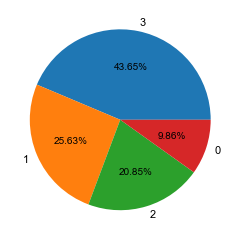

SMOTE balance score is  0.7446607783942558
              precision    recall  f1-score   support

           0       0.83      0.82      0.82       384
           1       0.76      0.74      0.75       384
           2       0.71      0.62      0.67       384
           3       0.69      0.80      0.74       383

    accuracy                           0.74      1535
   macro avg       0.75      0.74      0.74      1535
weighted avg       0.75      0.74      0.74      1535

ADASYN balance score is  0.7272366350151575
              precision    recall  f1-score   support

           0       0.77      0.79      0.78       404
           1       0.75      0.73      0.74       421
           2       0.71      0.60      0.65       366
           3       0.69      0.79      0.73       384

    accuracy                           0.73      1575
   macro avg       0.73      0.73      0.73      1575
weighted avg       0.73      0.73      0.73      1575

BLS balance score is  0.7635528856614446
  

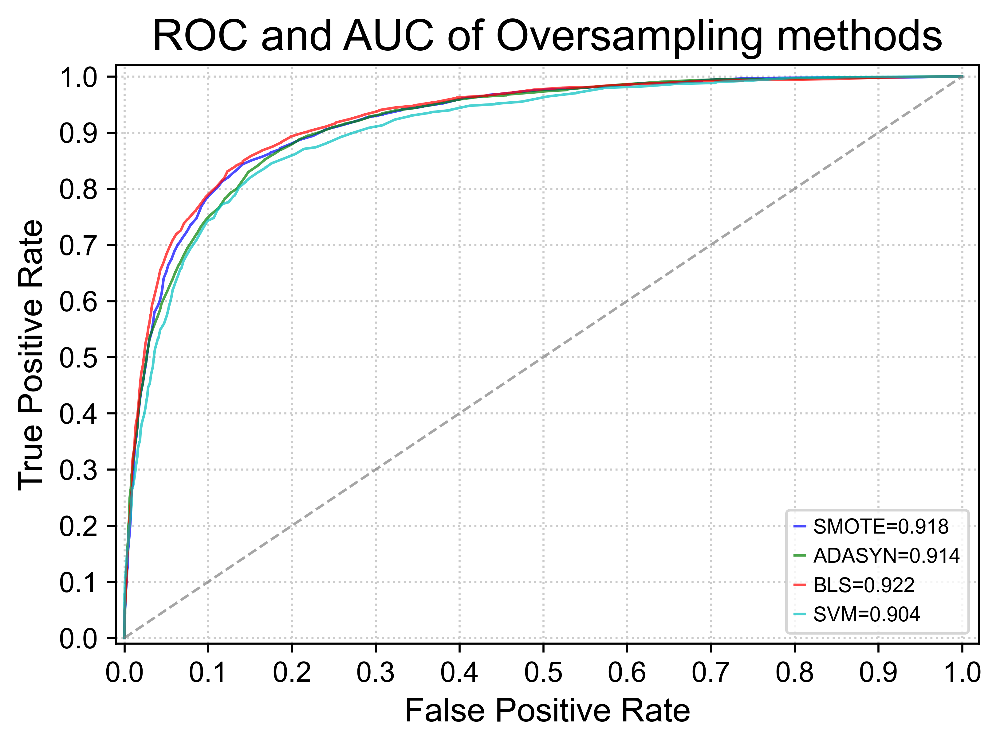

In [17]:
from package.test.sampling_test import *
test_oversample(X)

Raw target type ratio:


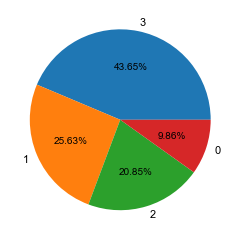

LogisticCV balance score is  0.453084781891841
              precision    recall  f1-score   support

           0       0.23      0.26      0.25        87
           1       0.55      0.65      0.60       225
           2       0.46      0.20      0.28       183
           3       0.62      0.70      0.66       384

    accuracy                           0.54       879
   macro avg       0.46      0.45      0.44       879
weighted avg       0.53      0.54      0.52       879

RandomForest balance score is  0.5189235325984549
              precision    recall  f1-score   support

           0       0.56      0.16      0.25        87
           1       0.67      0.65      0.66       225
           2       0.62      0.36      0.45       183
           3       0.66      0.91      0.76       384

    accuracy                           0.65       879
   macro avg       0.63      0.52      0.53       879
weighted avg       0.64      0.65      0.62       879

BBC balance score is  0.536686893

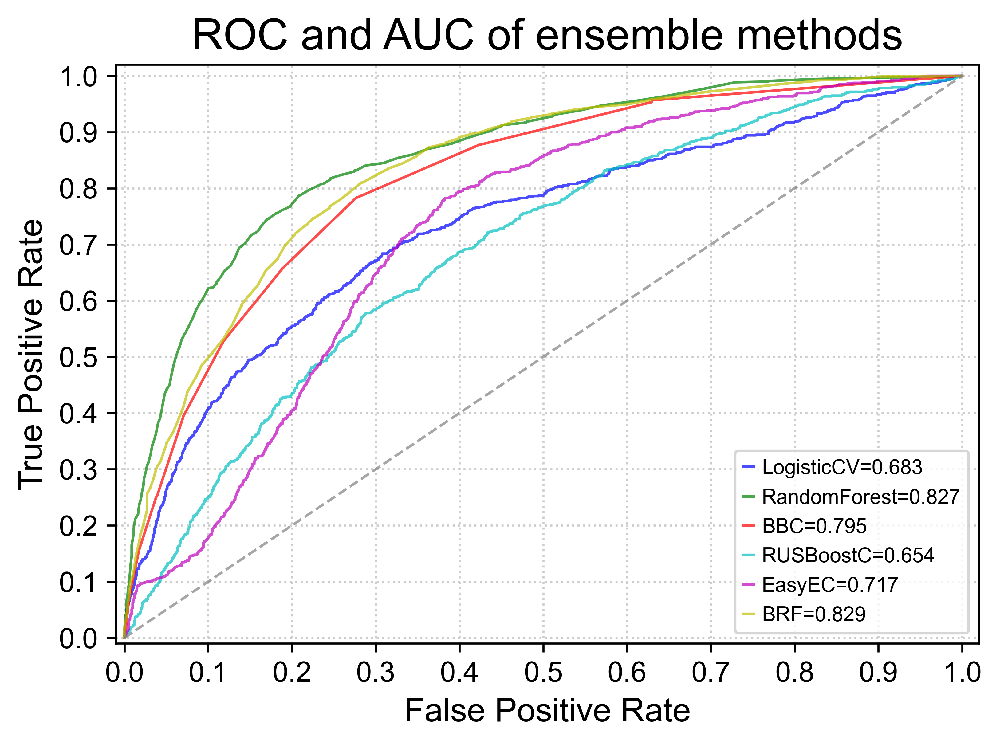

In [19]:
test_ensemble(X)

### 过采样图

Raw target type ratio:


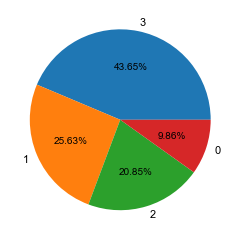

origin balance score is  0.5189235325984549
              precision    recall  f1-score   support

           0       0.56      0.16      0.25        87
           1       0.67      0.65      0.66       225
           2       0.62      0.36      0.45       183
           3       0.66      0.91      0.76       384

    accuracy                           0.65       879
   macro avg       0.63      0.52      0.53       879
weighted avg       0.64      0.65      0.62       879

SMOTE balance score is  0.7401017868798956
              precision    recall  f1-score   support

           0       0.82      0.79      0.81       384
           1       0.75      0.72      0.74       384
           2       0.72      0.65      0.69       384
           3       0.67      0.80      0.73       383

    accuracy                           0.74      1535
   macro avg       0.74      0.74      0.74      1535
weighted avg       0.74      0.74      0.74      1535

ADASYN balance score is  0.7322548508918222

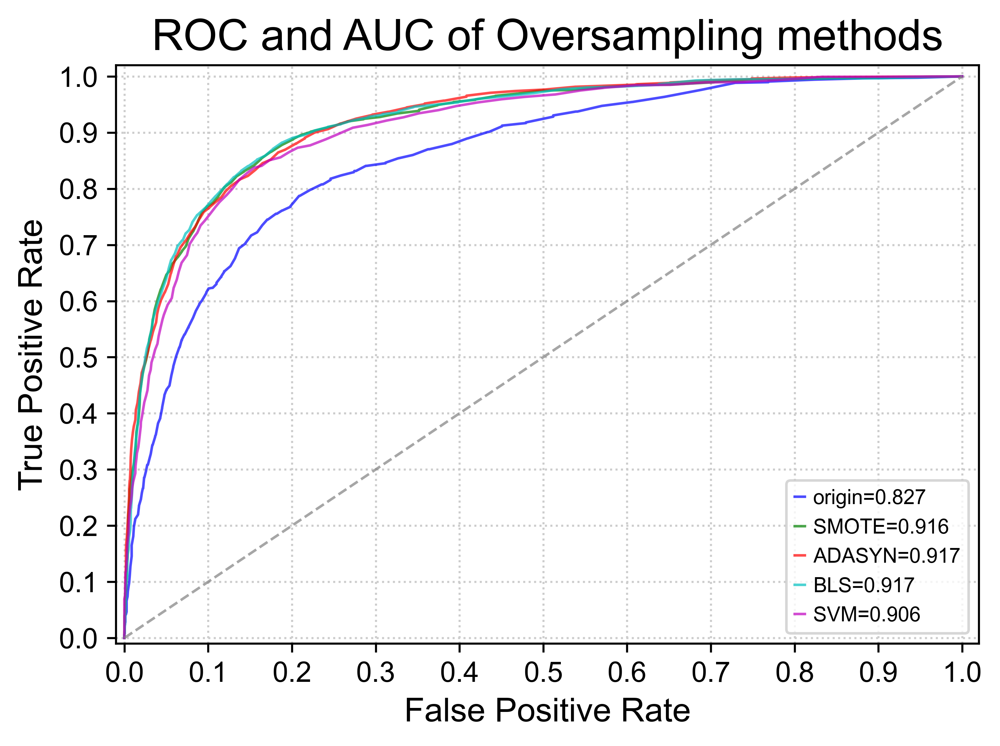

In [18]:
def test_oversample(X, num_class=4):
    # Extract the labels for training
    labels = X['target']
    target_names = [str(i) for i in range(num_class)]

    # Remove the target
    X = X.drop(columns=['target'])

    print("Raw target type ratio:")
    plot_fraction(labels, num_class = num_class)
    plt.figure(dpi=600)
    colorlist = ["b", "g", "r", "c", "m", "y", "k"]
    modelist = ["origin", "SMOTE", "ADASYN", "BLS", "SVM"]

    for i in range(len(modelist)):
        model_name = modelist[i]
        if model_name == "origin": 
            X_all, y_all = X, labels
        else:
            if model_name == "SMOTE":
                sample_solver = SMOTE()
            elif model_name == "ADASYN":
                sample_solver = ADASYN()
            elif model_name == "BLS":
                sample_solver = BorderlineSMOTE()
            elif model_name == "SVM":
                sample_solver = SVMSMOTE()
            
            X_all, y_all = sample_solver.fit_sample(X, labels)
        
        X_train, X_test, y_train, y_test = train_test_split(X_all, y_all, stratify=y_all, test_size=0.3, random_state=326)
        X_train = X_train.drop(columns=["ID"])
        # Extract the ids
        test_ids = X_test['ID']
        X_test = X_test.drop(columns=['ID'])

        # Extract feature names
        feature_names = list(X_train.columns)

        model = RandomForestClassifier(random_state=0)

        # 原始是黑色
        model.fit(X_train, y_train)
        test_predictions = model.predict_proba(X_test)
        plot_auc_temp(y_test, test_predictions, num_class, name=model_name, c=colorlist[i])
        test_predictions = get_result(test_predictions)
        print(model_name+ " balance score is ", balanced_accuracy_score(y_test, test_predictions))

        test_real = pd.DataFrame({'ID': test_ids, 'real_class': y_test})
        test_predict = pd.DataFrame({'ID': test_ids, 'predict_class': test_predictions})
        print(classification_report(list(test_real["real_class"]), list(test_predict["predict_class"]),
                                    target_names=target_names))
        gc.enable()
        del model
        gc.collect()

    plt.plot((0, 1), (0, 1), c='#808080', lw=1, ls='--', alpha=0.7)
    plt.xlim((-0.01, 1.02))
    plt.ylim((-0.01, 1.02))
    plt.xticks(np.arange(0, 1.1, 0.1))
    plt.yticks(np.arange(0, 1.1, 0.1))
    plt.xlabel('False Positive Rate', fontsize=13)
    plt.ylabel('True Positive Rate', fontsize=13)
    plt.grid(b=True, ls=':')
    plt.legend(loc='lower right', fancybox=True, framealpha=0.8, fontsize=8)
    plt.title('ROC and AUC of Oversampling methods', fontsize=17)
    plt.show()
    return
test_oversample(X)

In [93]:
from sklearn.ensemble import GradientBoostingClassifier as GBDT
from sklearn.ensemble import ExtraTreesClassifier as ET
# from sklearn.ensemble import RandomForestClassifier as RF
from sklearn.ensemble import AdaBoostClassifier as ADA
def stacking_model(features,num_class = 8, RANDOM_SEED=326):
    labels = features['target']
    features = features.drop(columns=['target'])

    print("Raw target type ratio:")
    plot_fraction(labels, num_class=num_class)
    sample_solver = SMOTETomek()
    features, labels = sample_solver.fit_sample(features, labels)
    print("After imbalance processing type ratio:")
    plot_fraction(labels, num_class=num_class)

    X_train, X_test, y_train, y_test = train_test_split(features, labels, stratify=labels, test_size=0.3, random_state=RANDOM_SEED)

    # Extract the ids
    test_ids = X_test['ID']

    # Remove the ids and target
    X_train = X_train.drop(columns=['ID'])
    X_test = X_test.drop(columns=['ID'])
    # Extract feature names
    feature_names = list(X_train.columns)

    print('Training Data Shape: ', X_train.shape)
    print('Testing Data Shape: ', X_test.shape)

    # Convert to np arrays
    X_train = np.array(X_train)
    y_train = np.array(y_train)
    X_test = np.array(X_test)
    y_test = np.array(y_test)


    clf1 = BalancedRandomForestClassifier(n_estimators=100, random_state=326)

    clf3 = GBDT(n_estimators=100)
    clf4 = ET(n_estimators=100)
    clf5 = ADA(n_estimators=100)
    clf2 = xgb.XGBClassifier(
            # 初始得分
            base_score=0.5,
            # 基分类器类型
            booster='gbtree',
            # 树最大深度，越大越容易过拟合
            max_depth=11,
            # 学习率
            learning_rate=0.03,
            # 估计器的数量
            n_estimators=1700,
            # 目标参数
            objective='multi:softmax',
            # 线程数
            n_jobs=-1,
            # 分裂所需的最小损失减少量
            gamma=0.03,
            # 拆分节点权重和的阈值
            min_child_weight=1,
            # 最大权重估计，1-10，数字越大越保守
            max_delta_step=0,
            # 随机选取的比例
            subsample=0.5,
            # 每棵树特征选取范围
            colsample_bytree=0.8,
            # L1正则化参数
            reg_alpha=1,
            # L2正则化参数
            reg_lambda=1,
            seed=0,
            missing=None, num_class=num_class)


    lr = LogisticRegression()
    sclf = StackingCVClassifier(classifiers=[clf1, clf3, clf4, clf2],
                                meta_classifier=lr,
                                random_state=RANDOM_SEED)
    sclf.fit(X_train, y_train)
    test_predictions = sclf.predict_proba(X_test)
    plot_auc(y_test, test_predictions, num_class=8)

    test_predictions = get_result(test_predictions)
    test_predict = pd.DataFrame({'ID': test_ids, 'predict_class': test_predictions})
    test_real = pd.DataFrame({'ID': test_ids, 'real_class': y_test})
    print("balanced_acc_score is ", balanced_accuracy_score(y_test, test_predictions))

    return test_real, test_predict


Raw target type ratio:


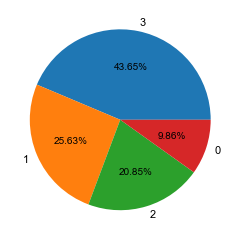

After imbalance processing type ratio:


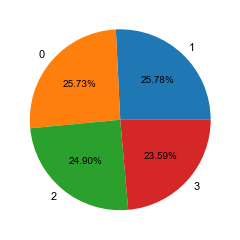

KNN balance score is  0.6310493029257113
              precision    recall  f1-score   support

           0       0.62      0.92      0.74       353
           1       0.71      0.61      0.66       354
           2       0.58      0.68      0.62       342
           3       0.71      0.32      0.44       324

    accuracy                           0.64      1373
   macro avg       0.66      0.63      0.61      1373
weighted avg       0.65      0.64      0.62      1373

GNB balance score is  0.4985713122676233
              precision    recall  f1-score   support

           0       0.67      0.38      0.49       353
           1       0.51      0.63      0.56       354
           2       0.42      0.61      0.49       342
           3       0.52      0.38      0.44       324

    accuracy                           0.50      1373
   macro avg       0.53      0.50      0.49      1373
weighted avg       0.53      0.50      0.50      1373

RF balance score is  0.7447764880757669
        

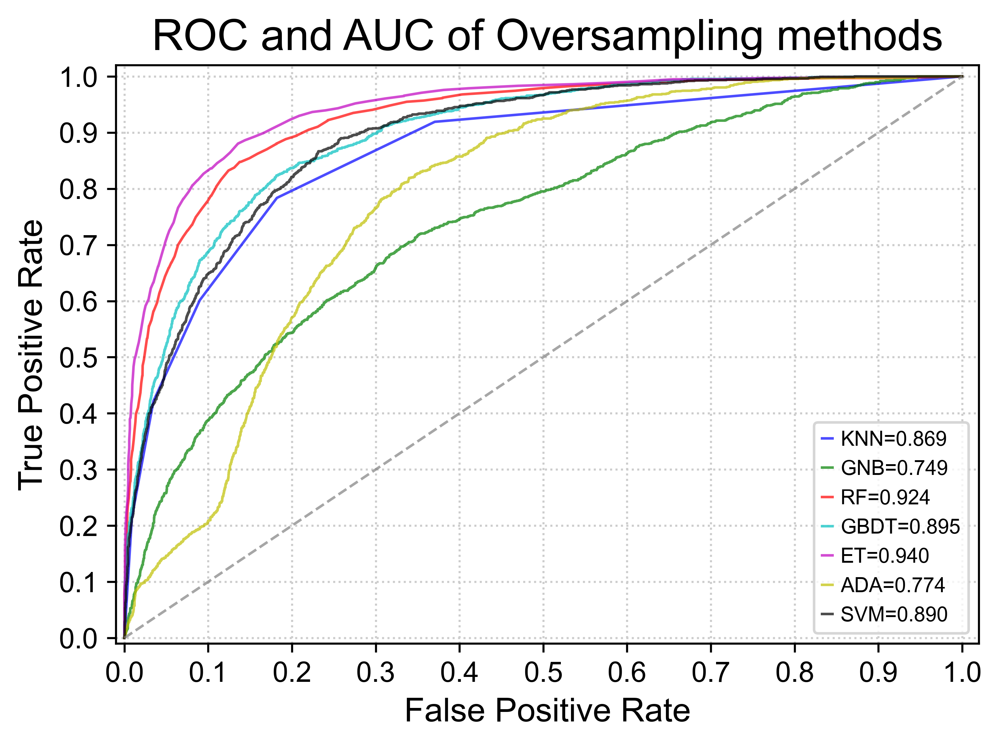

In [28]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier as GBDT
from sklearn.ensemble import ExtraTreesClassifier as ET
from sklearn.ensemble import AdaBoostClassifier as ADA
from sklearn.svm import SVC
def test_base(X, num_class=4):
    # Extract the labels for training
    labels = X['target']
    target_names = [str(i) for i in range(num_class)]
    # Remove the target
    X = X.drop(columns=['target'])
    
    print("Raw target type ratio:")
    plot_fraction(labels, num_class=num_class)
    sample_solver = SMOTETomek()
    X, labels = sample_solver.fit_sample(X, labels)
    print("After imbalance processing type ratio:")
    plot_fraction(labels, num_class=num_class)

    colorlist = ["b", "g", "r", "c", "m", "y", "k"]
    modelist = ["KNN", "GNB", "RF", "GBDT","ET", "ADA", "SVM"]
    X_train, X_test, y_train, y_test = train_test_split(X, labels, stratify=labels, test_size=0.3, random_state=326)
    X_train = X_train.drop(columns=["ID"])
    # Extract the ids
    test_ids = X_test['ID']
    X_test = X_test.drop(columns=['ID'])

    # Extract feature names
    feature_names = list(X_train.columns)
    plt.figure(dpi=600)
    
    for i in range(len(modelist)):
        model_name = modelist[i]
        if model_name == "KNN": 
            model = KNeighborsClassifier()
        elif model_name == "GNB":
            model = GaussianNB()
        elif model_name == "RF":
            model = RandomForestClassifier(random_state=0)
        elif model_name == "GBDT":
            model = GBDT(random_state=0)
        elif model_name == "ET":
            model = ET(random_state = 0)
        elif model_name == "ADA":
            model = ADA(random_state=0)
        elif model_name == "SVM":
            model = SVC(random_state=0,probability=True,kernel="rbf")
        
        # 原始是黑色
        model.fit(X_train, y_train)
        test_predictions = model.predict_proba(X_test)
        plot_auc_temp(y_test, test_predictions, num_class, name=model_name, c=colorlist[i])
        test_predictions = get_result(test_predictions)
        print(model_name+ " balance score is ", balanced_accuracy_score(y_test, test_predictions))

        test_real = pd.DataFrame({'ID': test_ids, 'real_class': y_test})
        test_predict = pd.DataFrame({'ID': test_ids, 'predict_class': test_predictions})
        print(classification_report(list(test_real["real_class"]), list(test_predict["predict_class"]),
                                    target_names=target_names))
        gc.enable()
        del model
        gc.collect()

    plt.plot((0, 1), (0, 1), c='#808080', lw=1, ls='--', alpha=0.7)
    plt.xlim((-0.01, 1.02))
    plt.ylim((-0.01, 1.02))
    plt.xticks(np.arange(0, 1.1, 0.1))
    plt.yticks(np.arange(0, 1.1, 0.1))
    plt.xlabel('False Positive Rate', fontsize=13)
    plt.ylabel('True Positive Rate', fontsize=13)
    plt.grid(b=True, ls=':')
    plt.legend(loc='lower right', fancybox=True, framealpha=0.8, fontsize=8)
    plt.title('ROC and AUC of Oversampling methods', fontsize=17)
    plt.show()
    return
test_base(X)

Raw target type ratio:


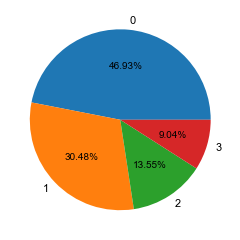

 balance score is  0.5821435991799995
              precision    recall  f1-score   support

           0       0.72      0.95      0.82       412
           1       0.77      0.69      0.73       268
           2       0.86      0.47      0.61       119
           3       0.65      0.21      0.32        80

    accuracy                           0.74       879
   macro avg       0.75      0.58      0.62       879
weighted avg       0.75      0.74      0.72       879



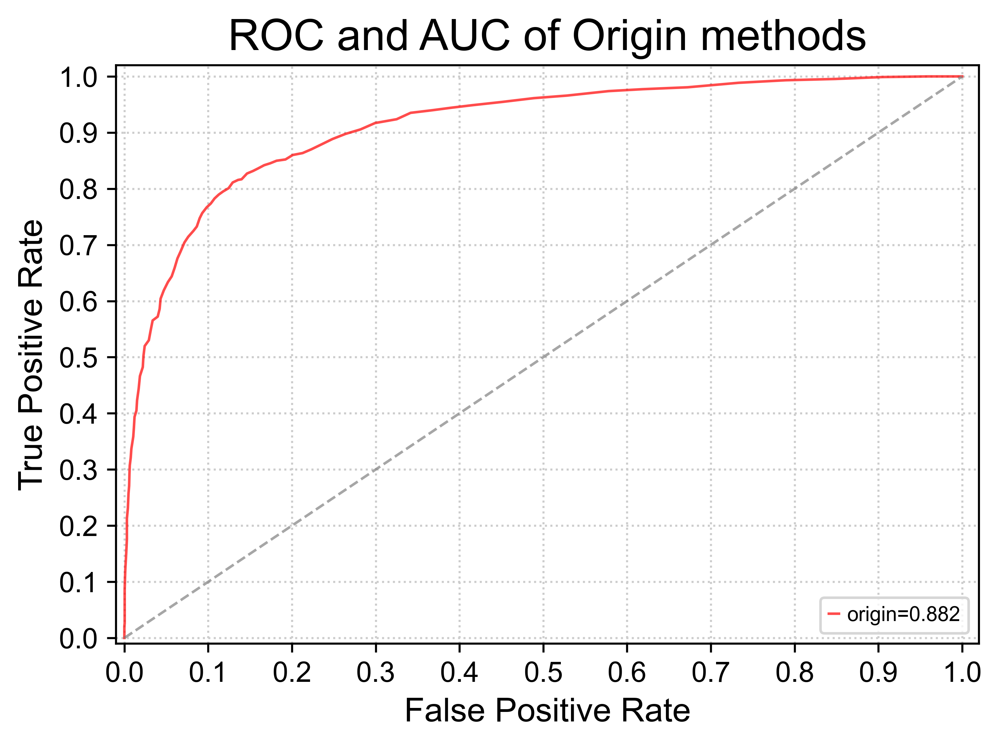

In [117]:
from sklearn.ensemble import RandomForestClassifier
def origin( X, num_class=4):
    # Extract the labels for training
    labels = X['target']
    target_names = [str(i) for i in range(num_class)]

    # Remove the target
    X = X.drop(columns=['target'])

    print("Raw target type ratio:")
    plot_fraction(labels, num_class=num_class)
    plt.figure(dpi=600)

    X_train, X_test, y_train, y_test = train_test_split(X, labels, stratify=labels, test_size=0.3,
                                                            random_state=326)
    X_train = X_train.drop(columns=["ID"])
    # Extract the ids
    test_ids = X_test['ID']
    X_test = X_test.drop(columns=['ID'])

    # Extract feature names
    feature_names = list(X_train.columns)

    model = RandomForestClassifier(random_state=0)

    # 原始是黑色
    model.fit(X_train, y_train)
    test_predictions = model.predict_proba(X_test)
    plot_auc_temp(y_test, test_predictions, num_class, name="origin", c="r")
    test_predictions = get_result(test_predictions)
    print(" balance score is ", balanced_accuracy_score(y_test, test_predictions))

    test_real = pd.DataFrame({'ID': test_ids, 'real_class': y_test})
    test_predict = pd.DataFrame({'ID': test_ids, 'predict_class': test_predictions})
    print(classification_report(list(test_real["real_class"]), list(test_predict["predict_class"]),
                                    target_names=target_names))

    plt.plot((0, 1), (0, 1), c='#808080', lw=1, ls='--', alpha=0.7)
    plt.xlim((-0.01, 1.02))
    plt.ylim((-0.01, 1.02))
    plt.xticks(np.arange(0, 1.1, 0.1))
    plt.yticks(np.arange(0, 1.1, 0.1))
    plt.xlabel('False Positive Rate', fontsize=13)
    plt.ylabel('True Positive Rate', fontsize=13)
    plt.grid(b=True, ls=':')
    plt.legend(loc='lower right', fancybox=True, framealpha=0.8, fontsize=8)
    plt.title('ROC and AUC of Origin methods', fontsize=17)
    plt.show()
    return
origin(F,4)

In [111]:
def test_base(features,num_class = 8, RANDOM_SEED=326):
    labels = features['target']
    features = features.drop(columns=['target'])
    target_names = [str(i) for i in range(num_class)]

    # print("Raw target type ratio:")
    # plot_fraction(labels, num_class=num_class)
    # sample_solver = SMOTETomek()
    # features, labels = sample_solver.fit_sample(features, labels)
    # print("After imbalance processing type ratio:")
    # plot_fraction(labels, num_class=num_class)

    X_train, X_test, y_train, y_test = train_test_split(features, labels, stratify=labels, test_size=0.3, random_state=RANDOM_SEED)

    # Extract the ids
    test_ids = X_test['ID']

    # Remove the ids and target
    X_train = X_train.drop(columns=['ID'])
    X_test = X_test.drop(columns=['ID'])
    # Extract feature names
    feature_names = list(X_train.columns)

    print('Training Data Shape: ', X_train.shape)
    print('Testing Data Shape: ', X_test.shape)

    # Convert to np arrays
    X_train = np.array(X_train)
    y_train = np.array(y_train)
    X_test = np.array(X_test)
    y_test = np.array(y_test)
    
    plt.figure(dpi=600)
    colorlist = ["b", "g", "r", "c", "m", "y", "k"]
    modelist = ["BRF", "GBDT", "ET", "ADA"]
    for i in range(len(modelist)):
        model_name = modelist[i]
        if model_name =="BRF":
            model = BalancedRandomForestClassifier(n_estimators=100, random_state=326)
        elif model_name == "GBDT":
            model = GBDT(n_estimators=100)
        elif model_name == "ET":
            model = ET(n_estimators=100)
        elif model_name == "ADA":
            model = ADA(n_estimators=100)
            
        model.fit(X_train, y_train)
        test_predictions = model.predict_proba(X_test)
        plot_auc_temp(y_test, test_predictions, num_class, name=model_name, c=colorlist[i])
        test_predictions = get_result(test_predictions)
        print(model_name+ " balance score is ", balanced_accuracy_score(y_test, test_predictions))

        test_real = pd.DataFrame({'ID': test_ids, 'real_class': y_test})
        test_predict = pd.DataFrame({'ID': test_ids, 'predict_class': test_predictions})
        print(classification_report(list(test_real["real_class"]), list(test_predict["predict_class"]),
                                    target_names=target_names))
        gc.enable()
        del model
        gc.collect()
    plt.plot((0, 1), (0, 1), c='#808080', lw=1, ls='--', alpha=0.7)
    plt.xlim((-0.01, 1.02))
    plt.ylim((-0.01, 1.02))
    plt.xticks(np.arange(0, 1.1, 0.1))
    plt.yticks(np.arange(0, 1.1, 0.1))
    plt.xlabel('False Positive Rate', fontsize=13)
    plt.ylabel('True Positive Rate', fontsize=13)
    plt.grid(b=True, ls=':')
    plt.legend(loc='lower right', fancybox=True, framealpha=0.8, fontsize=8)
    plt.title('ROC and AUC of ensemble methods', fontsize=17)
    plt.show()
    return
def plot_auc_temp(y_test, y_score, num_class, name, c='r'):
    # not show
    y_one_hot = label_binarize(y_test, classes=[i for i in range(num_class)])
    fpr, tpr, thresholds = roc_curve(y_one_hot.ravel(), y_score.ravel())
    # micro_auc = auc(fpr, tpr)
    macro_auc = roc_auc_score(y_one_hot, y_score, average="macro")
    plt.plot(fpr, tpr, c=c, lw=1, alpha=0.7, label= name + '=%.3f' % macro_auc)

Raw target type ratio:


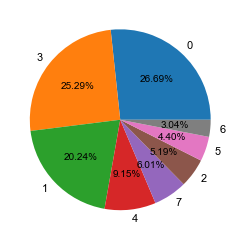

After imbalance processing type ratio:


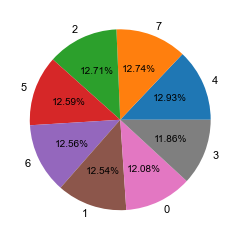

Training Data Shape:  (4097, 149)
Testing Data Shape:  (1757, 149)
BRF balance score is  0.7910758086369374
              precision    recall  f1-score   support

           0       0.52      0.65      0.58       212
           1       0.59      0.62      0.61       220
           2       0.89      0.92      0.90       224
           3       0.89      0.59      0.71       208
           4       0.82      0.86      0.84       227
           5       0.94      0.87      0.90       221
           6       0.95      0.96      0.96       221
           7       0.86      0.85      0.86       224

    accuracy                           0.79      1757
   macro avg       0.81      0.79      0.79      1757
weighted avg       0.81      0.79      0.80      1757

GBDT balance score is  0.7328404827215498
              precision    recall  f1-score   support

           0       0.50      0.49      0.49       212
           1       0.52      0.62      0.56       220
           2       0.86      0.85   

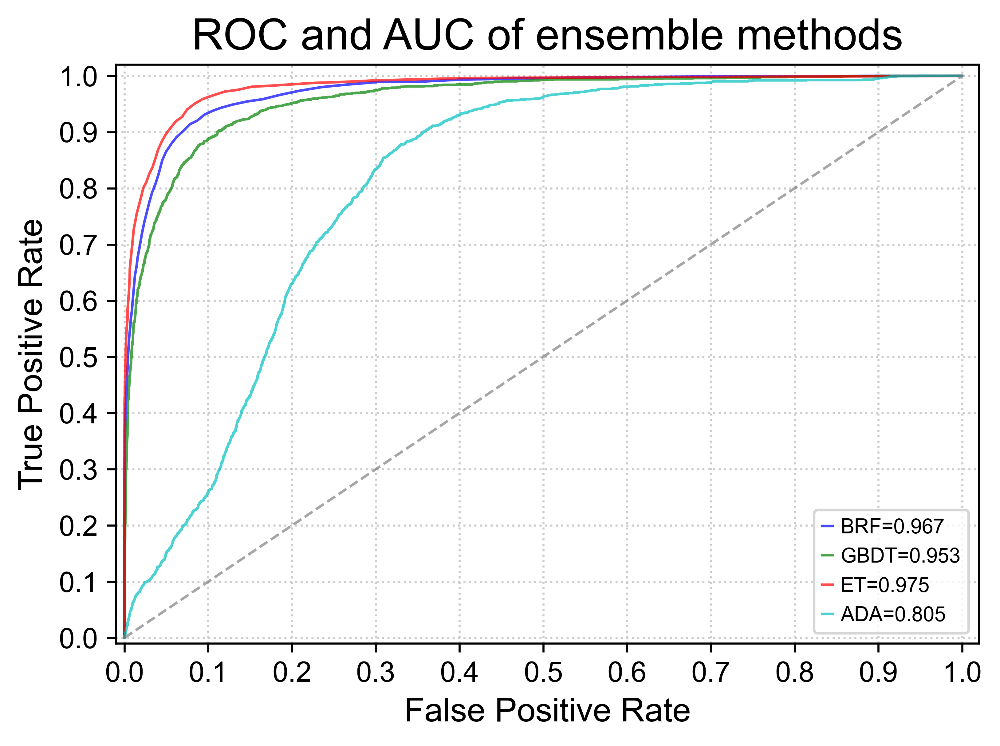

In [110]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import balanced_accuracy_score
from imblearn.combine import SMOTETomek
# baohan smote
test_base(F,num_class = 8, RANDOM_SEED=326)

Training Data Shape:  (2051, 149)
Testing Data Shape:  (879, 149)
BRF balance score is  0.4254293758014949
              precision    recall  f1-score   support

           0       0.47      0.31      0.37       235
           1       0.53      0.51      0.52       178
           2       0.27      0.51      0.35        45
           3       0.77      0.44      0.56       222
           4       0.51      0.54      0.52        80
           5       0.38      0.41      0.40        39
           6       0.10      0.37      0.16        27
           7       0.14      0.32      0.20        53

    accuracy                           0.42       879
   macro avg       0.40      0.43      0.38       879
weighted avg       0.52      0.42      0.45       879

GBDT balance score is  0.3569524793758792
              precision    recall  f1-score   support

           0       0.47      0.64      0.54       235
           1       0.47      0.44      0.45       178
           2       0.50      0.24    

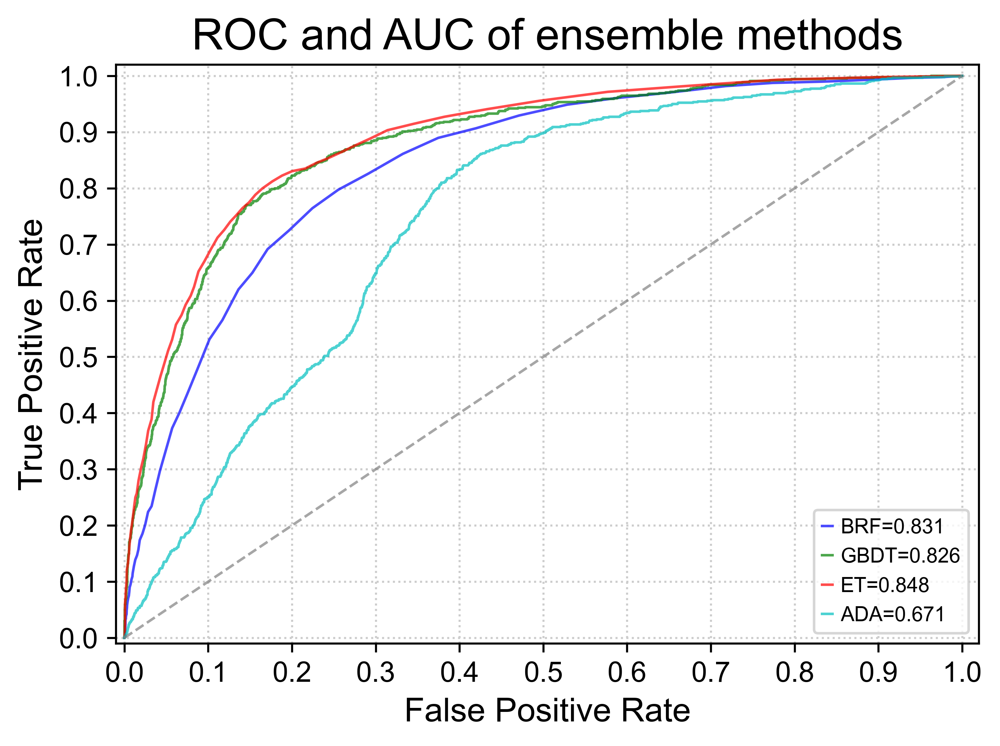

In [112]:
test_base(F,num_class = 8, RANDOM_SEED=326)

Raw target type ratio:


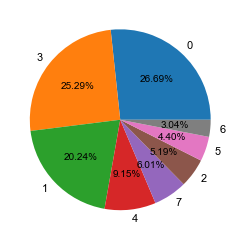

After imbalance processing type ratio:


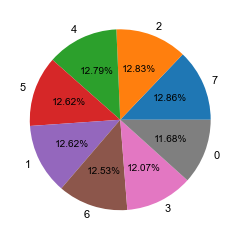

Training Data Shape:  (4088, 149)
Testing Data Shape:  (1752, 149)


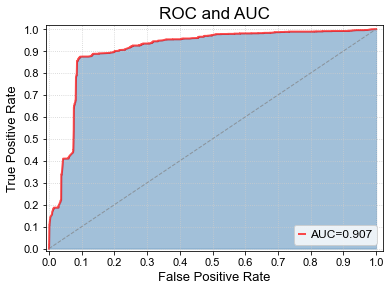

balanced_acc_score is  0.7795426983916011


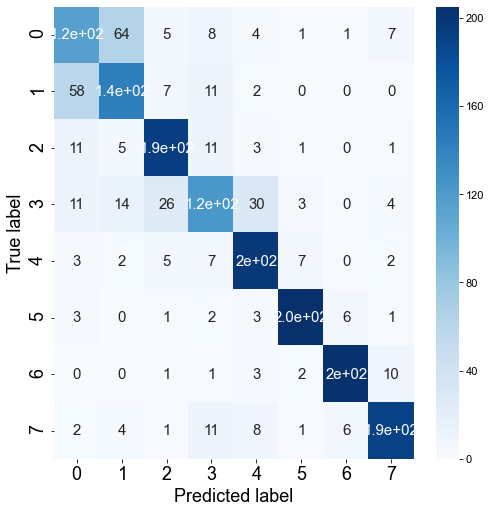

              precision    recall  f1-score   support

           0       0.57      0.56      0.56       205
           1       0.62      0.65      0.63       221
           2       0.81      0.86      0.83       225
           3       0.71      0.58      0.64       211
           4       0.79      0.88      0.83       224
           5       0.93      0.93      0.93       221
           6       0.94      0.92      0.93       220
           7       0.88      0.85      0.87       225

    accuracy                           0.78      1752
   macro avg       0.78      0.78      0.78      1752
weighted avg       0.78      0.78      0.78      1752



In [97]:
from imblearn.combine import SMOTETomek
from sklearn.model_selection import train_test_split
from package.util.func import *
from imblearn.ensemble import BalancedRandomForestClassifier
from mlxtend.classifier import StackingCVClassifier
import xgboost as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import balanced_accuracy_score
test_real, test_predict = stacking_model(F)
# plot_fi(feature_importances)
eval_result(test_real, test_predict, 8)

Raw target type ratio:


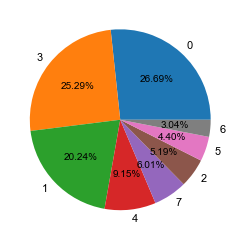

After imbalance processing type ratio:


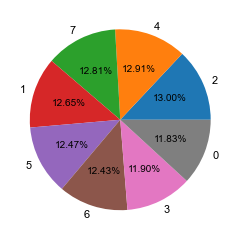

Training Data Shape:  (4071, 149)
Testing Data Shape:  (1745, 149)
=====================fold_0=====================
[0]	validation_0-mlogloss:2.02937	validation_1-mlogloss:2.04369
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49600	validation_1-mlogloss:0.95622
[200]	validation_0-mlogloss:0.22931	validation_1-mlogloss:0.75125
[300]	validation_0-mlogloss:0.13997	validation_1-mlogloss:0.67544
[400]	validation_0-mlogloss:0.09957	validation_1-mlogloss:0.63948
[500]	validation_0-mlogloss:0.07760	validation_1-mlogloss:0.61911
[600]	validation_0-mlogloss:0.06451	validation_1-mlogloss:0.60641
[700]	validation_0-mlogloss:0.05581	validation_1-mlogloss:0.60101
[800]	validation_0-mlogloss:0.04979	validation_1-mlogloss:0.59729
[900]	validation_0-mlogloss:0.04545	validation_1-mlogloss:0.59370
[1000]	validation_0-mlogloss:0.04228	validation_1-mlogloss

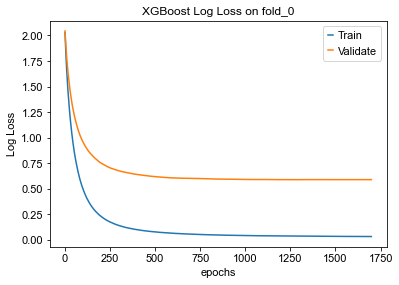

=====================fold_1=====================
[0]	validation_0-mlogloss:2.02792	validation_1-mlogloss:2.04043
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49457	validation_1-mlogloss:0.95874
[200]	validation_0-mlogloss:0.22765	validation_1-mlogloss:0.76058
[300]	validation_0-mlogloss:0.13829	validation_1-mlogloss:0.69019
[400]	validation_0-mlogloss:0.09826	validation_1-mlogloss:0.66046
[500]	validation_0-mlogloss:0.07686	validation_1-mlogloss:0.64197
[600]	validation_0-mlogloss:0.06390	validation_1-mlogloss:0.63127
[700]	validation_0-mlogloss:0.05528	validation_1-mlogloss:0.62488
[800]	validation_0-mlogloss:0.04932	validation_1-mlogloss:0.62072
[900]	validation_0-mlogloss:0.04499	validation_1-mlogloss:0.61778
[1000]	validation_0-mlogloss:0.04187	validation_1-mlogloss:0.61679
[1100]	validation_0-mlogloss:0.03948	validation_1-mlogloss

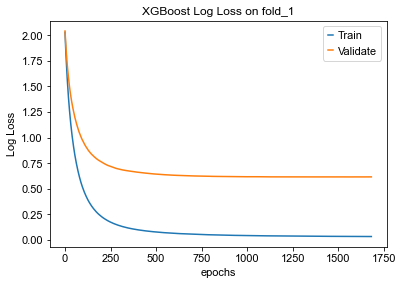

=====================fold_2=====================
[0]	validation_0-mlogloss:2.02851	validation_1-mlogloss:2.03948
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49610	validation_1-mlogloss:0.94400
[200]	validation_0-mlogloss:0.22980	validation_1-mlogloss:0.73947
[300]	validation_0-mlogloss:0.13995	validation_1-mlogloss:0.66210
[400]	validation_0-mlogloss:0.09968	validation_1-mlogloss:0.62273
[500]	validation_0-mlogloss:0.07788	validation_1-mlogloss:0.60266
[600]	validation_0-mlogloss:0.06471	validation_1-mlogloss:0.58892
[700]	validation_0-mlogloss:0.05601	validation_1-mlogloss:0.58171
[800]	validation_0-mlogloss:0.04998	validation_1-mlogloss:0.57545
[900]	validation_0-mlogloss:0.04547	validation_1-mlogloss:0.57065
[1000]	validation_0-mlogloss:0.04220	validation_1-mlogloss:0.56857
[1100]	validation_0-mlogloss:0.03973	validation_1-mlogloss

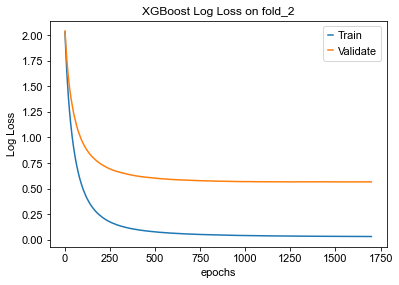

=====================fold_3=====================
[0]	validation_0-mlogloss:2.02779	validation_1-mlogloss:2.04078
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49263	validation_1-mlogloss:0.97928
[200]	validation_0-mlogloss:0.22721	validation_1-mlogloss:0.78644
[300]	validation_0-mlogloss:0.13803	validation_1-mlogloss:0.71303
[400]	validation_0-mlogloss:0.09800	validation_1-mlogloss:0.67825
[500]	validation_0-mlogloss:0.07666	validation_1-mlogloss:0.66000
[600]	validation_0-mlogloss:0.06376	validation_1-mlogloss:0.65072
[700]	validation_0-mlogloss:0.05515	validation_1-mlogloss:0.64503
[800]	validation_0-mlogloss:0.04918	validation_1-mlogloss:0.64214
[900]	validation_0-mlogloss:0.04488	validation_1-mlogloss:0.64076
[1000]	validation_0-mlogloss:0.04175	validation_1-mlogloss:0.63904
[1100]	validation_0-mlogloss:0.03944	validation_1-mlogloss

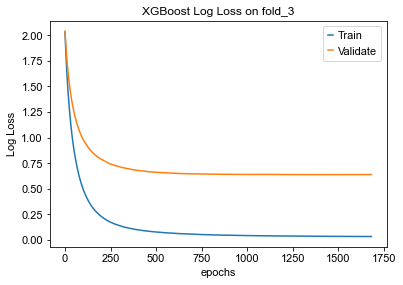

=====================fold_4=====================
[0]	validation_0-mlogloss:2.02922	validation_1-mlogloss:2.04286
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49923	validation_1-mlogloss:0.95125
[200]	validation_0-mlogloss:0.23211	validation_1-mlogloss:0.74599
[300]	validation_0-mlogloss:0.14087	validation_1-mlogloss:0.66722
[400]	validation_0-mlogloss:0.10038	validation_1-mlogloss:0.62940
[500]	validation_0-mlogloss:0.07824	validation_1-mlogloss:0.60896
[600]	validation_0-mlogloss:0.06506	validation_1-mlogloss:0.59813
[700]	validation_0-mlogloss:0.05633	validation_1-mlogloss:0.59158
[800]	validation_0-mlogloss:0.05016	validation_1-mlogloss:0.58750
[900]	validation_0-mlogloss:0.04578	validation_1-mlogloss:0.58448
[1000]	validation_0-mlogloss:0.04249	validation_1-mlogloss:0.58366
[1100]	validation_0-mlogloss:0.03998	validation_1-mlogloss

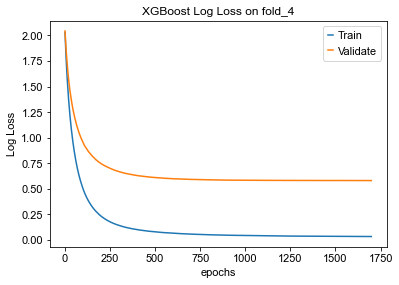

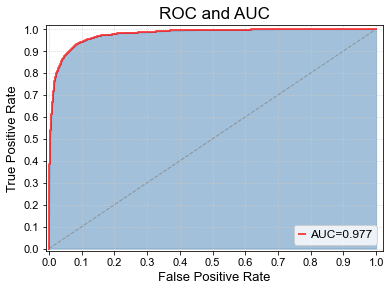

Xgboost balance score is  0.8119004509869043
<function model_XGBC at 0x7fb36b2e3a60> Running time: 1939.8849511146545 Seconds


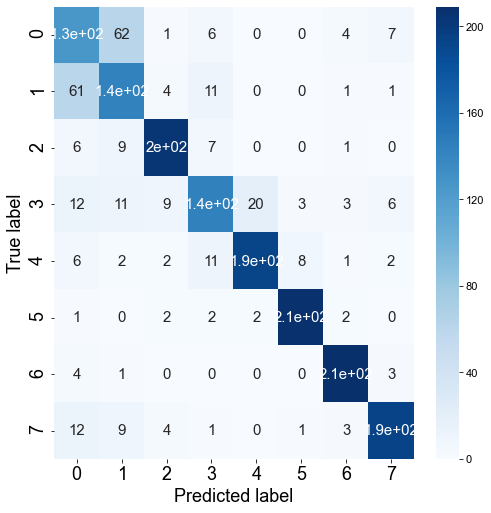

              precision    recall  f1-score   support

           0       0.55      0.61      0.58       206
           1       0.60      0.65      0.62       221
           2       0.90      0.90      0.90       227
           3       0.79      0.69      0.74       208
           4       0.90      0.86      0.88       225
           5       0.95      0.96      0.95       217
           6       0.93      0.96      0.95       217
           7       0.91      0.87      0.89       224

    accuracy                           0.81      1745
   macro avg       0.82      0.81      0.81      1745
weighted avg       0.82      0.81      0.82      1745



In [99]:
from package.model import velo_xgb
test_real, test_predict, feature_importances, valid = velo_xgb.model_XGBC(F, num_class = 8)
eval_result(test_real, test_predict, 8)

### pipeline

In [5]:
from package.preprocess import load_data
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, train_test_split

X = F
#= load_data.read_data(dataset="dentategyrus", use_gene_list=True)
labels = X['target']

# Remove the target
X = X.drop(columns=['ID','target'])
pl_random_forest = Pipeline(steps=[('random_forest', RandomForestClassifier())])

scores = cross_val_score(pl_random_forest, X, labels, cv=10,scoring='accuracy')
print('Accuracy for RandomForest : ', scores.mean())

<function read_data at 0x7f7fa3329b70> Running time: 1.0126359462738037 Seconds
Accuracy for RandomForest :  0.6641638225255974


In [7]:
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

pl_log_reg = Pipeline(steps=[('scaler',StandardScaler()),
 ('log_reg', LogisticRegression(multi_class='multinomial', solver='saga', max_iter=200))])
scores = cross_val_score(pl_log_reg, X, labels, cv=10,scoring='accuracy')
print('Accuracy for Logistic Regression: ', scores.mean())

Accuracy for Logistic Regression:  0.615358361774744


In [9]:
from sklearn.decomposition import PCA
scaler = StandardScaler()
scaled_df = scaler.fit_transform(X)
pca = PCA(n_components = 20)
pca_vectors = pca.fit_transform(scaled_df)
for index, var in enumerate(pca.explained_variance_ratio_):
    print("Explained Variance ratio by Principal Component ", (index+1), " : ", var)

Explained Variance ratio by Principal Component  1  :  0.08298991278930716
Explained Variance ratio by Principal Component  2  :  0.06792928449595327
Explained Variance ratio by Principal Component  3  :  0.04555661955884114
Explained Variance ratio by Principal Component  4  :  0.023825219215054996
Explained Variance ratio by Principal Component  5  :  0.023415548247688562
Explained Variance ratio by Principal Component  6  :  0.021575004029988656
Explained Variance ratio by Principal Component  7  :  0.019531295786154697
Explained Variance ratio by Principal Component  8  :  0.01907989840548979
Explained Variance ratio by Principal Component  9  :  0.017878762562298776
Explained Variance ratio by Principal Component  10  :  0.01734745332271118
Explained Variance ratio by Principal Component  11  :  0.01721378613772262
Explained Variance ratio by Principal Component  12  :  0.017067600940986288
Explained Variance ratio by Principal Component  13  :  0.016932066022035532
Explained Vari

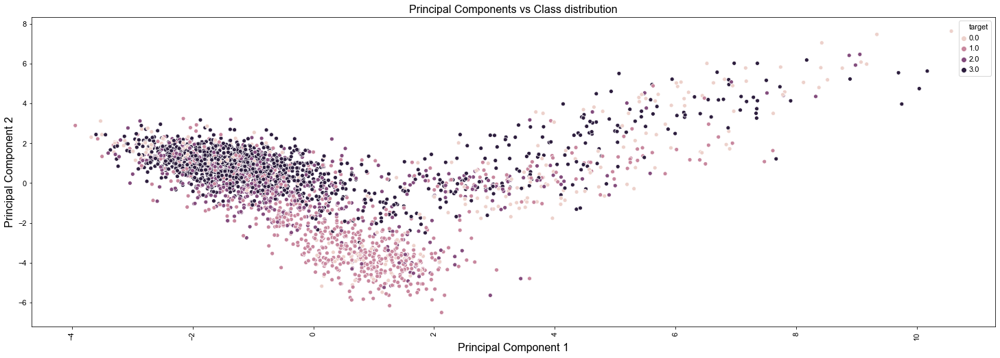

In [10]:
plt.figure(figsize=(25,8))
sns.scatterplot(x=pca_vectors[:, 0], y=pca_vectors[:, 1], hue=labels)
plt.title('Principal Components vs Class distribution', fontsize=16)
plt.ylabel('Principal Component 2', fontsize=16)
plt.xlabel('Principal Component 1', fontsize=16)
plt.xticks(rotation='vertical');

In [11]:
pl_log_reg_pca = Pipeline(steps=[('scaler',StandardScaler()),
 ('pca', PCA(n_components = 2)),
 ('log_reg', LogisticRegression(multi_class='multinomial', solver='saga', max_iter=200))])
scores = cross_val_score(pl_log_reg_pca, X, labels, cv=10,scoring='accuracy')
print('Accuracy for Logistic Regression with 2 Principal Components: ', scores.mean())

Accuracy for Logistic Regression with 2 Principal Components:  0.5757679180887373


In [12]:
pl_log_reg_pca = Pipeline(steps=[('scaler',StandardScaler()),
 ('pca', PCA(n_components = 10)),
 ('log_reg', LogisticRegression(multi_class='multinomial', solver='saga', max_iter=200))])
scores = cross_val_score(pl_log_reg_pca, X, labels, cv=10,scoring='accuracy')
print('Accuracy for Logistic Regression with 2 Principal Components: ', scores.mean())

Accuracy for Logistic Regression with 2 Principal Components:  0.5979522184300341


In [13]:
pl_log_reg_pca = Pipeline(steps=[('scaler',StandardScaler()),
 ('pca', PCA(n_components = 20)),
 ('log_reg', LogisticRegression(multi_class='multinomial', solver='saga', max_iter=200))])
scores = cross_val_score(pl_log_reg_pca, X, labels, cv=10,scoring='accuracy')
print('Accuracy for Logistic Regression with 2 Principal Components: ', scores.mean())

Accuracy for Logistic Regression with 2 Principal Components:  0.5996587030716723


In [15]:
from sklearn.neural_network import MLPClassifier
pl_mlp = Pipeline(steps=[('scaler',StandardScaler()),
 ('mlp_ann', MLPClassifier(hidden_layer_sizes=(32, 16)))])
scores = cross_val_score(pl_mlp, X, labels, cv=10,scoring='accuracy')
print('Accuracy for ANN : ', scores.mean())

Accuracy for ANN :  0.5600682593856655


In [16]:
from sklearn.svm import LinearSVC
pl_svm = Pipeline(steps=[('scaler',StandardScaler()),
 ('pl_svm', LinearSVC())])
scores = cross_val_score(pl_svm, X, labels, cv=10,scoring='accuracy')
print('Accuracy for Linear SVM : ', scores.mean())

Accuracy for Linear SVM :  0.6197952218430034


In [18]:
import xgboost as xgb
pl_xgb = Pipeline(steps=
 [('xgboost', xgb.XGBClassifier(objective='multi:softmax'))])
scores = cross_val_score(pl_xgb, X, labels, cv=10)
print('Accuracy for XGBoost Classifier : ', scores.mean())

Accuracy for XGBoost Classifier :  0.6648464163822526


# Test version

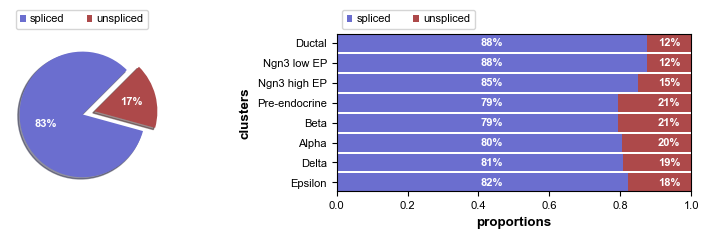

Filtered out 21611 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


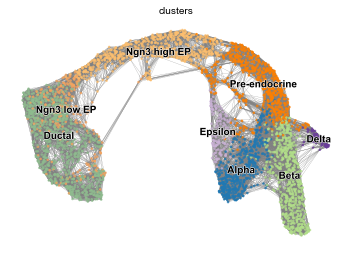

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


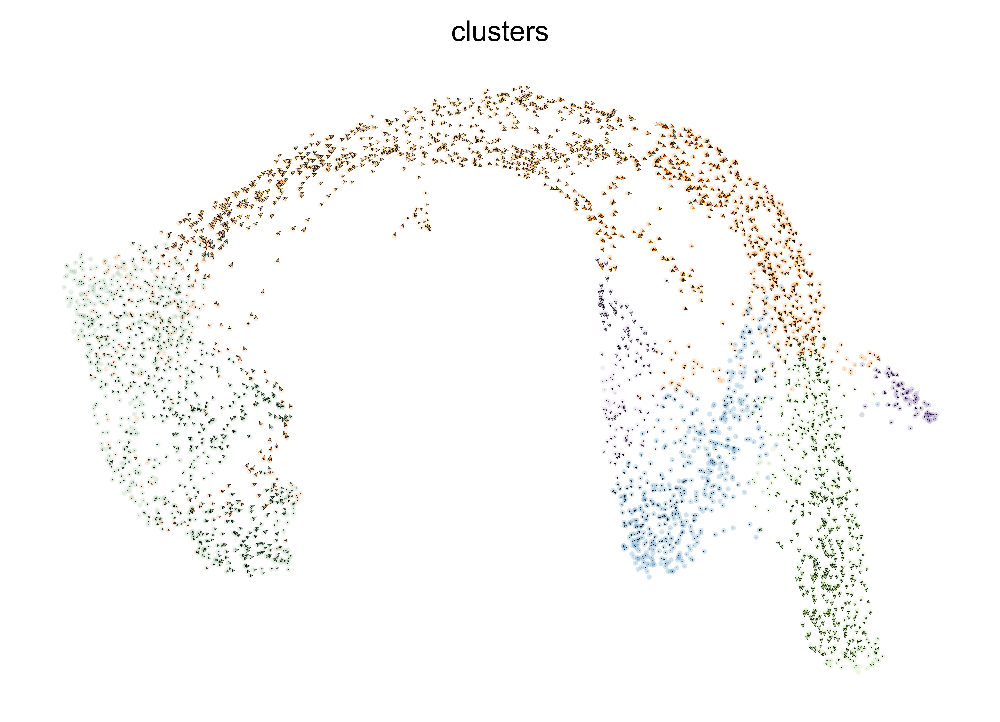

ranking velocity genes
    finished (0:00:02) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function gain_data at 0x7fb3af500268> Running time: 51.32171583175659 Seconds


In [3]:
from package.preprocess import load_data
adata = load_data.gain_data(dataset="pancreas",mode='stochastic', top_k=5)

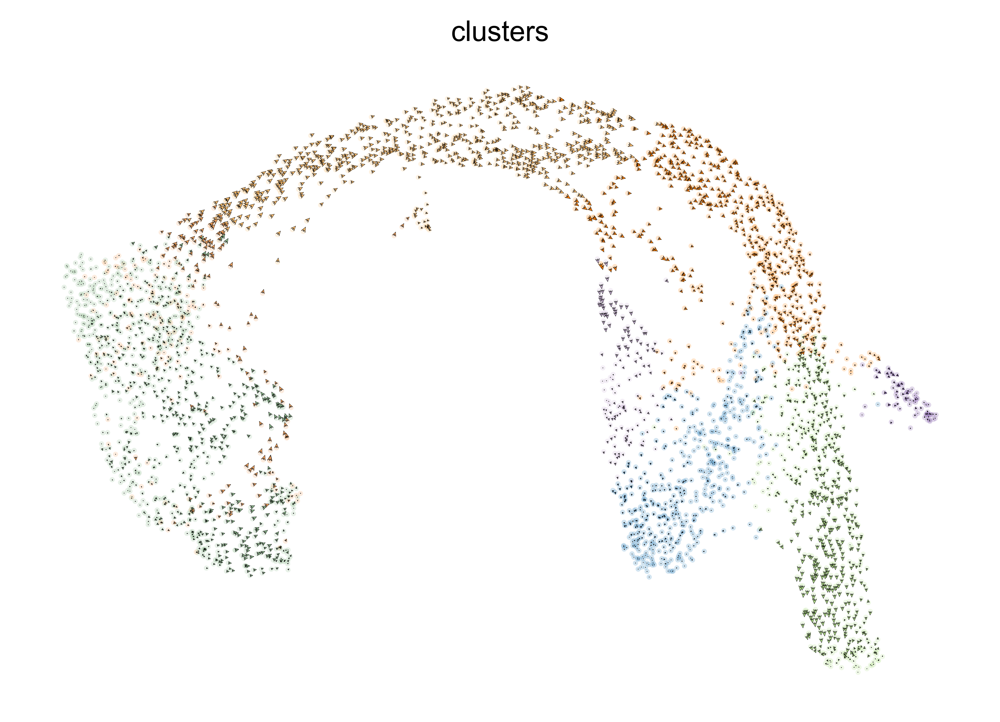

In [11]:
import scvelo as scv
scv.pl.velocity_embedding(adata, basis='umap', arrow_length=1.5, arrow_size=1.5, dpi=1000)

In [4]:
X = load_data.read_data(dataset="pancreas", use_gene_list=True)
X

<function read_data at 0x7fb3b56c1ea0> Running time: 0.9683218002319336 Seconds


,ID,Zcchc16,Tmem108,Pclo,Hspa8,Gnas,Abcc8,Nnat,Akr1c19,Ptprt,...,Ksr2,Sox5,Spock3,Ptprs,Ptpn3,Ttyh2,Gm8113,Nlgn1,Prune2,target
0,0,0.0,0.000000,0.000000,1.558336,3.548415,0.811065,0.000000,1.252936,0.0,...,0.811065,0.000000,0.0,0.0,0.000000,1.558336,0.0,0.0,0.000000,1.0
1,1,0.0,0.000000,0.000000,1.833514,1.833514,0.000000,0.000000,1.012308,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,3.0
2,2,0.0,0.000000,0.000000,2.315620,3.625002,0.000000,1.716605,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.925000,2.0
3,3,0.0,0.000000,0.000000,1.548341,2.129103,0.000000,0.000000,0.554306,0.0,...,0.000000,0.554306,0.0,0.0,0.554306,0.000000,0.0,0.0,0.000000,1.0
4,4,0.0,0.000000,0.803073,2.264545,3.420261,0.000000,1.242650,1.242650,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3691,3691,0.0,0.000000,0.513945,2.572133,3.543670,0.513945,0.513945,1.615666,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.513945,0.0,0.0,0.000000,1.0
3692,3692,0.0,0.000000,0.000000,2.979195,2.840585,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0
3693,3693,0.0,0.000000,0.000000,2.228283,1.213972,0.000000,0.000000,0.780891,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,3.0
3694,3694,0.0,0.000000,0.000000,1.951187,4.611263,0.791819,0.472316,1.033580,0.0,...,0.000000,0.000000,0.0,0.0,0.472316,0.000000,0.0,0.0,0.472316,2.0


(2930, 65)


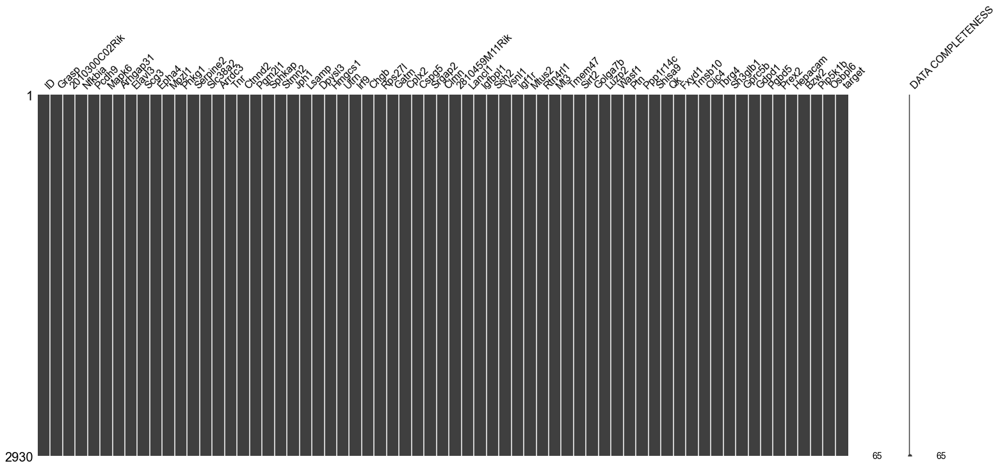

In [11]:
# 异常点监测
import missingno as msno
print(X.shape)
msno.matrix(X,labels=True)# 查看缺失值情况
# msno.bar(X) # 条形图
# msno.heatmap(X) #列相关性
# msno.dendrogram(X) #树形图使用层次聚类算法通过它们的无效性相关性（根据二进制距离测量）将变量彼此相加。在树的每个步骤，基于哪个组合最小化剩余簇的距离来分割变量。变量集越单调，它们的总距离越接近零，并且它们的平均距离（y轴）越接近零。


## XGBC

Raw target type ratio:


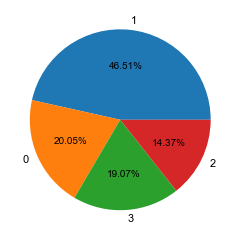

After imbalance processing type ratio:


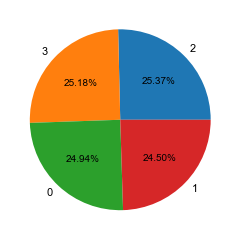

Training Data Shape:  (4422, 38)
Testing Data Shape:  (1896, 38)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.36033	validation_1-mlogloss:1.36683
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.47250	validation_1-mlogloss:0.78506
[200]	validation_0-mlogloss:0.28457	validation_1-mlogloss:0.72286
[300]	validation_0-mlogloss:0.20019	validation_1-mlogloss:0.71173
[400]	validation_0-mlogloss:0.15447	validation_1-mlogloss:0.70719
[500]	validation_0-mlogloss:0.12649	validation_1-mlogloss:0.70790
[600]	validation_0-mlogloss:0.10782	validation_1-mlogloss:0.71256
[700]	validation_0-mlogloss:0.09439	validation_1-mlogloss:0.71841
Stopping. Best iteration:
[425]	validation_0-mlogloss:0.14642	validation_1-mlogloss:0.70627



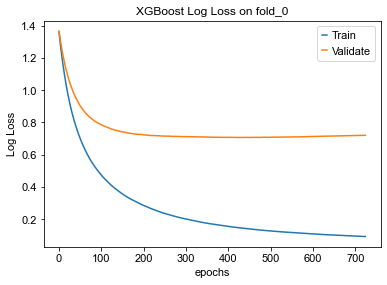

=====================fold_1=====================
[0]	validation_0-mlogloss:1.36063	validation_1-mlogloss:1.36694
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.47949	validation_1-mlogloss:0.75367
[200]	validation_0-mlogloss:0.29050	validation_1-mlogloss:0.67139
[300]	validation_0-mlogloss:0.20445	validation_1-mlogloss:0.64687
[400]	validation_0-mlogloss:0.15739	validation_1-mlogloss:0.63714
[500]	validation_0-mlogloss:0.12851	validation_1-mlogloss:0.63278
[600]	validation_0-mlogloss:0.10962	validation_1-mlogloss:0.63259
[700]	validation_0-mlogloss:0.09615	validation_1-mlogloss:0.63393
[800]	validation_0-mlogloss:0.08616	validation_1-mlogloss:0.63608
Stopping. Best iteration:
[558]	validation_0-mlogloss:0.11671	validation_1-mlogloss:0.63150



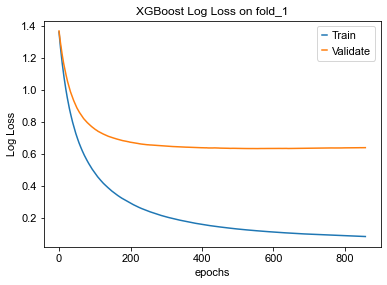

=====================fold_2=====================
[0]	validation_0-mlogloss:1.36138	validation_1-mlogloss:1.36760
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.47859	validation_1-mlogloss:0.74081
[200]	validation_0-mlogloss:0.28750	validation_1-mlogloss:0.66804
[300]	validation_0-mlogloss:0.20356	validation_1-mlogloss:0.64966
[400]	validation_0-mlogloss:0.15710	validation_1-mlogloss:0.64313
[500]	validation_0-mlogloss:0.12837	validation_1-mlogloss:0.64133
[600]	validation_0-mlogloss:0.10931	validation_1-mlogloss:0.64144
[700]	validation_0-mlogloss:0.09601	validation_1-mlogloss:0.64276
Stopping. Best iteration:
[456]	validation_0-mlogloss:0.13917	validation_1-mlogloss:0.63967



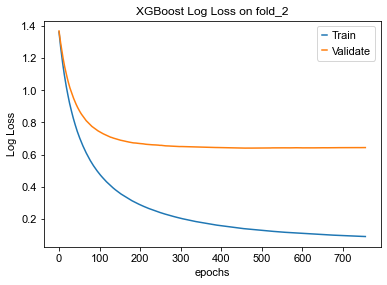

=====================fold_3=====================
[0]	validation_0-mlogloss:1.36052	validation_1-mlogloss:1.36573
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.48401	validation_1-mlogloss:0.72867
[200]	validation_0-mlogloss:0.29229	validation_1-mlogloss:0.64489
[300]	validation_0-mlogloss:0.20746	validation_1-mlogloss:0.61843
[400]	validation_0-mlogloss:0.15972	validation_1-mlogloss:0.60614
[500]	validation_0-mlogloss:0.13066	validation_1-mlogloss:0.60132
[600]	validation_0-mlogloss:0.11109	validation_1-mlogloss:0.59728
[700]	validation_0-mlogloss:0.09757	validation_1-mlogloss:0.59665
[800]	validation_0-mlogloss:0.08747	validation_1-mlogloss:0.59576
[900]	validation_0-mlogloss:0.07960	validation_1-mlogloss:0.59713
[1000]	validation_0-mlogloss:0.07342	validation_1-mlogloss:0.59752
Stopping. Best iteration:
[760]	validation_0-mlogloss:0.09

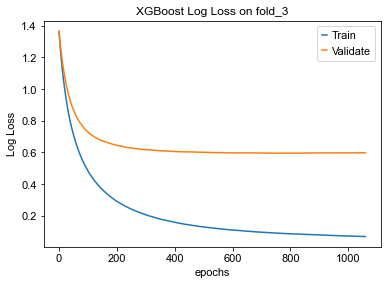

=====================fold_4=====================
[0]	validation_0-mlogloss:1.36036	validation_1-mlogloss:1.36661
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.47591	validation_1-mlogloss:0.76561
[200]	validation_0-mlogloss:0.28552	validation_1-mlogloss:0.70055
[300]	validation_0-mlogloss:0.20125	validation_1-mlogloss:0.68170
[400]	validation_0-mlogloss:0.15546	validation_1-mlogloss:0.67860
[500]	validation_0-mlogloss:0.12681	validation_1-mlogloss:0.68153
[600]	validation_0-mlogloss:0.10820	validation_1-mlogloss:0.68466
Stopping. Best iteration:
[355]	validation_0-mlogloss:0.17309	validation_1-mlogloss:0.67848



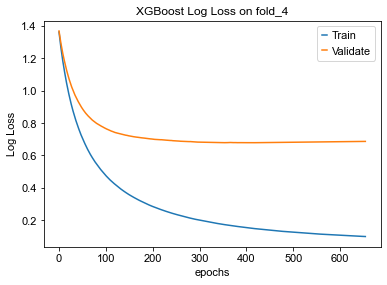

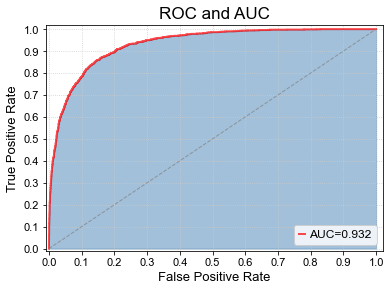

Xgboost balance score is  0.7454746651861968
<function model_XGBC at 0x7fc9595181e0> Running time: 217.5437400341034 Seconds


In [5]:
from package.model import velo_xgb
test_real, test_predict, feature_importances, valid = velo_xgb.model_XGBC(X, num_class = 4)

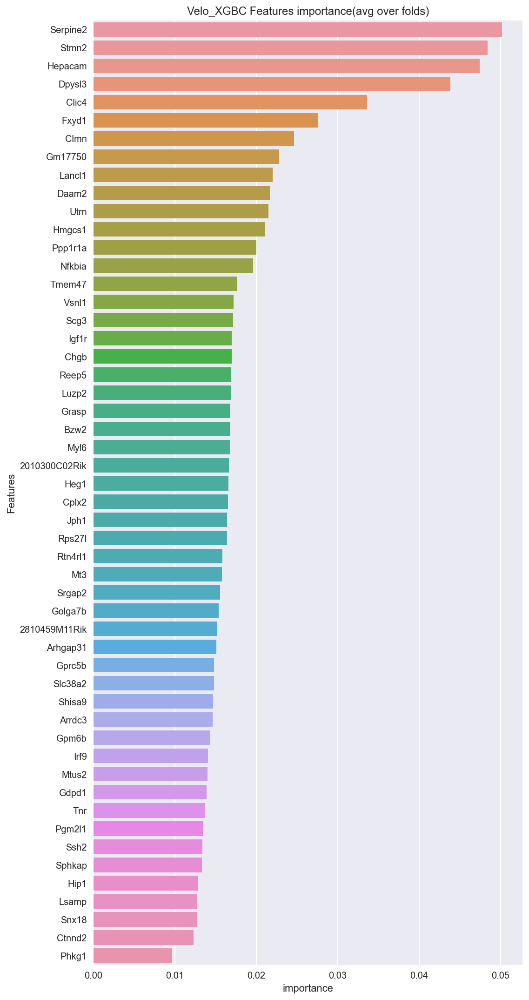

In [439]:
from package.util.func import plot_fi
plot_fi(feature_importances)

In [6]:
eval_result(test_real, test_predict)

NameError: name 'eval_result' is not defined

# Sampling model

Running scvelo 0.2.2 (python 3.7.3) on 2020-08-26 16:21.
<function read_data at 0x7fcc57a6bae8> Running time: 0.7642910480499268 Seconds
Raw target type ratio:


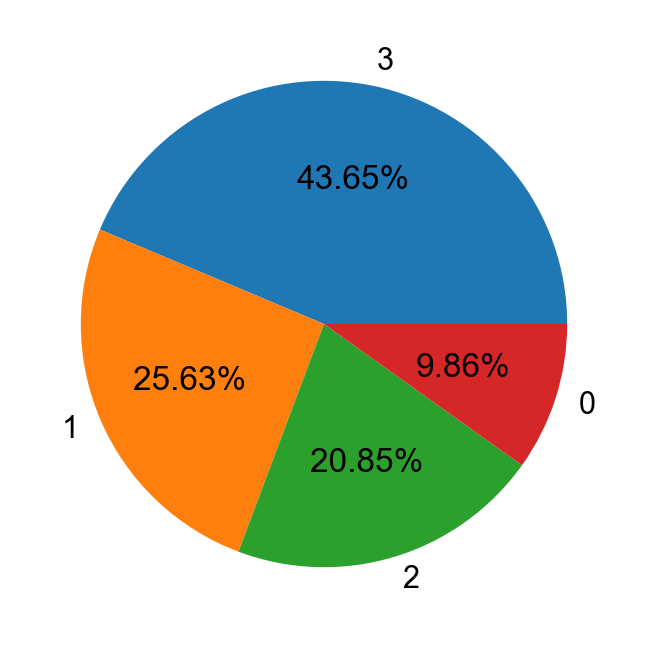

 balance score is  0.5246850464794925
              precision    recall  f1-score   support

           0       0.65      0.20      0.30        87
           1       0.68      0.66      0.67       225
           2       0.57      0.35      0.43       183
           3       0.66      0.90      0.76       384

    accuracy                           0.65       879
   macro avg       0.64      0.52      0.54       879
weighted avg       0.65      0.65      0.62       879



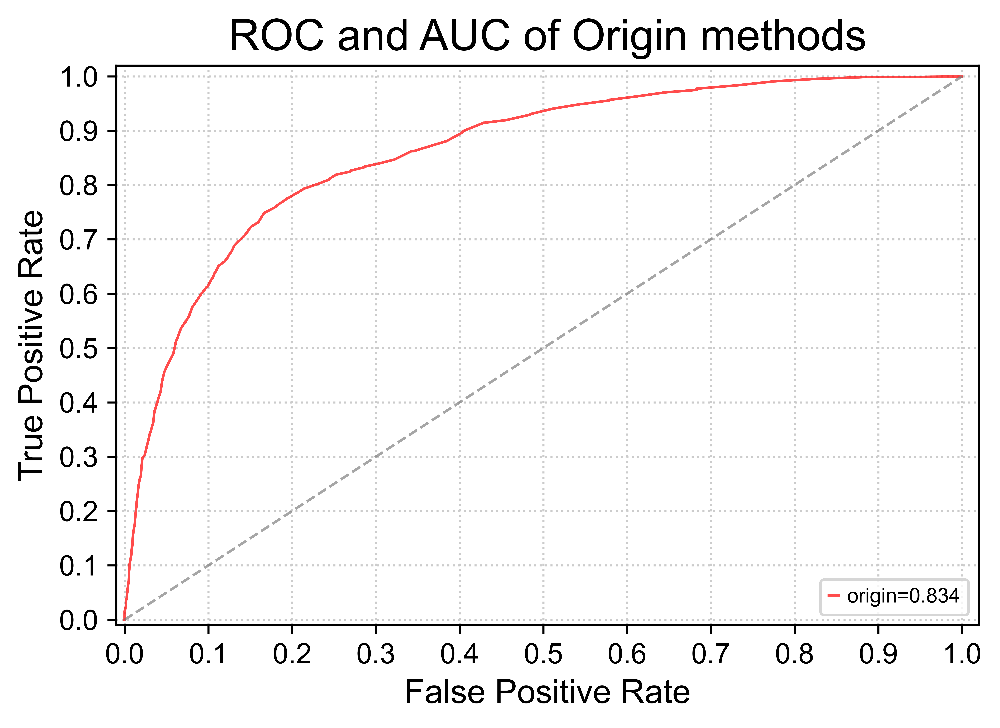

In [1]:
from package.test.sampling_test import *
from package.model.RandomForest import model_RF
from package.preprocess.load_data import read_data
from package.model.stacking import stacking_model
from package.util.func import *
from package.model import velo_xgb
X = read_data(dataset="dentategyrus", num_class=4, use_gene_list=True)
origin(X)
#test_oversample(X)
#test_undersample()
#test_combine(X)
# test_real, test_predict = model_RF(X)
# test_real, test_predict, feature_importances, valid = velo_xgb.model_XGBC(X, num_class = 4)
# test_real, test_predict = stacking_model(X, num_class=4)
# plot_fi(feature_importances)
# eval_result(test_real, test_predict, 4)

Running scvelo 0.2.2 (python 3.7.3) on 2020-08-22 15:23.
<function read_data at 0x7fc3f5aa2840> Running time: 0.7814548015594482 Seconds
Raw target type ratio:


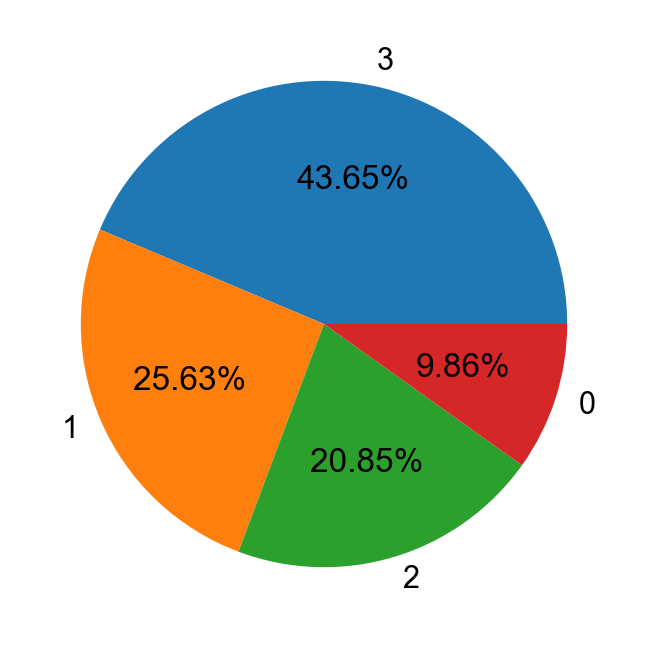

After imbalance processing type ratio:


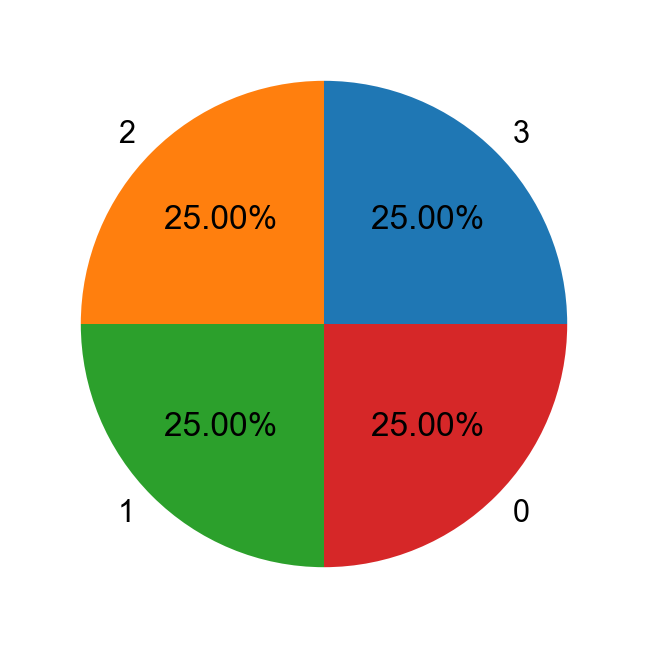

Training Data Shape:  (3581, 52)
Testing Data Shape:  (1535, 52)


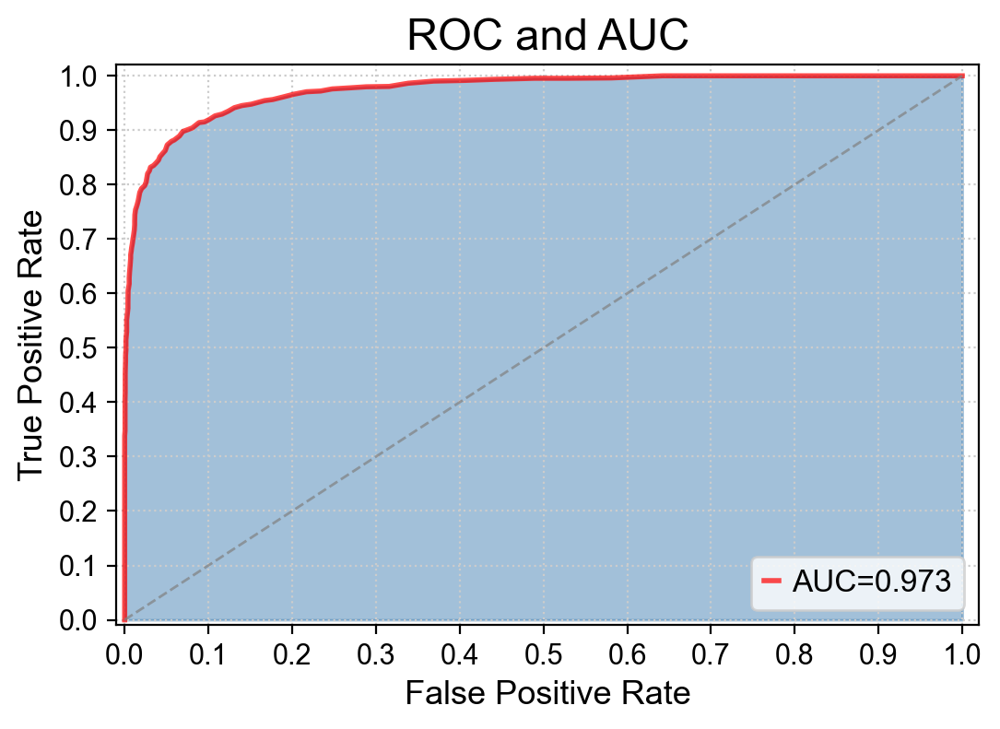

0.8553191634029591


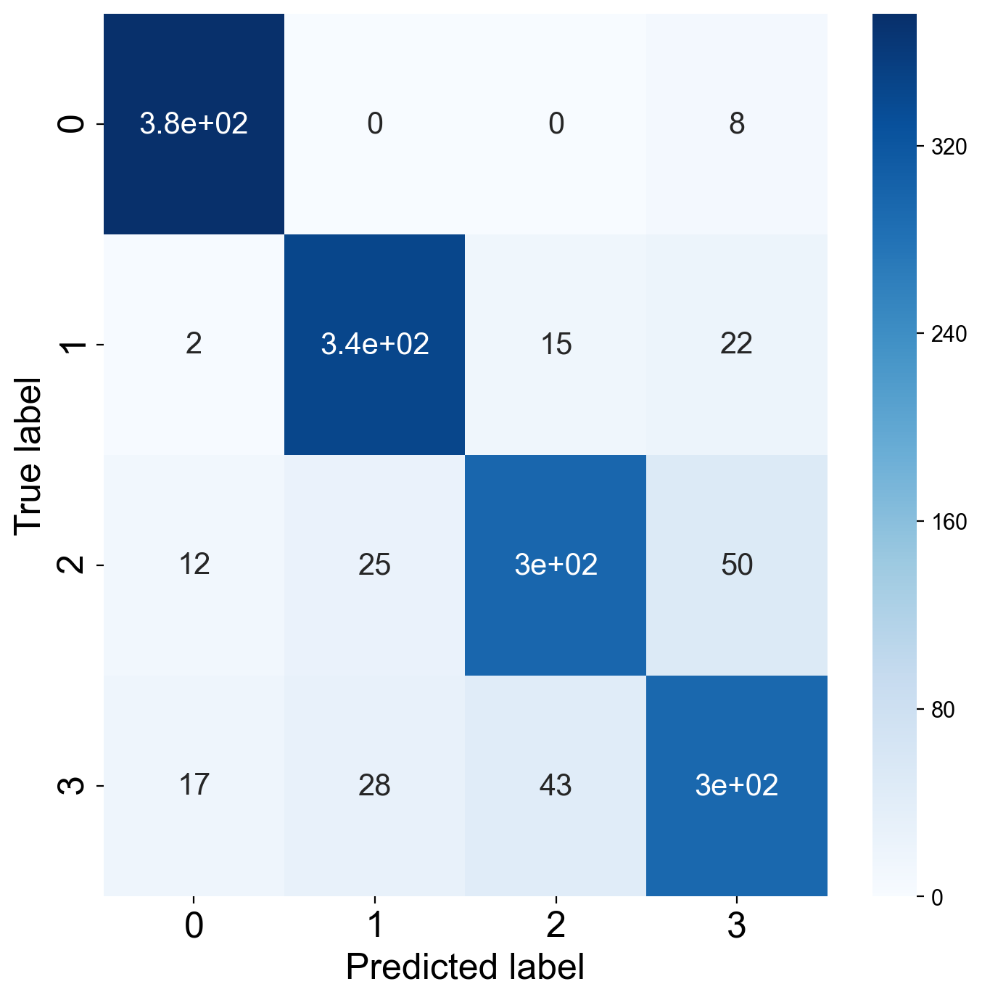

              precision    recall  f1-score   support

           0       0.92      0.98      0.95       384
           1       0.87      0.90      0.88       384
           2       0.84      0.77      0.80       384
           3       0.79      0.77      0.78       383

    accuracy                           0.86      1535
   macro avg       0.85      0.86      0.85      1535
weighted avg       0.85      0.86      0.85      1535



In [1]:
from package.model.LR import model_LR
from package.util.func import *
from package.preprocess.load_data import read_data
X = read_data(dataset="dentategyrus", num_class=4, use_gene_list=True)
test_real, test_predict = model_LR(X,num_class=4,over_sampling=True)
eval_result(test_real,test_predict,4)

In [6]:
import scvelo as scv
scv.datasets.pancreas()

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score'
    var: 'highly_variable_genes'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'distances', 'connectivities'

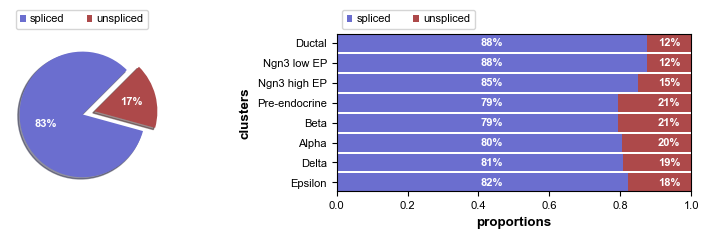

Filtered out 21611 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


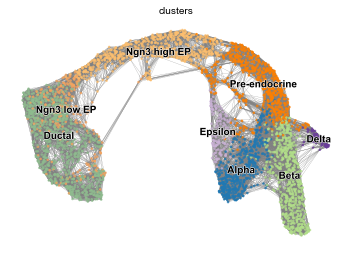

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


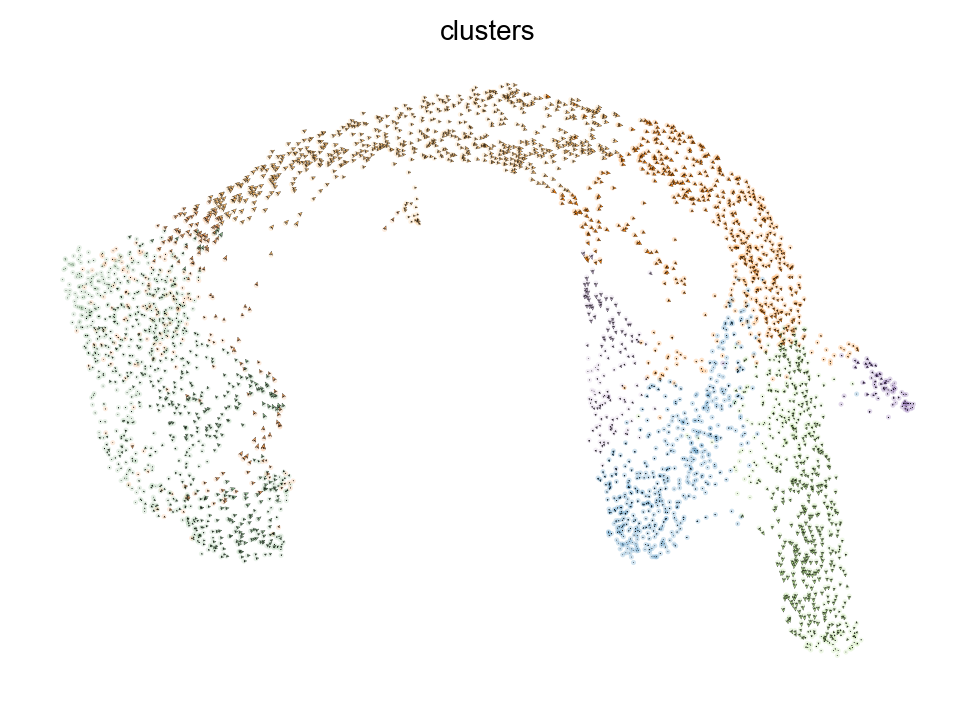

ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function gain_data at 0x7fae37751620> Running time: 43.8604302406311 Seconds


In [16]:
from package.preprocess.load_data import gain_data
adata = gain_data(dataset="pancreas",mode='stochastic', top_k=3)

In [17]:
X = read_data(dataset="pancreas", num_class=4, use_gene_list=True)
X

<function read_data at 0x7fae3d027510> Running time: 0.9482519626617432 Seconds


,ID,Tmcc3,Notch2,Sdk1,Pax6,Krt19,Ica1,Spock3,Ptpn3,Unc5c,...,Akr1c19,Baiap3,Pam,Pde1c,Zcchc16,Nnat,Heg1,Nlgn1,Hacd1,target
0,0,0.000000,0.000000,0.811065,0.811065,1.252936,0.000000,0.0,0.000000,0.0,...,1.252936,0.811065,0.811065,0.0,0.0,0.000000,0.0,0.0,0.000000,1.0
1,1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,1.012308,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,3.0
2,2,1.397169,0.000000,0.000000,1.716605,0.000000,0.925000,0.0,0.000000,0.0,...,0.000000,0.925000,1.958328,0.0,0.0,1.716605,0.0,0.0,0.000000,2.0
3,3,0.000000,0.554306,0.000000,0.000000,0.554306,0.000000,0.0,0.554306,0.0,...,0.554306,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,1.0
4,4,0.000000,0.000000,0.000000,0.000000,0.000000,0.803073,0.0,0.000000,0.0,...,1.242650,0.000000,0.000000,0.0,0.0,1.242650,0.0,0.0,0.000000,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3691,3691,0.513945,0.000000,0.000000,1.615666,0.000000,0.513945,0.0,0.000000,0.0,...,1.615666,1.103805,0.851751,0.0,0.0,0.513945,0.0,0.0,0.513945,1.0
3692,3692,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0
3693,3693,0.000000,0.000000,0.000000,0.000000,2.091925,0.000000,0.0,0.000000,0.0,...,0.780891,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.780891,3.0
3694,3694,0.000000,0.000000,0.000000,0.472316,0.000000,0.000000,0.0,0.472316,0.0,...,1.033580,0.000000,2.109539,0.0,0.0,0.472316,0.0,0.0,0.472316,2.0


Running scvelo 0.2.2 (python 3.7.3) on 2020-08-27 10:53.
<function read_data at 0x7f7fa3329b70> Running time: 0.7789633274078369 Seconds
Raw target type ratio:


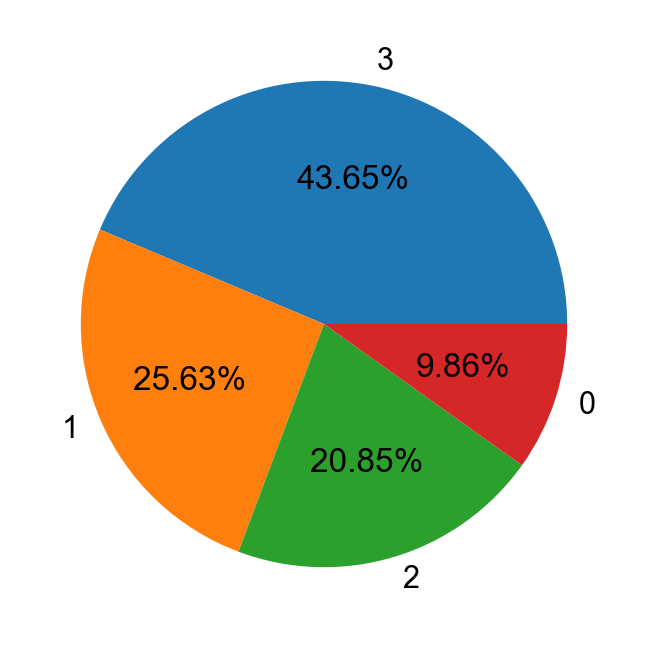

After imbalance processing type ratio:


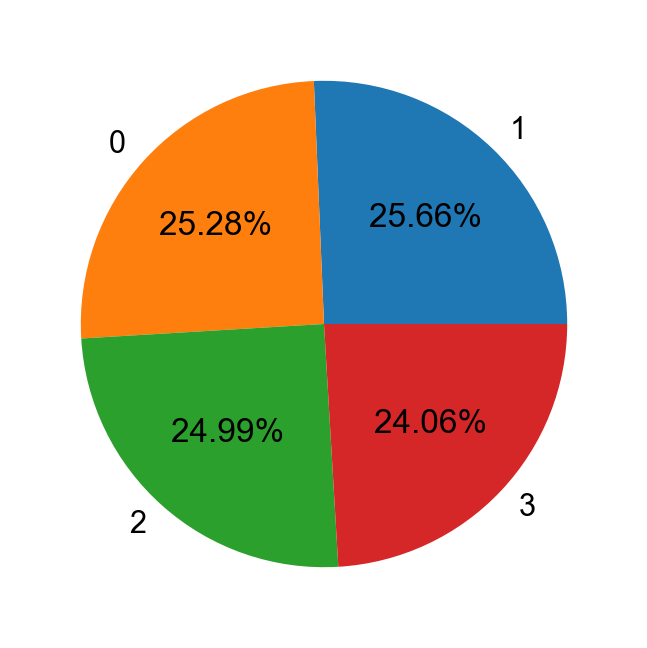

Training Data Shape:  (3316, 63)
Testing Data Shape:  (1422, 63)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.36003	validation_1-mlogloss:1.36736
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.44887	validation_1-mlogloss:0.75248
[200]	validation_0-mlogloss:0.25106	validation_1-mlogloss:0.66012
[300]	validation_0-mlogloss:0.17161	validation_1-mlogloss:0.63096
[400]	validation_0-mlogloss:0.13014	validation_1-mlogloss:0.61841
[500]	validation_0-mlogloss:0.10509	validation_1-mlogloss:0.61354
[600]	validation_0-mlogloss:0.08876	validation_1-mlogloss:0.61126
[700]	validation_0-mlogloss:0.07721	validation_1-mlogloss:0.61139
[800]	validation_0-mlogloss:0.06887	validation_1-mlogloss:0.61299
[900]	validation_0-mlogloss:0.06258	validation_1-mlogloss:0.61473
Stopping. Best iteration:
[624]	validation_0-mlogloss:0.0855

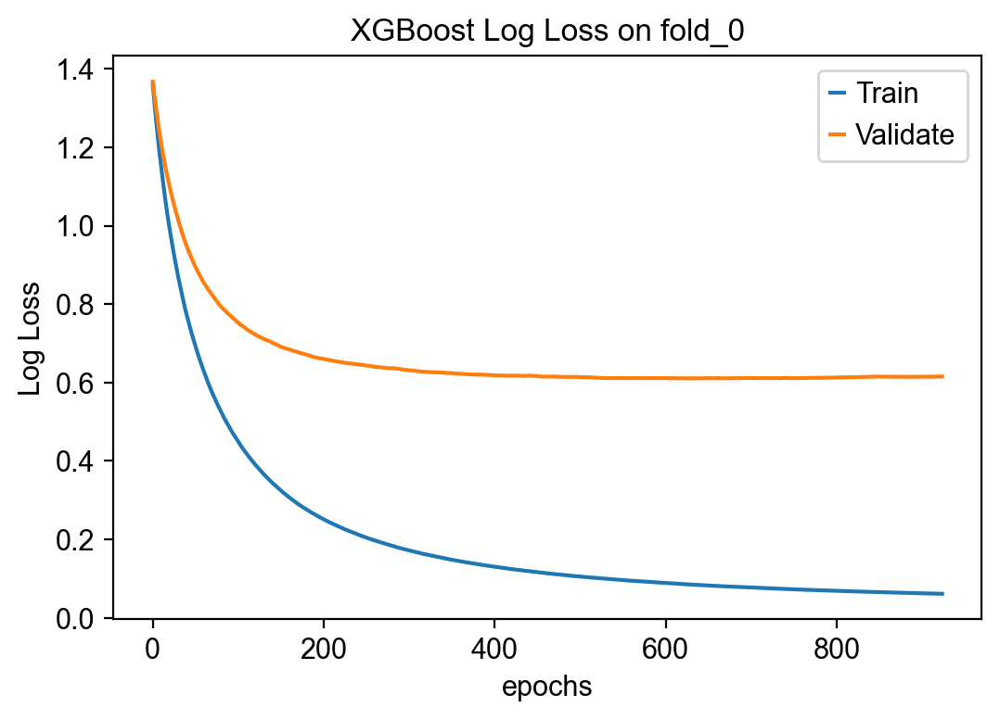

=====================fold_1=====================
[0]	validation_0-mlogloss:1.36080	validation_1-mlogloss:1.36839
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.44510	validation_1-mlogloss:0.74485
[200]	validation_0-mlogloss:0.25094	validation_1-mlogloss:0.64996
[300]	validation_0-mlogloss:0.17036	validation_1-mlogloss:0.61571
[400]	validation_0-mlogloss:0.12892	validation_1-mlogloss:0.59982
[500]	validation_0-mlogloss:0.10436	validation_1-mlogloss:0.59276
[600]	validation_0-mlogloss:0.08829	validation_1-mlogloss:0.59028
[700]	validation_0-mlogloss:0.07702	validation_1-mlogloss:0.58805
[800]	validation_0-mlogloss:0.06872	validation_1-mlogloss:0.58663
[900]	validation_0-mlogloss:0.06241	validation_1-mlogloss:0.58537
[1000]	validation_0-mlogloss:0.05737	validation_1-mlogloss:0.58464
[1100]	validation_0-mlogloss:0.05334	validation_1-mlogloss

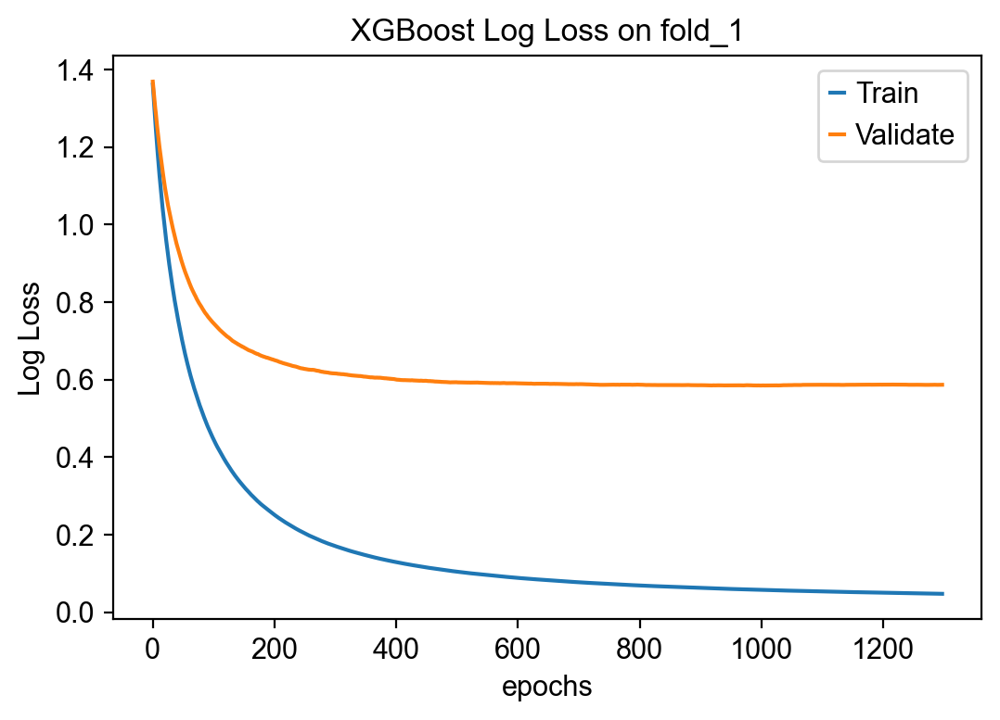

=====================fold_2=====================
[0]	validation_0-mlogloss:1.36066	validation_1-mlogloss:1.36916
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.44504	validation_1-mlogloss:0.76358
[200]	validation_0-mlogloss:0.25099	validation_1-mlogloss:0.66252
[300]	validation_0-mlogloss:0.17090	validation_1-mlogloss:0.62360
[400]	validation_0-mlogloss:0.12924	validation_1-mlogloss:0.60788
[500]	validation_0-mlogloss:0.10449	validation_1-mlogloss:0.59912
[600]	validation_0-mlogloss:0.08794	validation_1-mlogloss:0.59402
[700]	validation_0-mlogloss:0.07690	validation_1-mlogloss:0.59324
[800]	validation_0-mlogloss:0.06861	validation_1-mlogloss:0.59288
[900]	validation_0-mlogloss:0.06216	validation_1-mlogloss:0.59175
[1000]	validation_0-mlogloss:0.05712	validation_1-mlogloss:0.59335
[1100]	validation_0-mlogloss:0.05315	validation_1-mlogloss

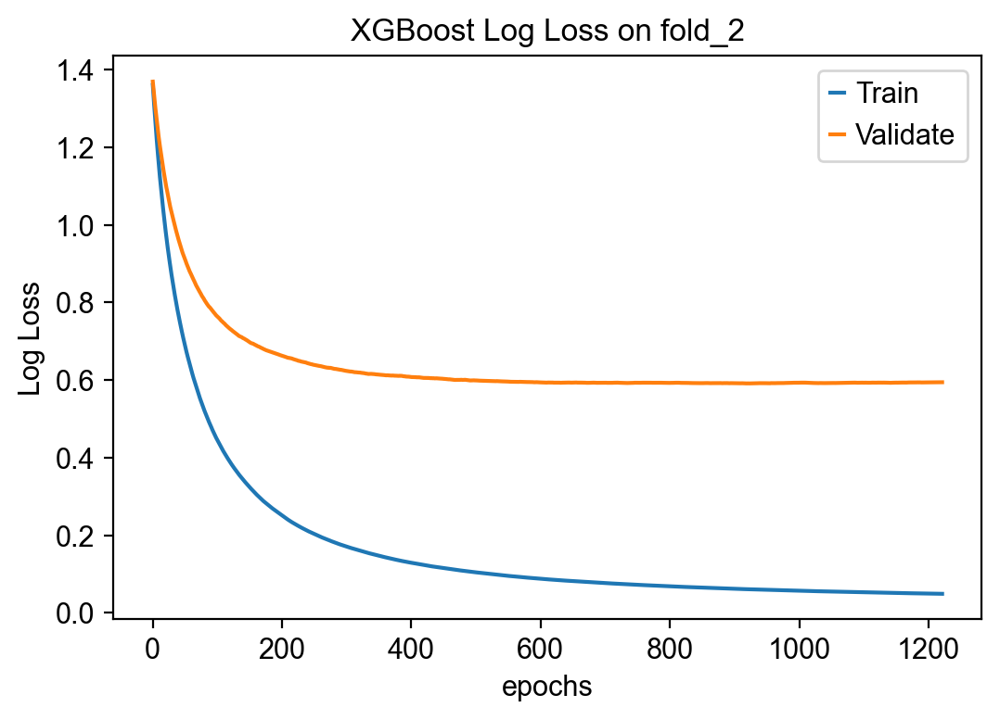

=====================fold_3=====================
[0]	validation_0-mlogloss:1.36193	validation_1-mlogloss:1.36815
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.44356	validation_1-mlogloss:0.75714
[200]	validation_0-mlogloss:0.24887	validation_1-mlogloss:0.67203
[300]	validation_0-mlogloss:0.16980	validation_1-mlogloss:0.64376
[400]	validation_0-mlogloss:0.12870	validation_1-mlogloss:0.63466
[500]	validation_0-mlogloss:0.10438	validation_1-mlogloss:0.63004
[600]	validation_0-mlogloss:0.08824	validation_1-mlogloss:0.62855
[700]	validation_0-mlogloss:0.07662	validation_1-mlogloss:0.62880
[800]	validation_0-mlogloss:0.06838	validation_1-mlogloss:0.62903
[900]	validation_0-mlogloss:0.06206	validation_1-mlogloss:0.63101
Stopping. Best iteration:
[645]	validation_0-mlogloss:0.08254	validation_1-mlogloss:0.62782



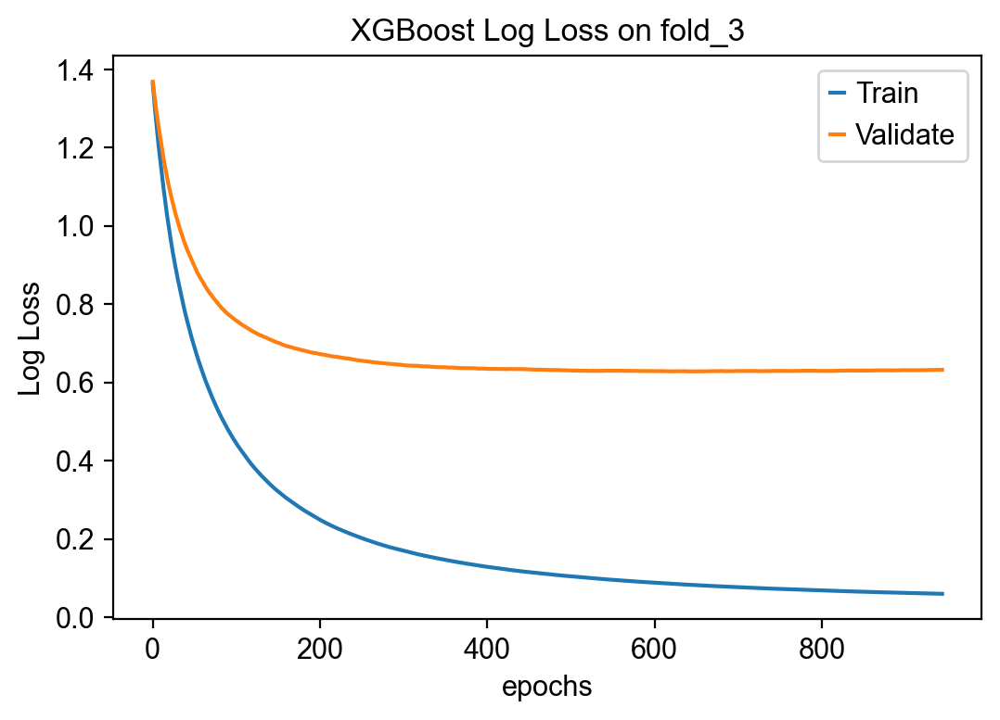

=====================fold_4=====================
[0]	validation_0-mlogloss:1.36105	validation_1-mlogloss:1.36622
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.44368	validation_1-mlogloss:0.74097
[200]	validation_0-mlogloss:0.24950	validation_1-mlogloss:0.67021
[300]	validation_0-mlogloss:0.16867	validation_1-mlogloss:0.65013
[400]	validation_0-mlogloss:0.12757	validation_1-mlogloss:0.64478
[500]	validation_0-mlogloss:0.10342	validation_1-mlogloss:0.64288
[600]	validation_0-mlogloss:0.08755	validation_1-mlogloss:0.64585
[700]	validation_0-mlogloss:0.07630	validation_1-mlogloss:0.64704
[800]	validation_0-mlogloss:0.06814	validation_1-mlogloss:0.64934
Stopping. Best iteration:
[517]	validation_0-mlogloss:0.10032	validation_1-mlogloss:0.64260



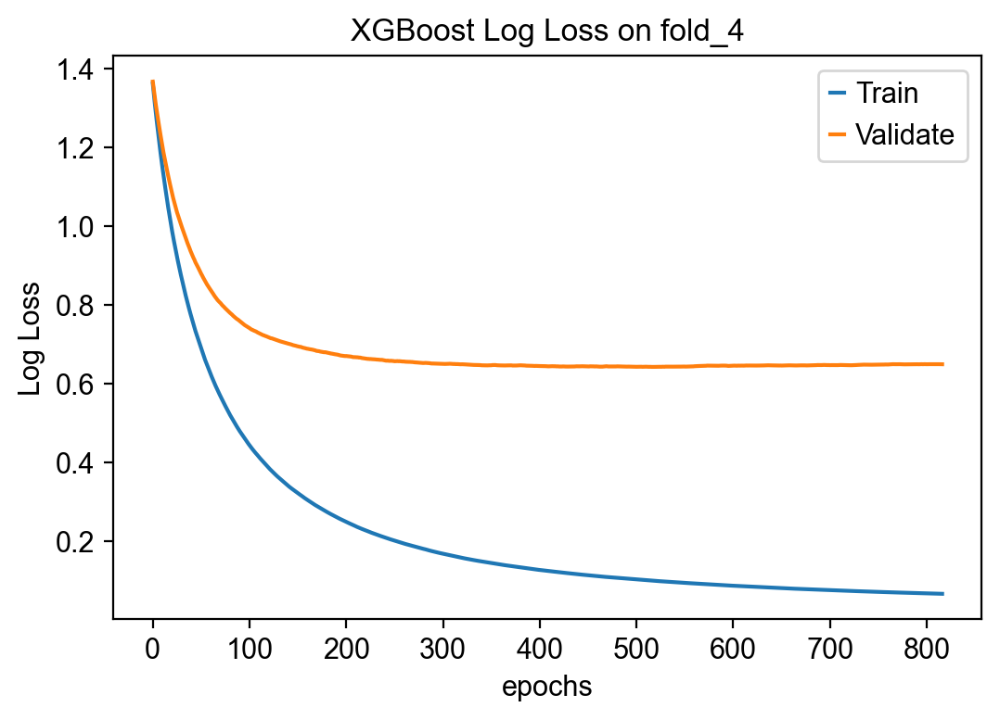

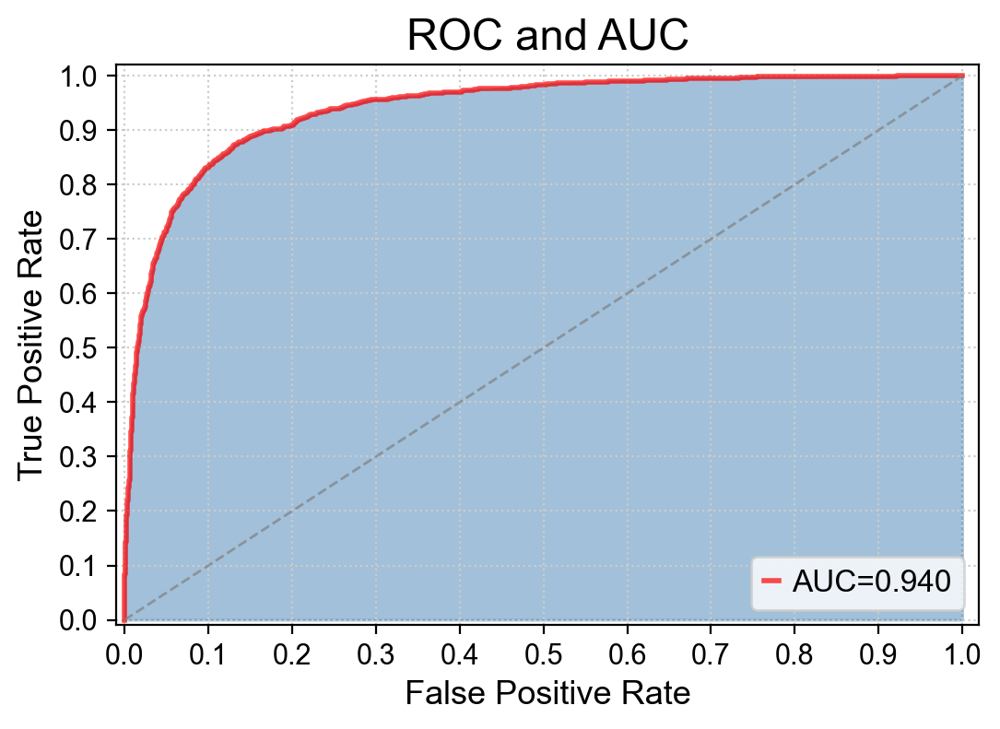

Xgboost balance score is  0.7858049341470597
<function model_XGBC at 0x7f7fa3b1e8c8> Running time: 299.67588114738464 Seconds


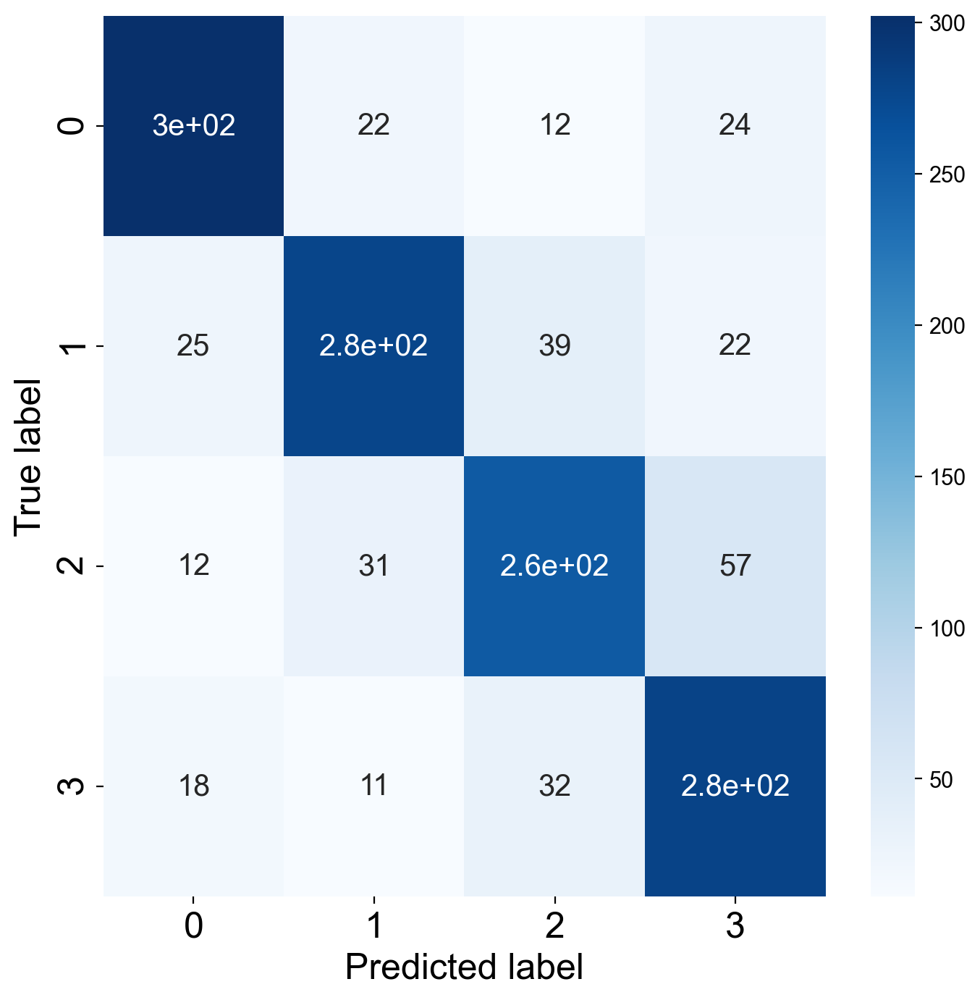

              precision    recall  f1-score   support

           0       0.85      0.84      0.84       360
           1       0.81      0.76      0.79       365
           2       0.75      0.72      0.74       355
           3       0.73      0.82      0.77       342

    accuracy                           0.79      1422
   macro avg       0.79      0.79      0.79      1422
weighted avg       0.79      0.79      0.79      1422



In [1]:
# -*- coding:utf-8 -*-
from package.test.sampling_test import *
from package.model.RandomForest import model_RF
from package.preprocess.load_data import read_data
from package.model.stacking import stacking_model
from package.util.func import *
from package.model import velo_xgb

X = read_data(dataset="dentategyrus", num_class=4, use_gene_list=True)
#test_ensemble()
#test_oversample()
#test_undersample()
#test_combine(X)
# test_real, test_predict = model_RF(X)
test_real, test_predict, feature_importances, valid = velo_xgb.model_XGBC(X, num_class = 4)
# test_real, test_predict = stacking_model(X, num_class=4)
# plot_fi(feature_importances)
eval_result(test_real, test_predict, 4)

In [ ]:
print(model_name + " balance score is ", balanced_accuracy_score(y_test, test_predictions))

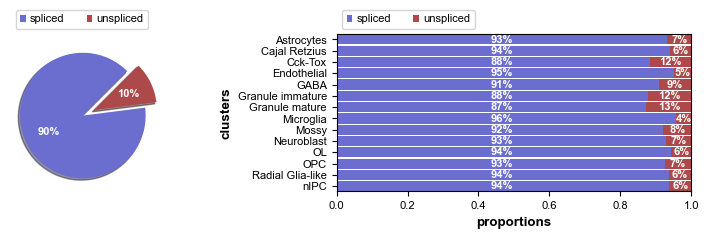

Filtered out 11019 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


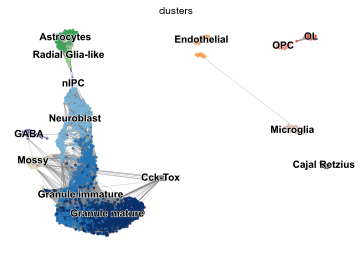

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


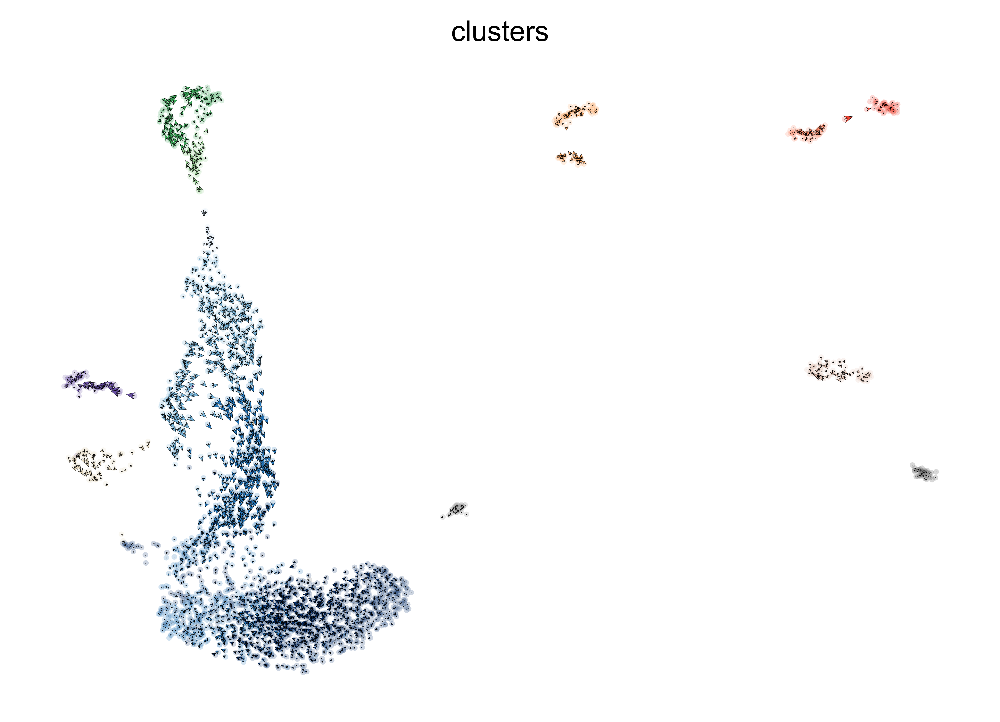

In [8]:
    # test 
    import scvelo as scv
    dataset = "dentategyrus"
    mode = "stochastic"
    basis = "umap"
    if dataset == "dentategyrus":
        adata = scv.datasets.dentategyrus()
    if dataset == "pancreas":
        adata = scv.datasets.pancreas()
    if dataset == "forebrain":
        adata = scv.datasets.forebrain()

    scv.pl.proportions(adata)
    # filter genes, log = True or False
    scv.pp.filter_and_normalize(adata, min_shared_counts=30, n_top_genes=2000)
    # this is on pca space，compute moments
    scv.pp.moments(adata, n_pcs=30, n_neighbors=30, mode='connectivities')

    # fitting a ratio between precursor and mature mRNA abundances
    
    #if mode == 'dynamical':
        # scv.tl.recover_dynamics(adata)
    # compute velo
    scv.tl.velocity(adata, mode=mode)

    # cosine correlation of potential cell transitions
    # approx=True： reduced PCA space with 50 components
    # embed lower D, compute transition matrix
    scv.tl.velocity_graph(adata)

    scv.tl.umap(adata)
    scv.pl.velocity_graph(adata)
    # embedding
    scv.pl.velocity_embedding(adata, basis=basis, arrow_length=1.5, arrow_size=1.5, dpi=1000)

In [17]:
pd.read_csv(path + "data.csv", header=0)

,Tcea1,Rb1cc1,Prex2,A830018L16Rik,Paqr8,Khdrbs2,Arhgef4,Mrpl30,Eif5b,Map4k4,...,Pcdh19,Tspan6,Bex2,Tceal5,Gnl3l,Tspyl2,Sms,Cnksr2,Zrsr2,Tmsb4x
0,0.000000,0.998657,0.000000,0.000000,0.0,0.0,0.000000,0.619133,0.000000,0.0,...,0.619133,0.000000,2.165144,0.000000,0.000000,0.619133,0.998657,0.000000,0.0,3.252782
1,0.712705,0.000000,0.712705,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.712705,0.000000,0.712705,0.000000,0.000000,0.000000,0.0,1.979208
2,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.920456,0.000000,0.0,...,0.000000,0.000000,0.920456,0.920456,0.000000,0.000000,0.000000,0.000000,0.0,3.617664
3,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.774725,0.460583,0.0,...,0.000000,0.460583,1.506294,0.460583,0.774725,0.000000,0.460583,0.000000,0.0,3.349725
4,0.000000,0.000000,0.000000,0.616411,0.0,0.0,0.616411,1.268863,0.000000,0.0,...,0.000000,0.616411,2.253677,0.616411,0.000000,0.000000,0.616411,0.000000,0.0,3.065932
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2925,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.555424,0.0,...,0.000000,0.555424,1.824350,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,3.295608
2926,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.937405,0.000000,0.000000,0.0,...,0.000000,0.000000,2.170964,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,3.644936
2927,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,1.770653,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,2.959073
2928,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,1.184739,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,3.340669


In [35]:

def model(features, n_folds=5, num_class=4, plot=True, over_sampling=True):
    # Extract the labels
    # classification_transfer(features['target'])
    labels = features['target']
    features = features.drop(columns=['target'])

    if over_sampling:
        print("Raw target type ratio:")
        plot_fraction(labels, num_class=num_class)
        sample_solver = SMOTETomek(random_state=326)
        features, labels = sample_solver.fit_sample(features, labels)
        print("After imbalance processing type ratio:")
        plot_fraction(labels, num_class=num_class)

    X_train, X_test, y_train, y_test = train_test_split(features, labels, stratify=labels, test_size=0.3)
    # SMOTE
    # Extract the ids
    test_ids = X_test['ID']

    # Remove the ids and target
    X_train = X_train.drop(columns=['ID'])
    X_test = X_test.drop(columns=['ID'])
    # Extract feature names
    feature_names = list(X_train.columns)

    print('Training Data Shape: ', X_train.shape)
    print('Testing Data Shape: ', X_test.shape)

    # Convert to np arrays
    X_train = np.array(X_train)
    y_train = np.array(y_train)
    X_test = np.array(X_test)
    y_test = np.array(y_test)

    # Create the kfold object
    k_fold = KFold(n_splits=n_folds, shuffle=True, random_state=50)

    # Empty array for feature importances
    feature_importance_values = np.zeros(len(feature_names))

    # Empty array for train/test predictions
    test_predictions = np.zeros((X_test.shape[0], num_class))

    # Lists for recording validation scores
    valid_scores = []

    # Iterate through each fold
    # K折交叉
    fold_num = 0
    for train_indices, valid_indices in k_fold.split(X_train):
        print("=====================fold_" + str(fold_num) + "=====================")
        # Training data for the fold
        train_features, train_labels = X_train[train_indices], y_train[train_indices]
        # Validation data for the fold
        valid_features, valid_labels = X_train[valid_indices], y_train[valid_indices]

        # Create the model
        model = xgb.XGBClassifier(
            # 初始得分
            base_score=0.5,
            # 基分类器类型
            booster='gbtree',
            # 树最大深度，越大越容易过拟合
            max_depth=11,
            # 学习率
            learning_rate=0.03,
            # 估计器的数量
            n_estimators=1700,
            # 目标参数
            objective='multi:softmax',
            # 线程数
            n_jobs=-1,
            # 分裂所需的最小损失减少量
            gamma=0.03,
            # 拆分节点权重和的阈值
            min_child_weight=1,
            # 最大权重估计，1-10，数字越大越保守
            max_delta_step=0,
            # 随机选取的比例
            subsample=0.5,
            # 每棵树特征选取范围
            colsample_bytree=0.8,
            # L1正则化参数
            reg_alpha=1,
            # L2正则化参数
            reg_lambda=1,
            seed=0,
            missing=None, num_class=num_class)

        # Train the model
        # 0是训练集上的表现，1是测试集上的表现
        model.fit(train_features, train_labels,
                  eval_set=[(train_features, train_labels), (valid_features, valid_labels)],
                  early_stopping_rounds=300, eval_metric='mlogloss', verbose=100)

        # Record the feature importances
        # xgb.plot_importance(model, max_num_features=3, importance_type='gain')
        feature_importance_values += model.feature_importances_ / k_fold.n_splits

        plot_logloss(model, fold_num)
        # Make predictions
        # 加权训练结果
        test_predictions += model.predict_proba(X_test) / k_fold.n_splits

        # Record the out of fold predictions
        out_of_fold = model.predict_proba(valid_features)
        # Record the best score
        valid_score = velo_auc(valid_labels, out_of_fold, num_class)
        valid_scores.append(valid_score)
        fold_num += 1
        # Clean up memory
        gc.enable()
        del model, train_features, valid_features
        gc.collect()

    if plot:
        plot_auc(y_test, test_predictions, num_class)
    # 训练集预测值
    test_predictions = get_result(test_predictions)
    test_predict = pd.DataFrame({'ID': test_ids, 'predict_class': test_predictions})
    test_real = pd.DataFrame({'ID': test_ids, 'real_class': y_test})
    return balanced_accuracy_score(y_test, test_predictions)

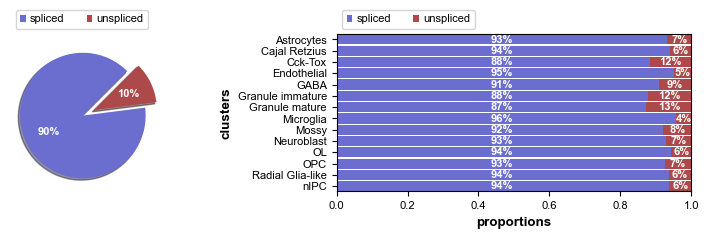

Filtered out 11019 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


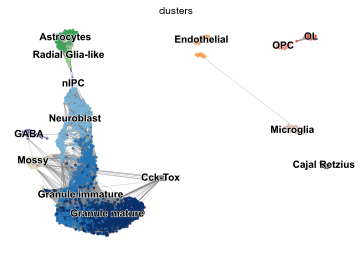

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


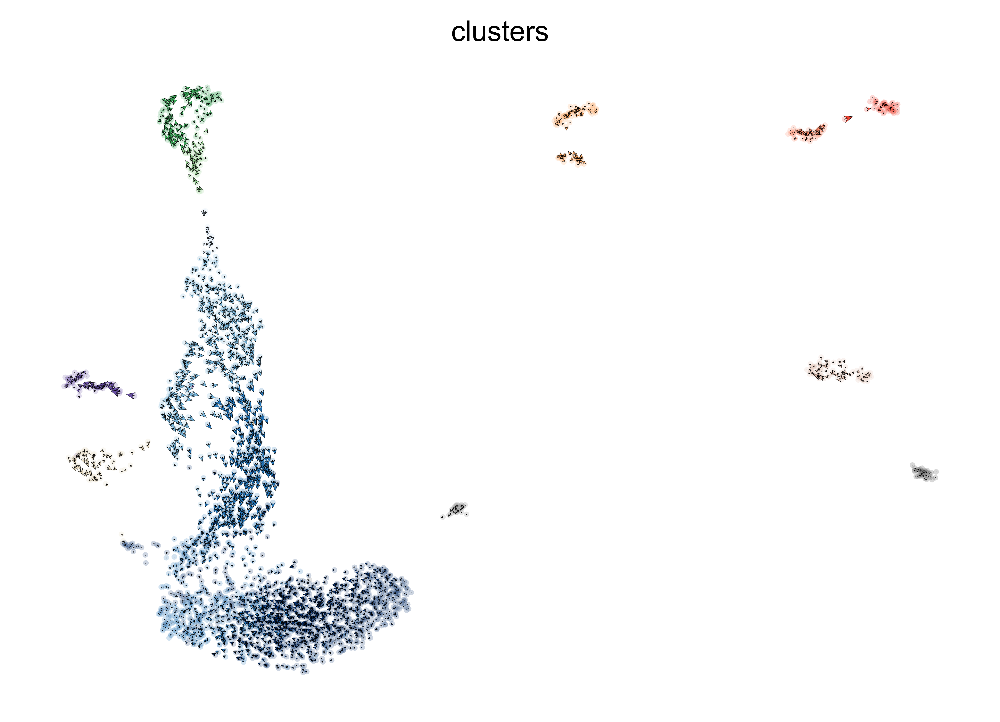

<function gain_data at 0x7f833a631e18> Running time: 33.260287046432495 Seconds
ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7394969463348389 Seconds


,ID,Srgap2,Lsamp,Clic4,Cplx2,Bzw2,Irf9,Hepacam,Grasp,Vsnl1,...,Qk,Lancl1,Igfbpl1,Arhgap31,Ctnnd2,Jph1,Sphkap,2010300C02Rik,Rtn4rl1,target
0,0,0.0,0.000000,0.0,1.815460,0.000000,0.0,0.0,0.000000,0.619133,...,0.000000,0.619133,0.000000,0.0,0.000000,0.619133,0.0,0.000000,0.0,3.0
1,1,0.0,0.712705,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,3.0
2,2,0.0,0.000000,0.0,0.920456,0.920456,0.0,0.0,0.920456,0.920456,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.920456,0.0,2.0
3,3,0.0,0.460583,0.0,1.506294,0.000000,0.0,0.0,0.000000,0.000000,...,0.460583,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.774725,0.0,1.0
4,4,0.0,0.000000,0.0,1.268863,0.000000,0.0,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2925,2925,0.0,0.000000,0.0,1.550410,0.555424,0.0,0.0,0.000000,0.910418,...,0.000000,0.555424,0.000000,0.0,0.000000,0.555424,0.0,0.910418,0.0,2.0
2926,2926,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,...,0.000000,0.000000,1.733431,0.0,0.000000,0.000000,0.0,0.000000,0.0,1.0
2927,2927,0.0,0.796909,0.0,1.770653,0.000000,0.0,0.0,0.796909,0.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,3.0
2928,2928,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,...,1.184739,0.000000,0.000000,0.0,1.711935,0.000000,0.0,0.000000,0.0,1.0


In [34]:
from package.preprocess.load_data import read_data, gain_data
adata = gain_data(dataset="dentategyrus")
get_gene_list(adata, dataset="dentategyrus", top_k=3)
X = read_data(dataset="dentategyrus", num_class=4, use_gene_list=True)
X

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 1.1884658336639404 Seconds
Raw target type ratio:


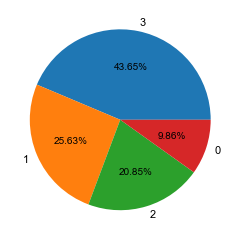

After imbalance processing type ratio:


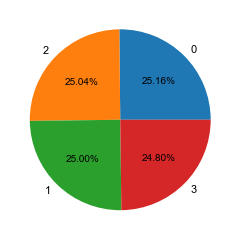

Training Data Shape:  (3486, 161)
Testing Data Shape:  (1494, 161)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.35779	validation_1-mlogloss:1.36524
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35481	validation_1-mlogloss:0.66563
[200]	validation_0-mlogloss:0.17124	validation_1-mlogloss:0.55488
[300]	validation_0-mlogloss:0.10733	validation_1-mlogloss:0.51361
[400]	validation_0-mlogloss:0.07784	validation_1-mlogloss:0.49444
[500]	validation_0-mlogloss:0.06128	validation_1-mlogloss:0.48631
[600]	validation_0-mlogloss:0.05100	validation_1-mlogloss:0.48171
[700]	validation_0-mlogloss:0.04417	validation_1-mlogloss:0.47852
[800]	validation_0-mlogloss:0.03932	validation_1-mlogloss:0.47652
[900]	validation_0-mlogloss:0.03567	validation_1-mlogloss:0.47547
[1000]	validation_0-mlogloss:0.03293	validation_1-mlogloss

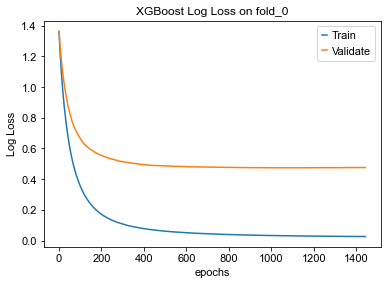

=====================fold_1=====================
[0]	validation_0-mlogloss:1.35650	validation_1-mlogloss:1.36386
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35167	validation_1-mlogloss:0.68742
[200]	validation_0-mlogloss:0.17028	validation_1-mlogloss:0.57874
[300]	validation_0-mlogloss:0.10681	validation_1-mlogloss:0.53972
[400]	validation_0-mlogloss:0.07724	validation_1-mlogloss:0.52085
[500]	validation_0-mlogloss:0.06086	validation_1-mlogloss:0.51119
[600]	validation_0-mlogloss:0.05075	validation_1-mlogloss:0.50655
[700]	validation_0-mlogloss:0.04384	validation_1-mlogloss:0.50416
[800]	validation_0-mlogloss:0.03906	validation_1-mlogloss:0.50148
[900]	validation_0-mlogloss:0.03547	validation_1-mlogloss:0.50034
[1000]	validation_0-mlogloss:0.03275	validation_1-mlogloss:0.50068
[1100]	validation_0-mlogloss:0.03066	validation_1-mlogloss

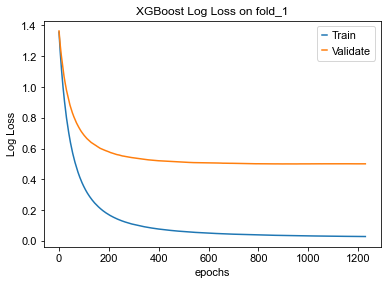

=====================fold_2=====================
[0]	validation_0-mlogloss:1.35724	validation_1-mlogloss:1.36715
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34972	validation_1-mlogloss:0.70663
[200]	validation_0-mlogloss:0.16755	validation_1-mlogloss:0.61129
[300]	validation_0-mlogloss:0.10506	validation_1-mlogloss:0.58151
[400]	validation_0-mlogloss:0.07599	validation_1-mlogloss:0.57155
[500]	validation_0-mlogloss:0.05980	validation_1-mlogloss:0.56680
[600]	validation_0-mlogloss:0.04987	validation_1-mlogloss:0.56791
[700]	validation_0-mlogloss:0.04327	validation_1-mlogloss:0.56958
Stopping. Best iteration:
[493]	validation_0-mlogloss:0.06066	validation_1-mlogloss:0.56631



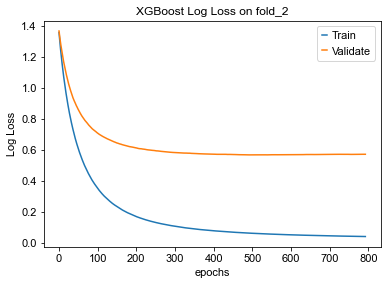

=====================fold_3=====================
[0]	validation_0-mlogloss:1.35735	validation_1-mlogloss:1.36458
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35428	validation_1-mlogloss:0.66564
[200]	validation_0-mlogloss:0.17189	validation_1-mlogloss:0.55707
[300]	validation_0-mlogloss:0.10755	validation_1-mlogloss:0.52004
[400]	validation_0-mlogloss:0.07765	validation_1-mlogloss:0.50380
[500]	validation_0-mlogloss:0.06114	validation_1-mlogloss:0.49647
[600]	validation_0-mlogloss:0.05106	validation_1-mlogloss:0.49484
[700]	validation_0-mlogloss:0.04429	validation_1-mlogloss:0.49446
[800]	validation_0-mlogloss:0.03936	validation_1-mlogloss:0.49395
[900]	validation_0-mlogloss:0.03577	validation_1-mlogloss:0.49550
[1000]	validation_0-mlogloss:0.03297	validation_1-mlogloss:0.49702
Stopping. Best iteration:
[787]	validation_0-mlogloss:0.03

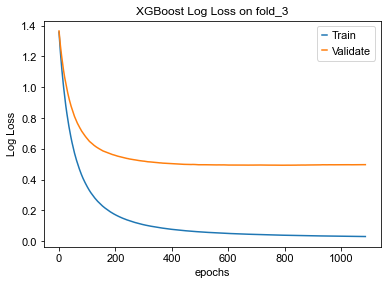

=====================fold_4=====================
[0]	validation_0-mlogloss:1.35728	validation_1-mlogloss:1.36434
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35440	validation_1-mlogloss:0.67463
[200]	validation_0-mlogloss:0.17062	validation_1-mlogloss:0.56263
[300]	validation_0-mlogloss:0.10689	validation_1-mlogloss:0.52395
[400]	validation_0-mlogloss:0.07747	validation_1-mlogloss:0.50584
[500]	validation_0-mlogloss:0.06109	validation_1-mlogloss:0.49706
[600]	validation_0-mlogloss:0.05093	validation_1-mlogloss:0.49410
[700]	validation_0-mlogloss:0.04404	validation_1-mlogloss:0.49043
[800]	validation_0-mlogloss:0.03919	validation_1-mlogloss:0.48946
[900]	validation_0-mlogloss:0.03563	validation_1-mlogloss:0.48891
[1000]	validation_0-mlogloss:0.03288	validation_1-mlogloss:0.48913
[1100]	validation_0-mlogloss:0.03077	validation_1-mlogloss

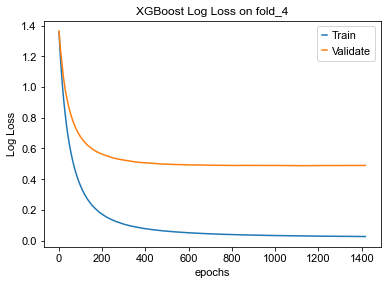

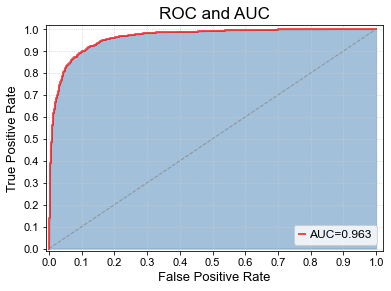

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7493128776550293 Seconds
Raw target type ratio:


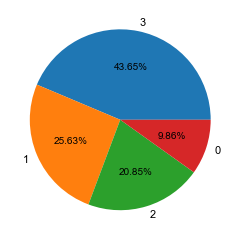

After imbalance processing type ratio:


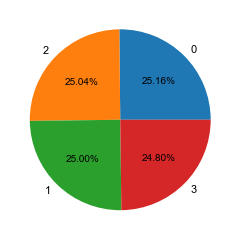

Training Data Shape:  (3486, 162)
Testing Data Shape:  (1494, 162)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.35600	validation_1-mlogloss:1.36398
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34558	validation_1-mlogloss:0.69755
[200]	validation_0-mlogloss:0.16572	validation_1-mlogloss:0.58368
[300]	validation_0-mlogloss:0.10345	validation_1-mlogloss:0.54224
[400]	validation_0-mlogloss:0.07453	validation_1-mlogloss:0.52356
[500]	validation_0-mlogloss:0.05876	validation_1-mlogloss:0.51383
[600]	validation_0-mlogloss:0.04897	validation_1-mlogloss:0.50813
[700]	validation_0-mlogloss:0.04240	validation_1-mlogloss:0.50597
[800]	validation_0-mlogloss:0.03775	validation_1-mlogloss:0.50378
[900]	validation_0-mlogloss:0.03430	validation_1-mlogloss:0.50279
[1000]	validation_0-mlogloss:0.03165	validation_1-mlogloss

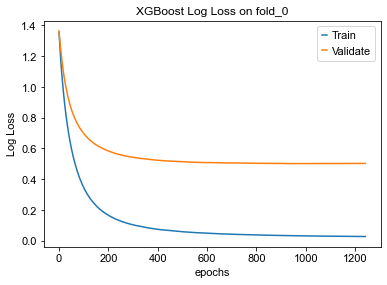

=====================fold_1=====================
[0]	validation_0-mlogloss:1.35757	validation_1-mlogloss:1.36678
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34694	validation_1-mlogloss:0.68061
[200]	validation_0-mlogloss:0.16573	validation_1-mlogloss:0.56967
[300]	validation_0-mlogloss:0.10298	validation_1-mlogloss:0.53196
[400]	validation_0-mlogloss:0.07441	validation_1-mlogloss:0.51883
[500]	validation_0-mlogloss:0.05869	validation_1-mlogloss:0.51278
[600]	validation_0-mlogloss:0.04884	validation_1-mlogloss:0.51008
[700]	validation_0-mlogloss:0.04223	validation_1-mlogloss:0.50992
[800]	validation_0-mlogloss:0.03752	validation_1-mlogloss:0.51071
[900]	validation_0-mlogloss:0.03412	validation_1-mlogloss:0.51092
Stopping. Best iteration:
[666]	validation_0-mlogloss:0.04424	validation_1-mlogloss:0.50936



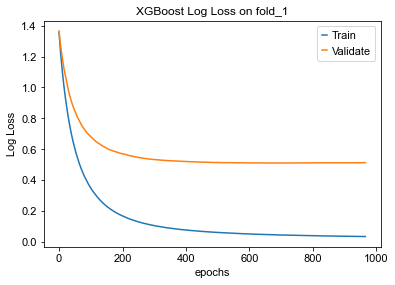

=====================fold_2=====================
[0]	validation_0-mlogloss:1.35656	validation_1-mlogloss:1.36549
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34734	validation_1-mlogloss:0.67034
[200]	validation_0-mlogloss:0.16761	validation_1-mlogloss:0.55231
[300]	validation_0-mlogloss:0.10495	validation_1-mlogloss:0.51071
[400]	validation_0-mlogloss:0.07562	validation_1-mlogloss:0.49042
[500]	validation_0-mlogloss:0.05949	validation_1-mlogloss:0.47824
[600]	validation_0-mlogloss:0.04957	validation_1-mlogloss:0.47152
[700]	validation_0-mlogloss:0.04298	validation_1-mlogloss:0.46824
[800]	validation_0-mlogloss:0.03819	validation_1-mlogloss:0.46684
[900]	validation_0-mlogloss:0.03465	validation_1-mlogloss:0.46516
[1000]	validation_0-mlogloss:0.03202	validation_1-mlogloss:0.46454
[1100]	validation_0-mlogloss:0.02994	validation_1-mlogloss

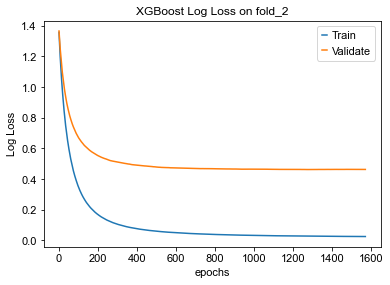

=====================fold_3=====================
[0]	validation_0-mlogloss:1.35777	validation_1-mlogloss:1.36546
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34972	validation_1-mlogloss:0.68401
[200]	validation_0-mlogloss:0.16843	validation_1-mlogloss:0.56756
[300]	validation_0-mlogloss:0.10505	validation_1-mlogloss:0.52655
[400]	validation_0-mlogloss:0.07583	validation_1-mlogloss:0.50567
[500]	validation_0-mlogloss:0.05963	validation_1-mlogloss:0.49523
[600]	validation_0-mlogloss:0.04974	validation_1-mlogloss:0.49027
[700]	validation_0-mlogloss:0.04304	validation_1-mlogloss:0.48724
[800]	validation_0-mlogloss:0.03831	validation_1-mlogloss:0.48735
[900]	validation_0-mlogloss:0.03486	validation_1-mlogloss:0.48564
[1000]	validation_0-mlogloss:0.03216	validation_1-mlogloss:0.48572
[1100]	validation_0-mlogloss:0.03014	validation_1-mlogloss

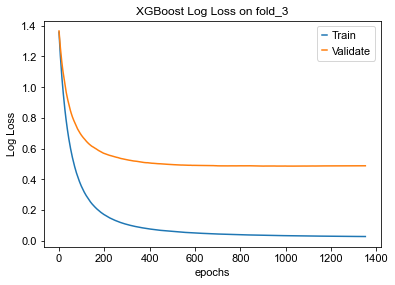

=====================fold_4=====================
[0]	validation_0-mlogloss:1.35791	validation_1-mlogloss:1.36375
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35186	validation_1-mlogloss:0.62704
[200]	validation_0-mlogloss:0.16843	validation_1-mlogloss:0.50950
[300]	validation_0-mlogloss:0.10481	validation_1-mlogloss:0.47221
[400]	validation_0-mlogloss:0.07594	validation_1-mlogloss:0.45513
[500]	validation_0-mlogloss:0.05981	validation_1-mlogloss:0.44741
[600]	validation_0-mlogloss:0.04997	validation_1-mlogloss:0.44306
[700]	validation_0-mlogloss:0.04324	validation_1-mlogloss:0.43981
[800]	validation_0-mlogloss:0.03847	validation_1-mlogloss:0.44002
[900]	validation_0-mlogloss:0.03490	validation_1-mlogloss:0.43871
[1000]	validation_0-mlogloss:0.03219	validation_1-mlogloss:0.43784
[1100]	validation_0-mlogloss:0.03015	validation_1-mlogloss

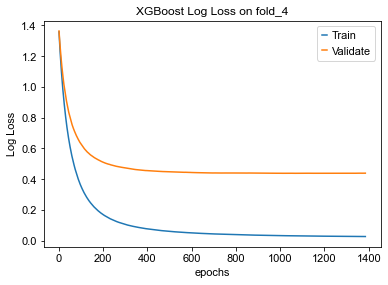

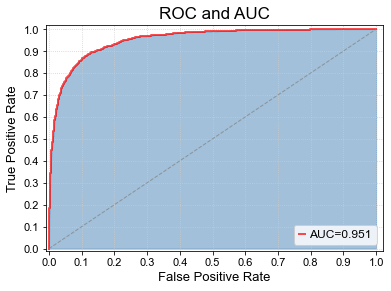

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7452230453491211 Seconds
Raw target type ratio:


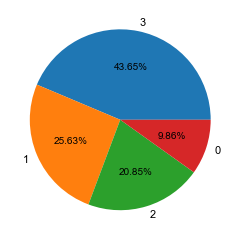

After imbalance processing type ratio:


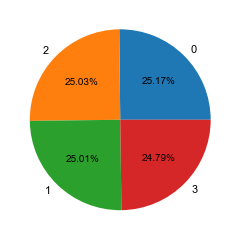

Training Data Shape:  (3487, 163)
Testing Data Shape:  (1495, 163)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.35669	validation_1-mlogloss:1.36533
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35723	validation_1-mlogloss:0.70193
[200]	validation_0-mlogloss:0.17276	validation_1-mlogloss:0.60188
[300]	validation_0-mlogloss:0.10815	validation_1-mlogloss:0.56598
[400]	validation_0-mlogloss:0.07823	validation_1-mlogloss:0.55083
[500]	validation_0-mlogloss:0.06166	validation_1-mlogloss:0.54299
[600]	validation_0-mlogloss:0.05140	validation_1-mlogloss:0.53859
[700]	validation_0-mlogloss:0.04446	validation_1-mlogloss:0.53725
[800]	validation_0-mlogloss:0.03948	validation_1-mlogloss:0.53677
[900]	validation_0-mlogloss:0.03584	validation_1-mlogloss:0.53596
[1000]	validation_0-mlogloss:0.03313	validation_1-mlogloss

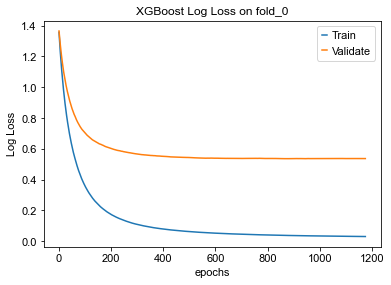

=====================fold_1=====================
[0]	validation_0-mlogloss:1.35747	validation_1-mlogloss:1.36384
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.36042	validation_1-mlogloss:0.68046
[200]	validation_0-mlogloss:0.17316	validation_1-mlogloss:0.57714
[300]	validation_0-mlogloss:0.10868	validation_1-mlogloss:0.54291
[400]	validation_0-mlogloss:0.07851	validation_1-mlogloss:0.52660
[500]	validation_0-mlogloss:0.06171	validation_1-mlogloss:0.51960
[600]	validation_0-mlogloss:0.05155	validation_1-mlogloss:0.51606
[700]	validation_0-mlogloss:0.04467	validation_1-mlogloss:0.51464
[800]	validation_0-mlogloss:0.03966	validation_1-mlogloss:0.51441
[900]	validation_0-mlogloss:0.03599	validation_1-mlogloss:0.51476
[1000]	validation_0-mlogloss:0.03329	validation_1-mlogloss:0.51362
[1100]	validation_0-mlogloss:0.03111	validation_1-mlogloss

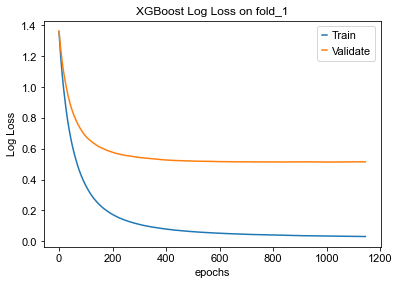

=====================fold_2=====================
[0]	validation_0-mlogloss:1.35692	validation_1-mlogloss:1.36491
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35910	validation_1-mlogloss:0.66290
[200]	validation_0-mlogloss:0.17449	validation_1-mlogloss:0.54612
[300]	validation_0-mlogloss:0.10956	validation_1-mlogloss:0.50235
[400]	validation_0-mlogloss:0.07927	validation_1-mlogloss:0.48259
[500]	validation_0-mlogloss:0.06239	validation_1-mlogloss:0.47127
[600]	validation_0-mlogloss:0.05194	validation_1-mlogloss:0.46443
[700]	validation_0-mlogloss:0.04501	validation_1-mlogloss:0.46075
[800]	validation_0-mlogloss:0.04001	validation_1-mlogloss:0.45871
[900]	validation_0-mlogloss:0.03640	validation_1-mlogloss:0.45754
[1000]	validation_0-mlogloss:0.03355	validation_1-mlogloss:0.45627
[1100]	validation_0-mlogloss:0.03131	validation_1-mlogloss

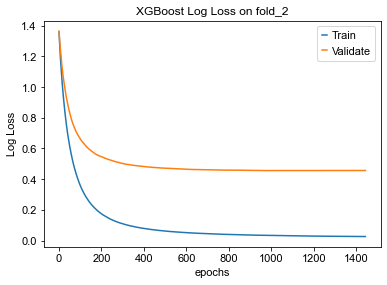

=====================fold_3=====================
[0]	validation_0-mlogloss:1.35753	validation_1-mlogloss:1.36654
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35448	validation_1-mlogloss:0.71264
[200]	validation_0-mlogloss:0.17131	validation_1-mlogloss:0.60067
[300]	validation_0-mlogloss:0.10754	validation_1-mlogloss:0.55933
[400]	validation_0-mlogloss:0.07751	validation_1-mlogloss:0.53671
[500]	validation_0-mlogloss:0.06097	validation_1-mlogloss:0.52346
[600]	validation_0-mlogloss:0.05082	validation_1-mlogloss:0.51738
[700]	validation_0-mlogloss:0.04405	validation_1-mlogloss:0.51308
[800]	validation_0-mlogloss:0.03928	validation_1-mlogloss:0.51070
[900]	validation_0-mlogloss:0.03566	validation_1-mlogloss:0.50855
[1000]	validation_0-mlogloss:0.03290	validation_1-mlogloss:0.50767
[1100]	validation_0-mlogloss:0.03078	validation_1-mlogloss

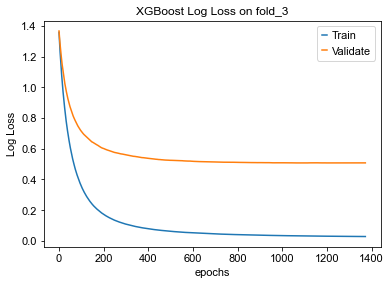

=====================fold_4=====================
[0]	validation_0-mlogloss:1.35724	validation_1-mlogloss:1.36622
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35798	validation_1-mlogloss:0.71322
[200]	validation_0-mlogloss:0.17230	validation_1-mlogloss:0.60305
[300]	validation_0-mlogloss:0.10791	validation_1-mlogloss:0.56584
[400]	validation_0-mlogloss:0.07801	validation_1-mlogloss:0.54979
[500]	validation_0-mlogloss:0.06141	validation_1-mlogloss:0.54062
[600]	validation_0-mlogloss:0.05121	validation_1-mlogloss:0.53619
[700]	validation_0-mlogloss:0.04421	validation_1-mlogloss:0.53442
[800]	validation_0-mlogloss:0.03928	validation_1-mlogloss:0.53347
[900]	validation_0-mlogloss:0.03567	validation_1-mlogloss:0.53267
[1000]	validation_0-mlogloss:0.03296	validation_1-mlogloss:0.53292
[1100]	validation_0-mlogloss:0.03078	validation_1-mlogloss

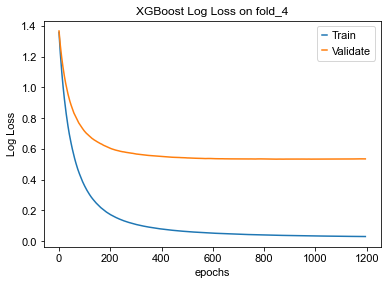

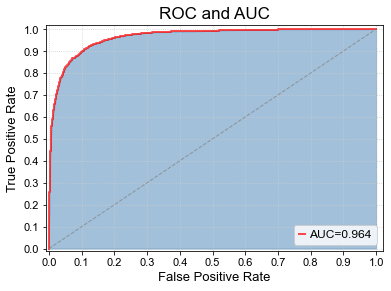

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7469089031219482 Seconds
Raw target type ratio:


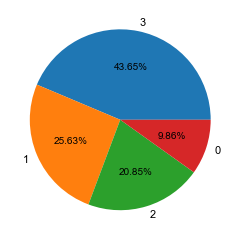

After imbalance processing type ratio:


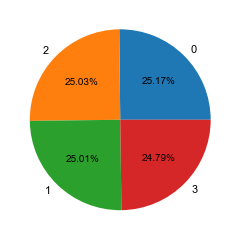

Training Data Shape:  (3487, 163)
Testing Data Shape:  (1495, 163)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.35704	validation_1-mlogloss:1.36347
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35371	validation_1-mlogloss:0.65728
[200]	validation_0-mlogloss:0.17167	validation_1-mlogloss:0.54518
[300]	validation_0-mlogloss:0.10792	validation_1-mlogloss:0.50282
[400]	validation_0-mlogloss:0.07812	validation_1-mlogloss:0.48367
[500]	validation_0-mlogloss:0.06158	validation_1-mlogloss:0.47360
[600]	validation_0-mlogloss:0.05152	validation_1-mlogloss:0.46830
[700]	validation_0-mlogloss:0.04446	validation_1-mlogloss:0.46371
[800]	validation_0-mlogloss:0.03963	validation_1-mlogloss:0.46246
[900]	validation_0-mlogloss:0.03600	validation_1-mlogloss:0.46108
[1000]	validation_0-mlogloss:0.03324	validation_1-mlogloss

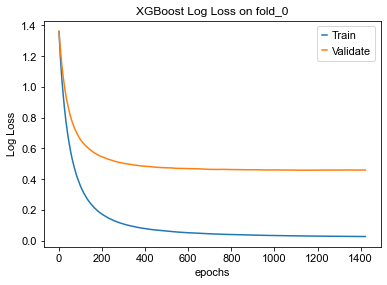

=====================fold_1=====================
[0]	validation_0-mlogloss:1.35540	validation_1-mlogloss:1.36600
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34944	validation_1-mlogloss:0.72838
[200]	validation_0-mlogloss:0.16913	validation_1-mlogloss:0.62472
[300]	validation_0-mlogloss:0.10577	validation_1-mlogloss:0.58779
[400]	validation_0-mlogloss:0.07638	validation_1-mlogloss:0.57099
[500]	validation_0-mlogloss:0.06028	validation_1-mlogloss:0.56153
[600]	validation_0-mlogloss:0.05026	validation_1-mlogloss:0.55939
[700]	validation_0-mlogloss:0.04348	validation_1-mlogloss:0.55763
[800]	validation_0-mlogloss:0.03864	validation_1-mlogloss:0.55983
[900]	validation_0-mlogloss:0.03509	validation_1-mlogloss:0.55905
[1000]	validation_0-mlogloss:0.03239	validation_1-mlogloss:0.56005
Stopping. Best iteration:
[715]	validation_0-mlogloss:0.04

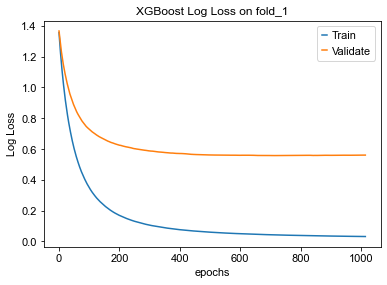

=====================fold_2=====================
[0]	validation_0-mlogloss:1.35633	validation_1-mlogloss:1.36574
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35137	validation_1-mlogloss:0.68329
[200]	validation_0-mlogloss:0.16978	validation_1-mlogloss:0.57072
[300]	validation_0-mlogloss:0.10666	validation_1-mlogloss:0.53129
[400]	validation_0-mlogloss:0.07713	validation_1-mlogloss:0.51329
[500]	validation_0-mlogloss:0.06087	validation_1-mlogloss:0.50394
[600]	validation_0-mlogloss:0.05078	validation_1-mlogloss:0.49962
[700]	validation_0-mlogloss:0.04392	validation_1-mlogloss:0.50008
[800]	validation_0-mlogloss:0.03909	validation_1-mlogloss:0.49790
[900]	validation_0-mlogloss:0.03558	validation_1-mlogloss:0.49650
[1000]	validation_0-mlogloss:0.03282	validation_1-mlogloss:0.49582
[1100]	validation_0-mlogloss:0.03068	validation_1-mlogloss

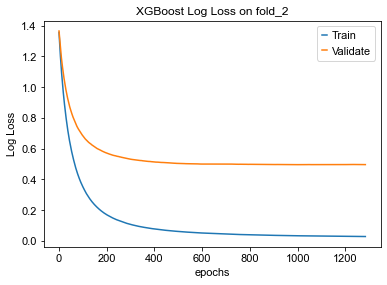

=====================fold_3=====================
[0]	validation_0-mlogloss:1.35642	validation_1-mlogloss:1.36373
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35090	validation_1-mlogloss:0.67246
[200]	validation_0-mlogloss:0.17027	validation_1-mlogloss:0.57527
[300]	validation_0-mlogloss:0.10704	validation_1-mlogloss:0.54729
[400]	validation_0-mlogloss:0.07739	validation_1-mlogloss:0.53558
[500]	validation_0-mlogloss:0.06094	validation_1-mlogloss:0.53203
[600]	validation_0-mlogloss:0.05069	validation_1-mlogloss:0.53096
[700]	validation_0-mlogloss:0.04389	validation_1-mlogloss:0.53141
[800]	validation_0-mlogloss:0.03905	validation_1-mlogloss:0.53207
Stopping. Best iteration:
[594]	validation_0-mlogloss:0.05118	validation_1-mlogloss:0.53053



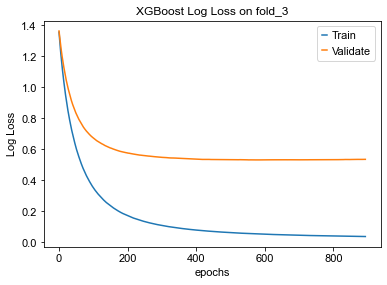

=====================fold_4=====================
[0]	validation_0-mlogloss:1.35756	validation_1-mlogloss:1.36458
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35817	validation_1-mlogloss:0.65016
[200]	validation_0-mlogloss:0.17335	validation_1-mlogloss:0.53954
[300]	validation_0-mlogloss:0.10862	validation_1-mlogloss:0.50341
[400]	validation_0-mlogloss:0.07833	validation_1-mlogloss:0.48799
[500]	validation_0-mlogloss:0.06172	validation_1-mlogloss:0.48179
[600]	validation_0-mlogloss:0.05134	validation_1-mlogloss:0.47479
[700]	validation_0-mlogloss:0.04433	validation_1-mlogloss:0.47263
[800]	validation_0-mlogloss:0.03941	validation_1-mlogloss:0.47118
[900]	validation_0-mlogloss:0.03583	validation_1-mlogloss:0.47217
[1000]	validation_0-mlogloss:0.03304	validation_1-mlogloss:0.47234
Stopping. Best iteration:
[792]	validation_0-mlogloss:0.03

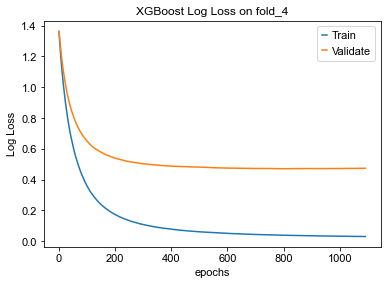

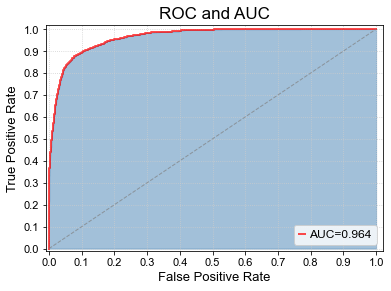

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7587342262268066 Seconds
Raw target type ratio:


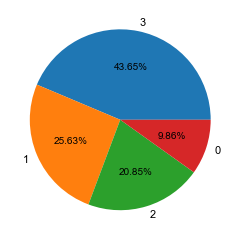

After imbalance processing type ratio:


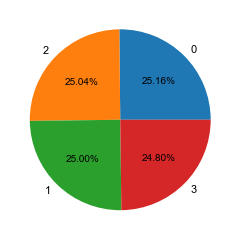

Training Data Shape:  (3486, 164)
Testing Data Shape:  (1494, 164)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.35610	validation_1-mlogloss:1.36577
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35391	validation_1-mlogloss:0.69574
[200]	validation_0-mlogloss:0.17162	validation_1-mlogloss:0.57557
[300]	validation_0-mlogloss:0.10739	validation_1-mlogloss:0.52926
[400]	validation_0-mlogloss:0.07770	validation_1-mlogloss:0.50635
[500]	validation_0-mlogloss:0.06131	validation_1-mlogloss:0.49387
[600]	validation_0-mlogloss:0.05102	validation_1-mlogloss:0.48586
[700]	validation_0-mlogloss:0.04417	validation_1-mlogloss:0.48264
[800]	validation_0-mlogloss:0.03929	validation_1-mlogloss:0.47963
[900]	validation_0-mlogloss:0.03564	validation_1-mlogloss:0.47687
[1000]	validation_0-mlogloss:0.03291	validation_1-mlogloss

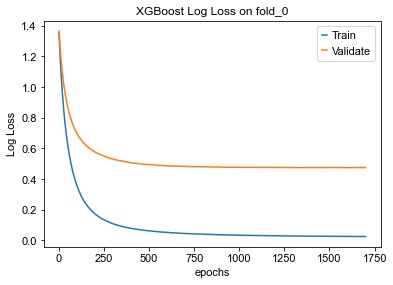

=====================fold_1=====================
[0]	validation_0-mlogloss:1.35678	validation_1-mlogloss:1.36529
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34954	validation_1-mlogloss:0.69719
[200]	validation_0-mlogloss:0.16874	validation_1-mlogloss:0.59521
[300]	validation_0-mlogloss:0.10613	validation_1-mlogloss:0.56298
[400]	validation_0-mlogloss:0.07660	validation_1-mlogloss:0.54822
[500]	validation_0-mlogloss:0.06034	validation_1-mlogloss:0.54181
[600]	validation_0-mlogloss:0.05039	validation_1-mlogloss:0.53973
[700]	validation_0-mlogloss:0.04365	validation_1-mlogloss:0.53874
[800]	validation_0-mlogloss:0.03882	validation_1-mlogloss:0.53841
[900]	validation_0-mlogloss:0.03528	validation_1-mlogloss:0.53920
[1000]	validation_0-mlogloss:0.03256	validation_1-mlogloss:0.53971
Stopping. Best iteration:
[728]	validation_0-mlogloss:0.04

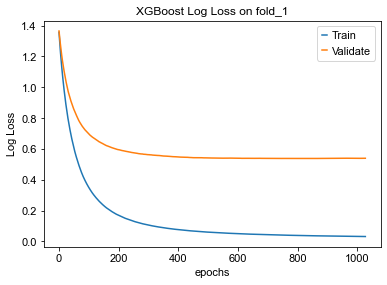

=====================fold_2=====================
[0]	validation_0-mlogloss:1.35754	validation_1-mlogloss:1.36336
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35840	validation_1-mlogloss:0.63734
[200]	validation_0-mlogloss:0.17411	validation_1-mlogloss:0.51844
[300]	validation_0-mlogloss:0.10940	validation_1-mlogloss:0.47548
[400]	validation_0-mlogloss:0.07909	validation_1-mlogloss:0.45559
[500]	validation_0-mlogloss:0.06226	validation_1-mlogloss:0.44328
[600]	validation_0-mlogloss:0.05186	validation_1-mlogloss:0.43640
[700]	validation_0-mlogloss:0.04488	validation_1-mlogloss:0.43266
[800]	validation_0-mlogloss:0.03999	validation_1-mlogloss:0.42945
[900]	validation_0-mlogloss:0.03625	validation_1-mlogloss:0.42772
[1000]	validation_0-mlogloss:0.03343	validation_1-mlogloss:0.42648
[1100]	validation_0-mlogloss:0.03126	validation_1-mlogloss

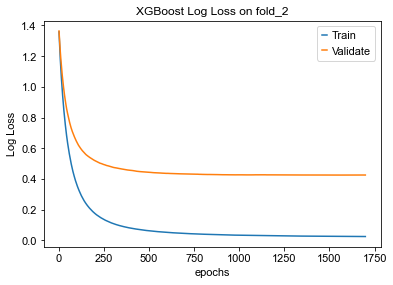

=====================fold_3=====================
[0]	validation_0-mlogloss:1.35602	validation_1-mlogloss:1.36683
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35341	validation_1-mlogloss:0.71012
[200]	validation_0-mlogloss:0.17128	validation_1-mlogloss:0.59918
[300]	validation_0-mlogloss:0.10727	validation_1-mlogloss:0.55875
[400]	validation_0-mlogloss:0.07740	validation_1-mlogloss:0.54038
[500]	validation_0-mlogloss:0.06096	validation_1-mlogloss:0.53001
[600]	validation_0-mlogloss:0.05085	validation_1-mlogloss:0.52518
[700]	validation_0-mlogloss:0.04391	validation_1-mlogloss:0.52291
[800]	validation_0-mlogloss:0.03904	validation_1-mlogloss:0.52192
[900]	validation_0-mlogloss:0.03550	validation_1-mlogloss:0.52223
[1000]	validation_0-mlogloss:0.03275	validation_1-mlogloss:0.52270
[1100]	validation_0-mlogloss:0.03066	validation_1-mlogloss

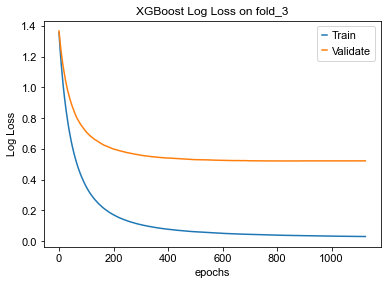

=====================fold_4=====================
[0]	validation_0-mlogloss:1.35634	validation_1-mlogloss:1.36260
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35397	validation_1-mlogloss:0.67995
[200]	validation_0-mlogloss:0.17255	validation_1-mlogloss:0.58131
[300]	validation_0-mlogloss:0.10774	validation_1-mlogloss:0.55200
[400]	validation_0-mlogloss:0.07795	validation_1-mlogloss:0.54012
[500]	validation_0-mlogloss:0.06128	validation_1-mlogloss:0.53591
[600]	validation_0-mlogloss:0.05092	validation_1-mlogloss:0.53168
[700]	validation_0-mlogloss:0.04398	validation_1-mlogloss:0.53229
[800]	validation_0-mlogloss:0.03909	validation_1-mlogloss:0.53304
[900]	validation_0-mlogloss:0.03551	validation_1-mlogloss:0.53312
Stopping. Best iteration:
[618]	validation_0-mlogloss:0.04953	validation_1-mlogloss:0.53094



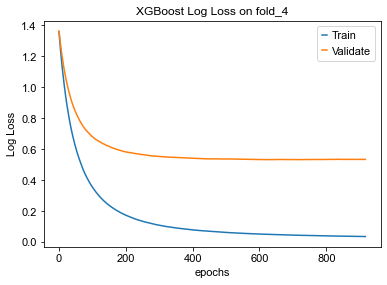

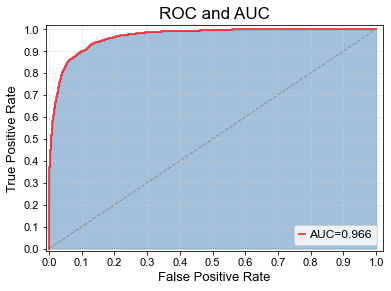

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7756240367889404 Seconds
Raw target type ratio:


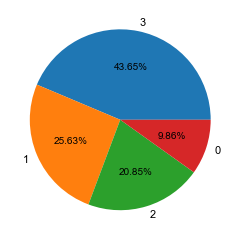

After imbalance processing type ratio:


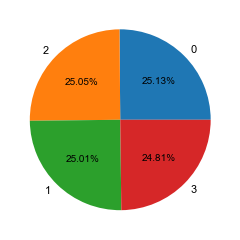

Training Data Shape:  (3481, 167)
Testing Data Shape:  (1493, 167)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.35750	validation_1-mlogloss:1.36769
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35297	validation_1-mlogloss:0.70597
[200]	validation_0-mlogloss:0.17049	validation_1-mlogloss:0.58815
[300]	validation_0-mlogloss:0.10678	validation_1-mlogloss:0.54134
[400]	validation_0-mlogloss:0.07705	validation_1-mlogloss:0.51767
[500]	validation_0-mlogloss:0.06069	validation_1-mlogloss:0.50272
[600]	validation_0-mlogloss:0.05062	validation_1-mlogloss:0.49474
[700]	validation_0-mlogloss:0.04371	validation_1-mlogloss:0.49043
[800]	validation_0-mlogloss:0.03892	validation_1-mlogloss:0.48686
[900]	validation_0-mlogloss:0.03526	validation_1-mlogloss:0.48479
[1000]	validation_0-mlogloss:0.03258	validation_1-mlogloss

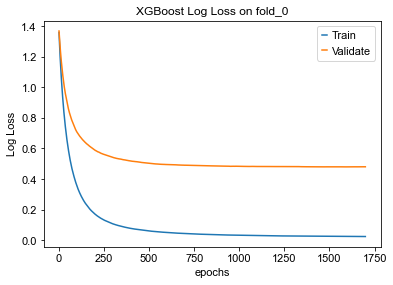

=====================fold_1=====================
[0]	validation_0-mlogloss:1.35626	validation_1-mlogloss:1.36552
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.34998	validation_1-mlogloss:0.69598
[200]	validation_0-mlogloss:0.16844	validation_1-mlogloss:0.59297
[300]	validation_0-mlogloss:0.10555	validation_1-mlogloss:0.55677
[400]	validation_0-mlogloss:0.07611	validation_1-mlogloss:0.54140
[500]	validation_0-mlogloss:0.05991	validation_1-mlogloss:0.53508
[600]	validation_0-mlogloss:0.04988	validation_1-mlogloss:0.53042
[700]	validation_0-mlogloss:0.04320	validation_1-mlogloss:0.53034
[800]	validation_0-mlogloss:0.03850	validation_1-mlogloss:0.52860
[900]	validation_0-mlogloss:0.03496	validation_1-mlogloss:0.52961
[1000]	validation_0-mlogloss:0.03223	validation_1-mlogloss:0.52925
[1100]	validation_0-mlogloss:0.03021	validation_1-mlogloss

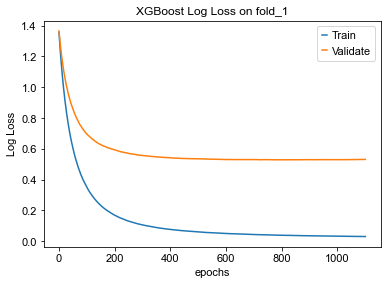

=====================fold_2=====================
[0]	validation_0-mlogloss:1.35695	validation_1-mlogloss:1.36479
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35090	validation_1-mlogloss:0.69729
[200]	validation_0-mlogloss:0.17014	validation_1-mlogloss:0.60308
[300]	validation_0-mlogloss:0.10635	validation_1-mlogloss:0.56873
[400]	validation_0-mlogloss:0.07680	validation_1-mlogloss:0.55503
[500]	validation_0-mlogloss:0.06053	validation_1-mlogloss:0.54874
[600]	validation_0-mlogloss:0.05056	validation_1-mlogloss:0.54598
[700]	validation_0-mlogloss:0.04378	validation_1-mlogloss:0.54395
[800]	validation_0-mlogloss:0.03903	validation_1-mlogloss:0.54459
[900]	validation_0-mlogloss:0.03547	validation_1-mlogloss:0.54544
Stopping. Best iteration:
[658]	validation_0-mlogloss:0.04639	validation_1-mlogloss:0.54314



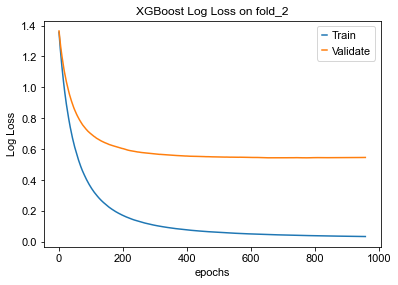

=====================fold_3=====================
[0]	validation_0-mlogloss:1.35627	validation_1-mlogloss:1.36304
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35601	validation_1-mlogloss:0.65014
[200]	validation_0-mlogloss:0.17303	validation_1-mlogloss:0.53955
[300]	validation_0-mlogloss:0.10855	validation_1-mlogloss:0.49988
[400]	validation_0-mlogloss:0.07852	validation_1-mlogloss:0.48030
[500]	validation_0-mlogloss:0.06175	validation_1-mlogloss:0.47079
[600]	validation_0-mlogloss:0.05135	validation_1-mlogloss:0.46483
[700]	validation_0-mlogloss:0.04450	validation_1-mlogloss:0.46142
[800]	validation_0-mlogloss:0.03959	validation_1-mlogloss:0.46008
[900]	validation_0-mlogloss:0.03589	validation_1-mlogloss:0.45819
[1000]	validation_0-mlogloss:0.03311	validation_1-mlogloss:0.45886
[1100]	validation_0-mlogloss:0.03095	validation_1-mlogloss

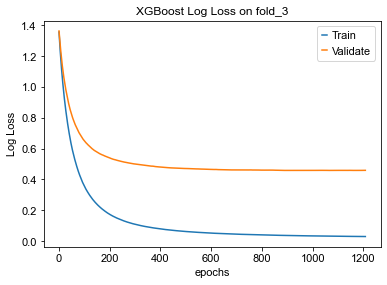

=====================fold_4=====================
[0]	validation_0-mlogloss:1.35604	validation_1-mlogloss:1.36485
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.35836	validation_1-mlogloss:0.66563
[200]	validation_0-mlogloss:0.17327	validation_1-mlogloss:0.55911
[300]	validation_0-mlogloss:0.10857	validation_1-mlogloss:0.52104
[400]	validation_0-mlogloss:0.07828	validation_1-mlogloss:0.50361
[500]	validation_0-mlogloss:0.06152	validation_1-mlogloss:0.49418
[600]	validation_0-mlogloss:0.05121	validation_1-mlogloss:0.48893
[700]	validation_0-mlogloss:0.04436	validation_1-mlogloss:0.48634
[800]	validation_0-mlogloss:0.03946	validation_1-mlogloss:0.48497
[900]	validation_0-mlogloss:0.03585	validation_1-mlogloss:0.48468
[1000]	validation_0-mlogloss:0.03308	validation_1-mlogloss:0.48424
[1100]	validation_0-mlogloss:0.03098	validation_1-mlogloss

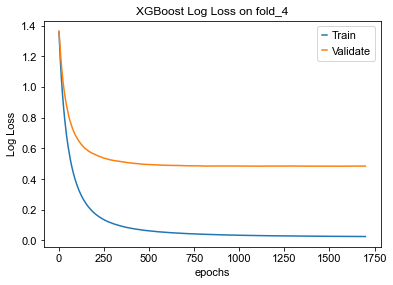

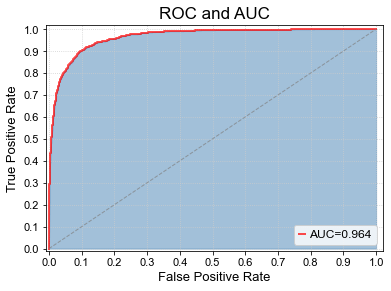

In [43]:
    from sklearn.metrics import balanced_accuracy_score
    from package.preprocess import feature_engineering
    from imblearn.combine import SMOTETomek
    import xgboost as xgb
    from sklearn.model_selection import KFold, train_test_split
    from imblearn.combine import SMOTETomek
    from package.util.func import *
    from sklearn.metrics import balanced_accuracy_score
    import gc
    import warnings
    
    
    num_class = 4
    top_k = [26,27,28,29,30,50]
    # path = "./processed_data/" + dataset + "/"
    # V = pd.read_csv(path + "VData.txt", sep=' ', header=None, names=["V_xcom", "V_ycom"])
    # direction = get_direction(V, num_class= num_class)
    
    # exp_ansk = []
    for k in top_k:
        get_gene_list(adata, dataset="dentategyrus", top_k= k)
        X = read_data(dataset="dentategyrus", num_class=4, use_gene_list=True)
        
        # test_real, test_predict = stacking_model(X, num_class=4)
        # plot_fi(feature_importances)
        exp_ansk.append(model(X, num_class = num_class))     

In [44]:
exp_ansk

[0.8084574268312096,
 0.8107806299456527,
 0.8198664546899841,
 0.8078601591977687]

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 1.0335650444030762 Seconds
Raw target type ratio:


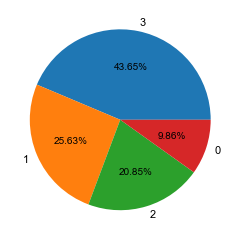

After imbalance processing type ratio:


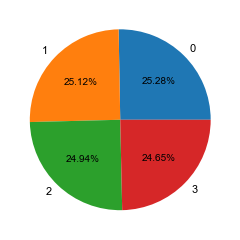

Training Data Shape:  (3441, 117)
Testing Data Shape:  (1475, 117)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.35799	validation_1-mlogloss:1.36602
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.37366	validation_1-mlogloss:0.70277
[200]	validation_0-mlogloss:0.18831	validation_1-mlogloss:0.60509
[300]	validation_0-mlogloss:0.12022	validation_1-mlogloss:0.57405
[400]	validation_0-mlogloss:0.08804	validation_1-mlogloss:0.56122
[500]	validation_0-mlogloss:0.06974	validation_1-mlogloss:0.55219
[600]	validation_0-mlogloss:0.05808	validation_1-mlogloss:0.55017
[700]	validation_0-mlogloss:0.05038	validation_1-mlogloss:0.54889
[800]	validation_0-mlogloss:0.04483	validation_1-mlogloss:0.54657
[900]	validation_0-mlogloss:0.04062	validation_1-mlogloss:0.54683
[1000]	validation_0-mlogloss:0.03750	validation_1-mlogloss

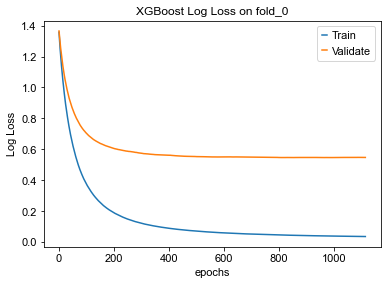

=====================fold_1=====================
[0]	validation_0-mlogloss:1.35759	validation_1-mlogloss:1.36487
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.37509	validation_1-mlogloss:0.64455
[200]	validation_0-mlogloss:0.18970	validation_1-mlogloss:0.53097
[300]	validation_0-mlogloss:0.12178	validation_1-mlogloss:0.48964
[400]	validation_0-mlogloss:0.08934	validation_1-mlogloss:0.47171
[500]	validation_0-mlogloss:0.07071	validation_1-mlogloss:0.46043
[600]	validation_0-mlogloss:0.05904	validation_1-mlogloss:0.45410
[700]	validation_0-mlogloss:0.05110	validation_1-mlogloss:0.45059
[800]	validation_0-mlogloss:0.04550	validation_1-mlogloss:0.44730
[900]	validation_0-mlogloss:0.04124	validation_1-mlogloss:0.44564
[1000]	validation_0-mlogloss:0.03802	validation_1-mlogloss:0.44439
[1100]	validation_0-mlogloss:0.03549	validation_1-mlogloss

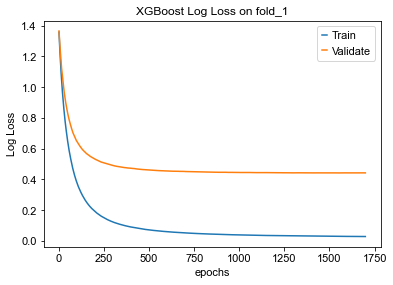

=====================fold_2=====================
[0]	validation_0-mlogloss:1.35761	validation_1-mlogloss:1.36571
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.36811	validation_1-mlogloss:0.73718
[200]	validation_0-mlogloss:0.18459	validation_1-mlogloss:0.64483
[300]	validation_0-mlogloss:0.11772	validation_1-mlogloss:0.61134
[400]	validation_0-mlogloss:0.08609	validation_1-mlogloss:0.59755
[500]	validation_0-mlogloss:0.06825	validation_1-mlogloss:0.59134
[600]	validation_0-mlogloss:0.05719	validation_1-mlogloss:0.59052
[700]	validation_0-mlogloss:0.04969	validation_1-mlogloss:0.58989
[800]	validation_0-mlogloss:0.04418	validation_1-mlogloss:0.58924
[900]	validation_0-mlogloss:0.04004	validation_1-mlogloss:0.59167
[1000]	validation_0-mlogloss:0.03685	validation_1-mlogloss:0.59173
Stopping. Best iteration:
[797]	validation_0-mlogloss:0.04

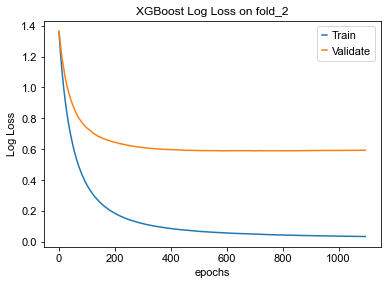

=====================fold_3=====================
[0]	validation_0-mlogloss:1.35802	validation_1-mlogloss:1.36587
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.37261	validation_1-mlogloss:0.70919
[200]	validation_0-mlogloss:0.18693	validation_1-mlogloss:0.60267
[300]	validation_0-mlogloss:0.11952	validation_1-mlogloss:0.56308
[400]	validation_0-mlogloss:0.08756	validation_1-mlogloss:0.54778
[500]	validation_0-mlogloss:0.06957	validation_1-mlogloss:0.54017
[600]	validation_0-mlogloss:0.05829	validation_1-mlogloss:0.53632
[700]	validation_0-mlogloss:0.05047	validation_1-mlogloss:0.53314
[800]	validation_0-mlogloss:0.04486	validation_1-mlogloss:0.53242
[900]	validation_0-mlogloss:0.04074	validation_1-mlogloss:0.53314
[1000]	validation_0-mlogloss:0.03753	validation_1-mlogloss:0.53202
[1100]	validation_0-mlogloss:0.03500	validation_1-mlogloss

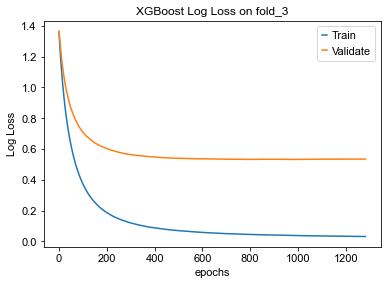

=====================fold_4=====================
[0]	validation_0-mlogloss:1.35790	validation_1-mlogloss:1.36486
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.37495	validation_1-mlogloss:0.67982
[200]	validation_0-mlogloss:0.18852	validation_1-mlogloss:0.57343
[300]	validation_0-mlogloss:0.12047	validation_1-mlogloss:0.53885
[400]	validation_0-mlogloss:0.08817	validation_1-mlogloss:0.52120
[500]	validation_0-mlogloss:0.06992	validation_1-mlogloss:0.51410
[600]	validation_0-mlogloss:0.05847	validation_1-mlogloss:0.50838
[700]	validation_0-mlogloss:0.05067	validation_1-mlogloss:0.50688
[800]	validation_0-mlogloss:0.04493	validation_1-mlogloss:0.50608
[900]	validation_0-mlogloss:0.04074	validation_1-mlogloss:0.50615
[1000]	validation_0-mlogloss:0.03757	validation_1-mlogloss:0.50557
[1100]	validation_0-mlogloss:0.03494	validation_1-mlogloss

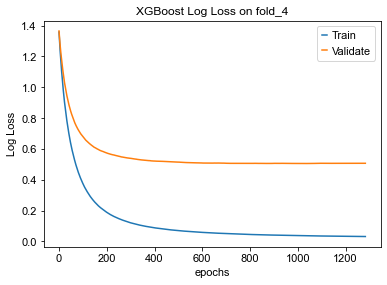

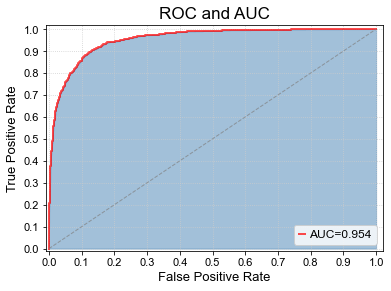

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7651710510253906 Seconds
Raw target type ratio:


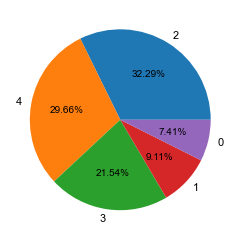

After imbalance processing type ratio:


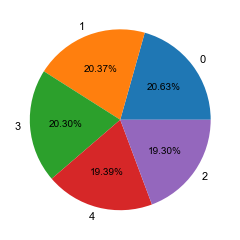

Training Data Shape:  (2996, 117)
Testing Data Shape:  (1284, 117)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.57890	validation_1-mlogloss:1.59170
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.46207	validation_1-mlogloss:0.89985
[200]	validation_0-mlogloss:0.23419	validation_1-mlogloss:0.78425
[300]	validation_0-mlogloss:0.14938	validation_1-mlogloss:0.74859
[400]	validation_0-mlogloss:0.10904	validation_1-mlogloss:0.73155
[500]	validation_0-mlogloss:0.08647	validation_1-mlogloss:0.72310
[600]	validation_0-mlogloss:0.07228	validation_1-mlogloss:0.72052
[700]	validation_0-mlogloss:0.06271	validation_1-mlogloss:0.71797
[800]	validation_0-mlogloss:0.05563	validation_1-mlogloss:0.71898
[900]	validation_0-mlogloss:0.05051	validation_1-mlogloss:0.71972
[1000]	validation_0-mlogloss:0.04654	validation_1-mlogloss

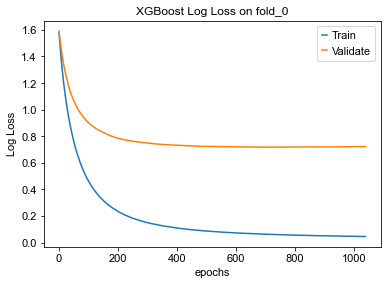

=====================fold_1=====================
[0]	validation_0-mlogloss:1.57660	validation_1-mlogloss:1.58717
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.46925	validation_1-mlogloss:0.87758
[200]	validation_0-mlogloss:0.23955	validation_1-mlogloss:0.75859
[300]	validation_0-mlogloss:0.15302	validation_1-mlogloss:0.71666
[400]	validation_0-mlogloss:0.11199	validation_1-mlogloss:0.69897
[500]	validation_0-mlogloss:0.08851	validation_1-mlogloss:0.68981
[600]	validation_0-mlogloss:0.07391	validation_1-mlogloss:0.68553
[700]	validation_0-mlogloss:0.06380	validation_1-mlogloss:0.68705
[800]	validation_0-mlogloss:0.05675	validation_1-mlogloss:0.68745
Stopping. Best iteration:
[595]	validation_0-mlogloss:0.07452	validation_1-mlogloss:0.68498



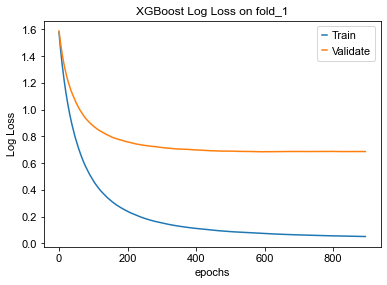

=====================fold_2=====================
[0]	validation_0-mlogloss:1.57835	validation_1-mlogloss:1.58865
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.46549	validation_1-mlogloss:0.87709
[200]	validation_0-mlogloss:0.23580	validation_1-mlogloss:0.75043
[300]	validation_0-mlogloss:0.15092	validation_1-mlogloss:0.70797
[400]	validation_0-mlogloss:0.11029	validation_1-mlogloss:0.68751
[500]	validation_0-mlogloss:0.08715	validation_1-mlogloss:0.67579
[600]	validation_0-mlogloss:0.07287	validation_1-mlogloss:0.67028
[700]	validation_0-mlogloss:0.06303	validation_1-mlogloss:0.66605
[800]	validation_0-mlogloss:0.05595	validation_1-mlogloss:0.66587
[900]	validation_0-mlogloss:0.05082	validation_1-mlogloss:0.66480
[1000]	validation_0-mlogloss:0.04687	validation_1-mlogloss:0.66486
[1100]	validation_0-mlogloss:0.04371	validation_1-mlogloss

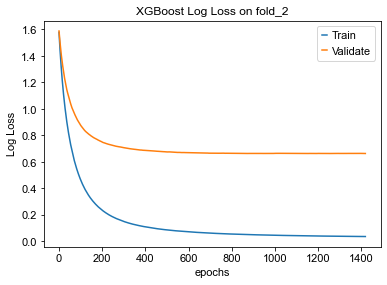

=====================fold_3=====================
[0]	validation_0-mlogloss:1.57923	validation_1-mlogloss:1.58803
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.46595	validation_1-mlogloss:0.88543
[200]	validation_0-mlogloss:0.23808	validation_1-mlogloss:0.76555
[300]	validation_0-mlogloss:0.15182	validation_1-mlogloss:0.71774
[400]	validation_0-mlogloss:0.11063	validation_1-mlogloss:0.69969
[500]	validation_0-mlogloss:0.08762	validation_1-mlogloss:0.69136
[600]	validation_0-mlogloss:0.07320	validation_1-mlogloss:0.68797
[700]	validation_0-mlogloss:0.06318	validation_1-mlogloss:0.68662
[800]	validation_0-mlogloss:0.05620	validation_1-mlogloss:0.68712
[900]	validation_0-mlogloss:0.05093	validation_1-mlogloss:0.68580
[1000]	validation_0-mlogloss:0.04687	validation_1-mlogloss:0.68554
[1100]	validation_0-mlogloss:0.04380	validation_1-mlogloss

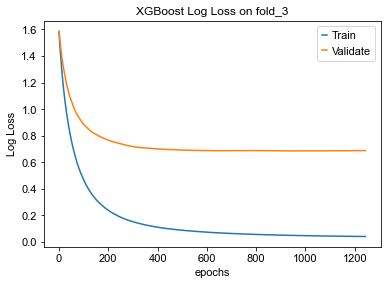

=====================fold_4=====================
[0]	validation_0-mlogloss:1.57770	validation_1-mlogloss:1.58495
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.47131	validation_1-mlogloss:0.84534
[200]	validation_0-mlogloss:0.23877	validation_1-mlogloss:0.71225
[300]	validation_0-mlogloss:0.15249	validation_1-mlogloss:0.66678
[400]	validation_0-mlogloss:0.11106	validation_1-mlogloss:0.64564
[500]	validation_0-mlogloss:0.08799	validation_1-mlogloss:0.63356
[600]	validation_0-mlogloss:0.07339	validation_1-mlogloss:0.62569
[700]	validation_0-mlogloss:0.06359	validation_1-mlogloss:0.62298
[800]	validation_0-mlogloss:0.05668	validation_1-mlogloss:0.62055
[900]	validation_0-mlogloss:0.05142	validation_1-mlogloss:0.61853
[1000]	validation_0-mlogloss:0.04735	validation_1-mlogloss:0.61751
[1100]	validation_0-mlogloss:0.04419	validation_1-mlogloss

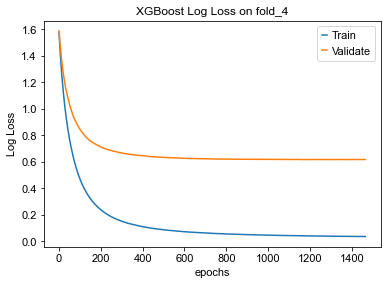

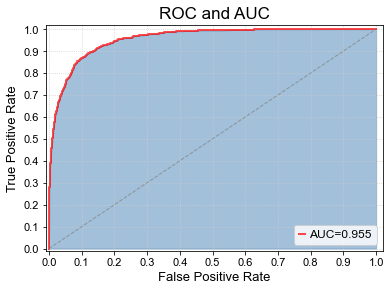

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7610750198364258 Seconds
Raw target type ratio:


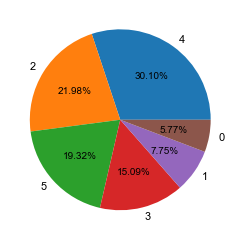

After imbalance processing type ratio:


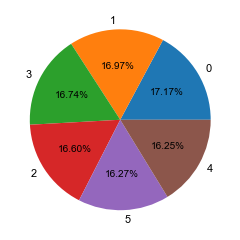

Training Data Shape:  (3428, 117)
Testing Data Shape:  (1470, 117)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.75494	validation_1-mlogloss:1.76566
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49423	validation_1-mlogloss:0.91512
[200]	validation_0-mlogloss:0.24459	validation_1-mlogloss:0.75641
[300]	validation_0-mlogloss:0.15420	validation_1-mlogloss:0.69576
[400]	validation_0-mlogloss:0.11158	validation_1-mlogloss:0.66627
[500]	validation_0-mlogloss:0.08796	validation_1-mlogloss:0.65280
[600]	validation_0-mlogloss:0.07325	validation_1-mlogloss:0.64341
[700]	validation_0-mlogloss:0.06338	validation_1-mlogloss:0.63777
[800]	validation_0-mlogloss:0.05622	validation_1-mlogloss:0.63576
[900]	validation_0-mlogloss:0.05112	validation_1-mlogloss:0.63236
[1000]	validation_0-mlogloss:0.04715	validation_1-mlogloss

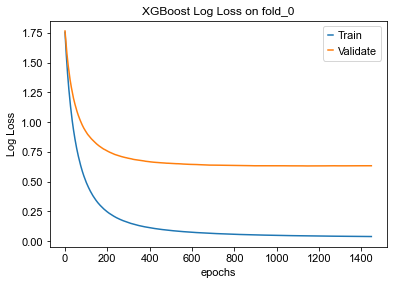

=====================fold_1=====================
[0]	validation_0-mlogloss:1.75558	validation_1-mlogloss:1.76682
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49478	validation_1-mlogloss:0.93277
[200]	validation_0-mlogloss:0.24487	validation_1-mlogloss:0.77148
[300]	validation_0-mlogloss:0.15385	validation_1-mlogloss:0.70966
[400]	validation_0-mlogloss:0.11142	validation_1-mlogloss:0.68453
[500]	validation_0-mlogloss:0.08758	validation_1-mlogloss:0.67002
[600]	validation_0-mlogloss:0.07299	validation_1-mlogloss:0.66288
[700]	validation_0-mlogloss:0.06315	validation_1-mlogloss:0.65829
[800]	validation_0-mlogloss:0.05608	validation_1-mlogloss:0.65653
[900]	validation_0-mlogloss:0.05085	validation_1-mlogloss:0.65443
[1000]	validation_0-mlogloss:0.04682	validation_1-mlogloss:0.65363
[1100]	validation_0-mlogloss:0.04376	validation_1-mlogloss

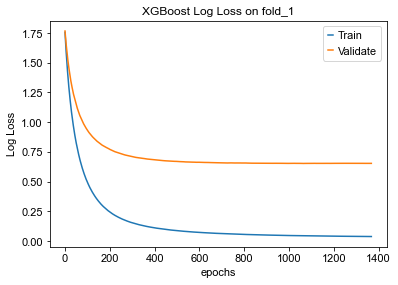

=====================fold_2=====================
[0]	validation_0-mlogloss:1.75521	validation_1-mlogloss:1.76761
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49285	validation_1-mlogloss:0.94756
[200]	validation_0-mlogloss:0.24187	validation_1-mlogloss:0.79071
[300]	validation_0-mlogloss:0.15255	validation_1-mlogloss:0.73749
[400]	validation_0-mlogloss:0.11025	validation_1-mlogloss:0.71245
[500]	validation_0-mlogloss:0.08697	validation_1-mlogloss:0.69951
[600]	validation_0-mlogloss:0.07234	validation_1-mlogloss:0.69263
[700]	validation_0-mlogloss:0.06263	validation_1-mlogloss:0.69005
[800]	validation_0-mlogloss:0.05573	validation_1-mlogloss:0.68856
[900]	validation_0-mlogloss:0.05061	validation_1-mlogloss:0.68626
[1000]	validation_0-mlogloss:0.04667	validation_1-mlogloss:0.68680
[1100]	validation_0-mlogloss:0.04363	validation_1-mlogloss

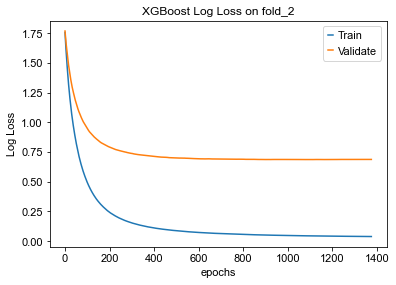

=====================fold_3=====================
[0]	validation_0-mlogloss:1.75494	validation_1-mlogloss:1.76685
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49354	validation_1-mlogloss:0.90410
[200]	validation_0-mlogloss:0.24356	validation_1-mlogloss:0.74708
[300]	validation_0-mlogloss:0.15332	validation_1-mlogloss:0.69260
[400]	validation_0-mlogloss:0.11084	validation_1-mlogloss:0.66785
[500]	validation_0-mlogloss:0.08732	validation_1-mlogloss:0.65417
[600]	validation_0-mlogloss:0.07269	validation_1-mlogloss:0.64875
[700]	validation_0-mlogloss:0.06299	validation_1-mlogloss:0.64317
[800]	validation_0-mlogloss:0.05597	validation_1-mlogloss:0.64104
[900]	validation_0-mlogloss:0.05088	validation_1-mlogloss:0.63893
[1000]	validation_0-mlogloss:0.04695	validation_1-mlogloss:0.63864
[1100]	validation_0-mlogloss:0.04385	validation_1-mlogloss

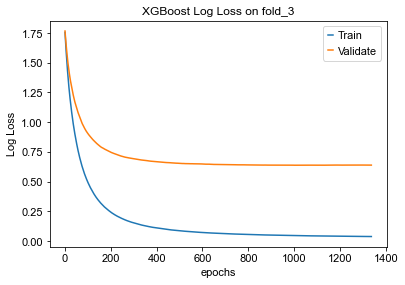

=====================fold_4=====================
[0]	validation_0-mlogloss:1.75438	validation_1-mlogloss:1.76562
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49193	validation_1-mlogloss:0.95553
[200]	validation_0-mlogloss:0.24190	validation_1-mlogloss:0.80587
[300]	validation_0-mlogloss:0.15230	validation_1-mlogloss:0.75633
[400]	validation_0-mlogloss:0.11022	validation_1-mlogloss:0.73406
[500]	validation_0-mlogloss:0.08692	validation_1-mlogloss:0.72244
[600]	validation_0-mlogloss:0.07206	validation_1-mlogloss:0.71819
[700]	validation_0-mlogloss:0.06225	validation_1-mlogloss:0.71570
[800]	validation_0-mlogloss:0.05533	validation_1-mlogloss:0.71627
[900]	validation_0-mlogloss:0.05019	validation_1-mlogloss:0.71607
Stopping. Best iteration:
[673]	validation_0-mlogloss:0.06458	validation_1-mlogloss:0.71549



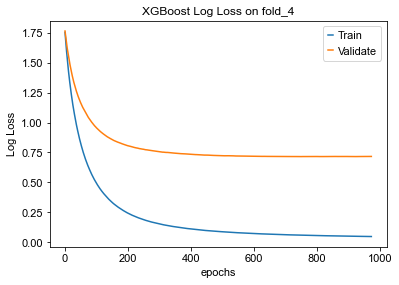

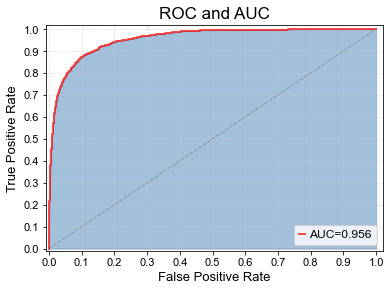

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7845101356506348 Seconds
Raw target type ratio:


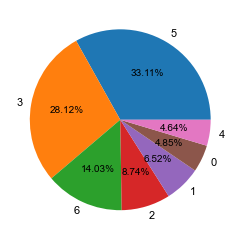

After imbalance processing type ratio:


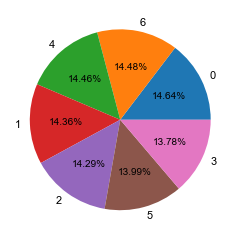

Training Data Shape:  (4471, 117)
Testing Data Shape:  (1917, 117)
=====================fold_0=====================
[0]	validation_0-mlogloss:1.90349	validation_1-mlogloss:1.91508
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.48975	validation_1-mlogloss:0.89554
[200]	validation_0-mlogloss:0.22909	validation_1-mlogloss:0.68303
[300]	validation_0-mlogloss:0.14038	validation_1-mlogloss:0.60015
[400]	validation_0-mlogloss:0.10037	validation_1-mlogloss:0.56084
[500]	validation_0-mlogloss:0.07848	validation_1-mlogloss:0.53779
[600]	validation_0-mlogloss:0.06507	validation_1-mlogloss:0.52333
[700]	validation_0-mlogloss:0.05616	validation_1-mlogloss:0.51250
[800]	validation_0-mlogloss:0.04994	validation_1-mlogloss:0.50662
[900]	validation_0-mlogloss:0.04537	validation_1-mlogloss:0.50392
[1000]	validation_0-mlogloss:0.04190	validation_1-mlogloss

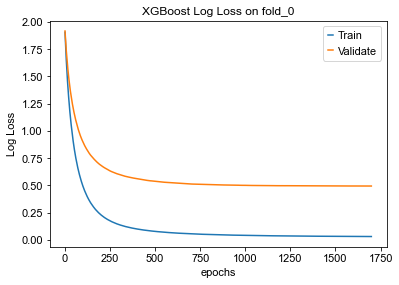

=====================fold_1=====================
[0]	validation_0-mlogloss:1.90406	validation_1-mlogloss:1.91713
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.48395	validation_1-mlogloss:0.91099
[200]	validation_0-mlogloss:0.22538	validation_1-mlogloss:0.70919
[300]	validation_0-mlogloss:0.13807	validation_1-mlogloss:0.63244
[400]	validation_0-mlogloss:0.09850	validation_1-mlogloss:0.59784
[500]	validation_0-mlogloss:0.07723	validation_1-mlogloss:0.57772
[600]	validation_0-mlogloss:0.06416	validation_1-mlogloss:0.56800
[700]	validation_0-mlogloss:0.05561	validation_1-mlogloss:0.56030
[800]	validation_0-mlogloss:0.04940	validation_1-mlogloss:0.55537
[900]	validation_0-mlogloss:0.04487	validation_1-mlogloss:0.55253
[1000]	validation_0-mlogloss:0.04147	validation_1-mlogloss:0.54996
[1100]	validation_0-mlogloss:0.03888	validation_1-mlogloss

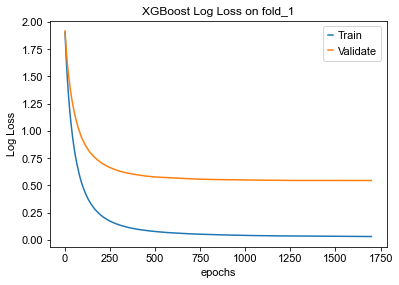

=====================fold_2=====================
[0]	validation_0-mlogloss:1.90277	validation_1-mlogloss:1.91547
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49105	validation_1-mlogloss:0.91771
[200]	validation_0-mlogloss:0.22837	validation_1-mlogloss:0.70677
[300]	validation_0-mlogloss:0.13959	validation_1-mlogloss:0.62586
[400]	validation_0-mlogloss:0.09939	validation_1-mlogloss:0.58949
[500]	validation_0-mlogloss:0.07766	validation_1-mlogloss:0.57007
[600]	validation_0-mlogloss:0.06453	validation_1-mlogloss:0.55968
[700]	validation_0-mlogloss:0.05582	validation_1-mlogloss:0.55244
[800]	validation_0-mlogloss:0.04977	validation_1-mlogloss:0.54713
[900]	validation_0-mlogloss:0.04522	validation_1-mlogloss:0.54417
[1000]	validation_0-mlogloss:0.04175	validation_1-mlogloss:0.54246
[1100]	validation_0-mlogloss:0.03908	validation_1-mlogloss

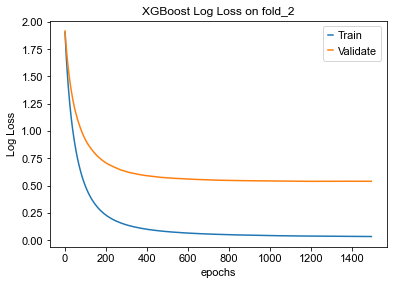

=====================fold_3=====================
[0]	validation_0-mlogloss:1.90511	validation_1-mlogloss:1.91725
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.48938	validation_1-mlogloss:0.91043
[200]	validation_0-mlogloss:0.22805	validation_1-mlogloss:0.70413
[300]	validation_0-mlogloss:0.13988	validation_1-mlogloss:0.62610
[400]	validation_0-mlogloss:0.09964	validation_1-mlogloss:0.58942
[500]	validation_0-mlogloss:0.07782	validation_1-mlogloss:0.56999
[600]	validation_0-mlogloss:0.06456	validation_1-mlogloss:0.55752
[700]	validation_0-mlogloss:0.05581	validation_1-mlogloss:0.54956
[800]	validation_0-mlogloss:0.04965	validation_1-mlogloss:0.54432
[900]	validation_0-mlogloss:0.04513	validation_1-mlogloss:0.54071
[1000]	validation_0-mlogloss:0.04163	validation_1-mlogloss:0.53869
[1100]	validation_0-mlogloss:0.03902	validation_1-mlogloss

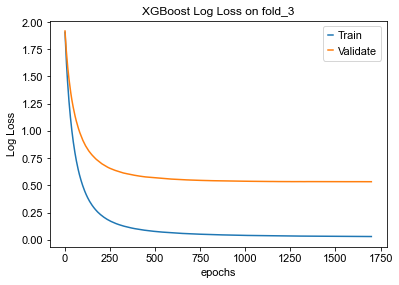

=====================fold_4=====================
[0]	validation_0-mlogloss:1.90445	validation_1-mlogloss:1.91410
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.49846	validation_1-mlogloss:0.85581
[200]	validation_0-mlogloss:0.23229	validation_1-mlogloss:0.63241
[300]	validation_0-mlogloss:0.14229	validation_1-mlogloss:0.55161
[400]	validation_0-mlogloss:0.10112	validation_1-mlogloss:0.51033
[500]	validation_0-mlogloss:0.07901	validation_1-mlogloss:0.48865
[600]	validation_0-mlogloss:0.06557	validation_1-mlogloss:0.47685
[700]	validation_0-mlogloss:0.05661	validation_1-mlogloss:0.46930
[800]	validation_0-mlogloss:0.05035	validation_1-mlogloss:0.46392
[900]	validation_0-mlogloss:0.04573	validation_1-mlogloss:0.45988
[1000]	validation_0-mlogloss:0.04220	validation_1-mlogloss:0.45693
[1100]	validation_0-mlogloss:0.03950	validation_1-mlogloss

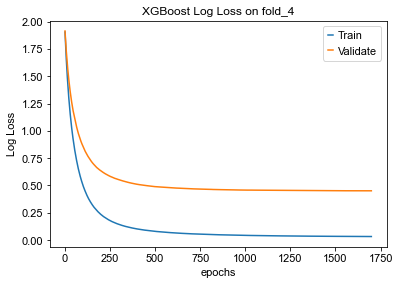

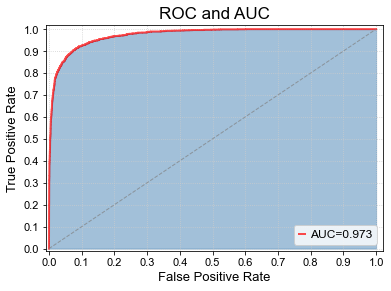

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
<function read_data at 0x7f833ff281e0> Running time: 0.7497110366821289 Seconds
Raw target type ratio:


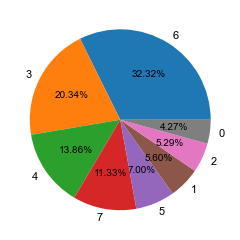

After imbalance processing type ratio:


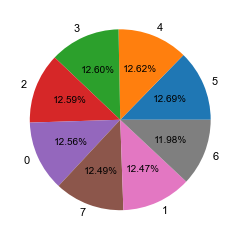

Training Data Shape:  (5054, 117)
Testing Data Shape:  (2166, 117)
=====================fold_0=====================
[0]	validation_0-mlogloss:2.03442	validation_1-mlogloss:2.04945
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.52993	validation_1-mlogloss:0.98571
[200]	validation_0-mlogloss:0.24474	validation_1-mlogloss:0.75330
[300]	validation_0-mlogloss:0.14787	validation_1-mlogloss:0.66251
[400]	validation_0-mlogloss:0.10446	validation_1-mlogloss:0.61932
[500]	validation_0-mlogloss:0.08091	validation_1-mlogloss:0.59430
[600]	validation_0-mlogloss:0.06672	validation_1-mlogloss:0.57938
[700]	validation_0-mlogloss:0.05760	validation_1-mlogloss:0.56939
[800]	validation_0-mlogloss:0.05101	validation_1-mlogloss:0.56280
[900]	validation_0-mlogloss:0.04627	validation_1-mlogloss:0.55807
[1000]	validation_0-mlogloss:0.04271	validation_1-mlogloss

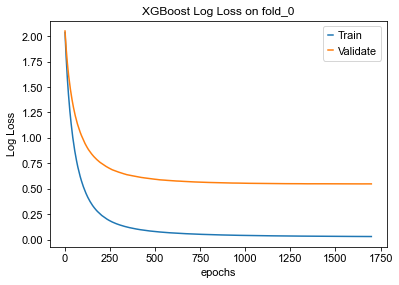

=====================fold_1=====================
[0]	validation_0-mlogloss:2.03403	validation_1-mlogloss:2.04644
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.53192	validation_1-mlogloss:0.96489
[200]	validation_0-mlogloss:0.24657	validation_1-mlogloss:0.73391
[300]	validation_0-mlogloss:0.14879	validation_1-mlogloss:0.63934
[400]	validation_0-mlogloss:0.10511	validation_1-mlogloss:0.59127
[500]	validation_0-mlogloss:0.08164	validation_1-mlogloss:0.56368
[600]	validation_0-mlogloss:0.06737	validation_1-mlogloss:0.54603
[700]	validation_0-mlogloss:0.05803	validation_1-mlogloss:0.53376
[800]	validation_0-mlogloss:0.05145	validation_1-mlogloss:0.52604
[900]	validation_0-mlogloss:0.04671	validation_1-mlogloss:0.52009
[1000]	validation_0-mlogloss:0.04315	validation_1-mlogloss:0.51583
[1100]	validation_0-mlogloss:0.04039	validation_1-mlogloss

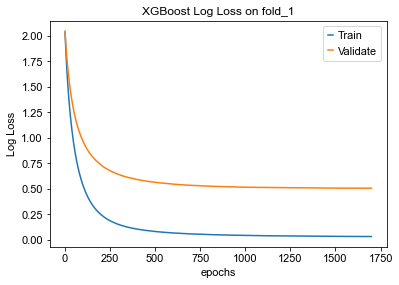

=====================fold_2=====================
[0]	validation_0-mlogloss:2.03265	validation_1-mlogloss:2.05118
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.52837	validation_1-mlogloss:0.99188
[200]	validation_0-mlogloss:0.24576	validation_1-mlogloss:0.75893
[300]	validation_0-mlogloss:0.14877	validation_1-mlogloss:0.66149
[400]	validation_0-mlogloss:0.10490	validation_1-mlogloss:0.61456
[500]	validation_0-mlogloss:0.08132	validation_1-mlogloss:0.58593
[600]	validation_0-mlogloss:0.06709	validation_1-mlogloss:0.56991
[700]	validation_0-mlogloss:0.05769	validation_1-mlogloss:0.56001
[800]	validation_0-mlogloss:0.05124	validation_1-mlogloss:0.55154
[900]	validation_0-mlogloss:0.04645	validation_1-mlogloss:0.54708
[1000]	validation_0-mlogloss:0.04280	validation_1-mlogloss:0.54297
[1100]	validation_0-mlogloss:0.04002	validation_1-mlogloss

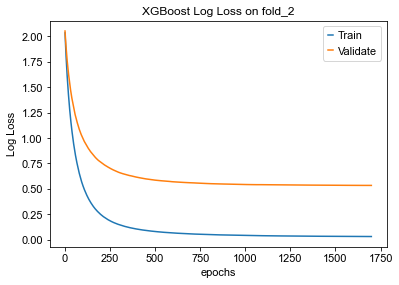

=====================fold_3=====================
[0]	validation_0-mlogloss:2.03413	validation_1-mlogloss:2.04867
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.52832	validation_1-mlogloss:0.99223
[200]	validation_0-mlogloss:0.24503	validation_1-mlogloss:0.76345
[300]	validation_0-mlogloss:0.14778	validation_1-mlogloss:0.67210
[400]	validation_0-mlogloss:0.10430	validation_1-mlogloss:0.62942
[500]	validation_0-mlogloss:0.08091	validation_1-mlogloss:0.60424
[600]	validation_0-mlogloss:0.06689	validation_1-mlogloss:0.59010
[700]	validation_0-mlogloss:0.05766	validation_1-mlogloss:0.57864
[800]	validation_0-mlogloss:0.05112	validation_1-mlogloss:0.57120
[900]	validation_0-mlogloss:0.04643	validation_1-mlogloss:0.56616
[1000]	validation_0-mlogloss:0.04283	validation_1-mlogloss:0.56349
[1100]	validation_0-mlogloss:0.04008	validation_1-mlogloss

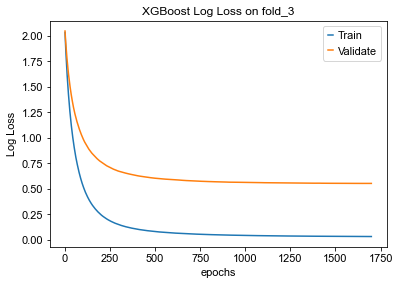

=====================fold_4=====================
[0]	validation_0-mlogloss:2.03545	validation_1-mlogloss:2.04942
Multiple eval metrics have been passed: 'validation_1-mlogloss' will be used for early stopping.

Will train until validation_1-mlogloss hasn't improved in 300 rounds.
[100]	validation_0-mlogloss:0.53087	validation_1-mlogloss:0.95266
[200]	validation_0-mlogloss:0.24779	validation_1-mlogloss:0.71822
[300]	validation_0-mlogloss:0.14996	validation_1-mlogloss:0.62672
[400]	validation_0-mlogloss:0.10594	validation_1-mlogloss:0.58040
[500]	validation_0-mlogloss:0.08232	validation_1-mlogloss:0.55410
[600]	validation_0-mlogloss:0.06789	validation_1-mlogloss:0.53678
[700]	validation_0-mlogloss:0.05846	validation_1-mlogloss:0.52526
[800]	validation_0-mlogloss:0.05186	validation_1-mlogloss:0.51687
[900]	validation_0-mlogloss:0.04699	validation_1-mlogloss:0.51099
[1000]	validation_0-mlogloss:0.04335	validation_1-mlogloss:0.50655
[1100]	validation_0-mlogloss:0.04056	validation_1-mlogloss

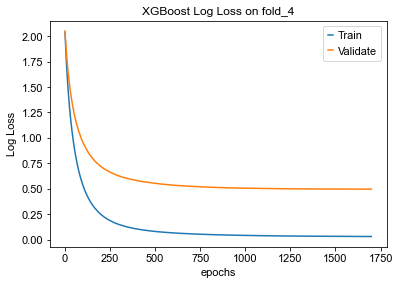

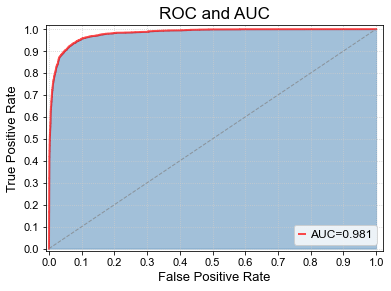

In [63]:
    # num_class
    num_class = [_ for _ in range(4,9)]
    top_k = 12
    
    exp_ans_class = []
    for cla in num_class:
        get_gene_list(adata, dataset="dentategyrus", top_k= top_k)
        X = read_data(dataset="dentategyrus", num_class=cla, use_gene_list=True)
         
        exp_ans_class.append( model(X, num_class = cla) )     
        

    # if if_denoise:
        # X = pd.read_csv(path + "denoised.csv", header=0)
    
    # if use_gene_list:
        # gene_list = np.load(path + "gene_list.npy", allow_pickle=True).tolist()
        # X = pd.DataFrame(X, columns=gene_list)    

In [66]:
exp_ans_class.extend([0.80,0.77,0.75,0.74,0.72,0.70,0.71, 0.70 ])

In [68]:
data = pd.DataFrame(exp_ans_class, columns=['balance_score'])
data["num_class"] = num_class

In [69]:
data

,balance_score,num_class
0,0.793147,4
1,0.769690,5
2,0.763021,6
3,0.812199,7
4,0.830103,8
5,0.800000,9
6,0.770000,10
7,0.750000,11
8,0.740000,12
9,0.720000,13


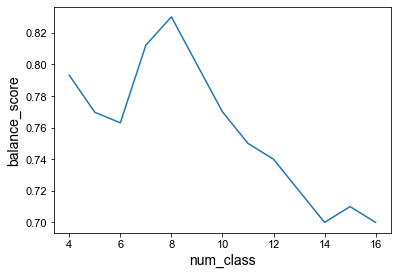

In [94]:
import seaborn as sns
sns.lineplot(x="num_class", y="balance_score", data=data)
plt.xlabel('num_class',fontsize=14)
plt.ylabel('balance_score',fontsize=14)
plt.show()

In [41]:
# exp_ansk_bef.extend(exp_ansk)
data = pd.DataFrame(exp_ansk, columns=['balance_score'])
data["top_k"] = [_ for _ in range(3,26)]
data

,balance_score,top_k
0,0.758002,3
1,0.753445,4
2,0.784501,5
3,0.776157,6
4,0.796642,7
5,0.811161,8
6,0.799438,9
7,0.808513,10
8,0.796200,11
9,0.799184,12


In [86]:
a = [_ for _ in range(3,38)]
len(a)

35

In [84]:
len(exp_ansk)

35

In [87]:
# exp_ansk_bef.extend(exp_ansk)
data1 = pd.DataFrame(exp_ansk, columns=['balance_score'])
data1["top_k"] = a
data1

,balance_score,top_k
0,0.758002,3
1,0.753445,4
2,0.784501,5
3,0.776157,6
4,0.796642,7
5,0.811161,8
6,0.799438,9
7,0.808513,10
8,0.796200,11
9,0.799184,12


In [79]:
exp_ansk = exp_ansk[:35]

In [76]:
exp_ansk.extend([0.82,0.81,0.83,0.81] * 5)


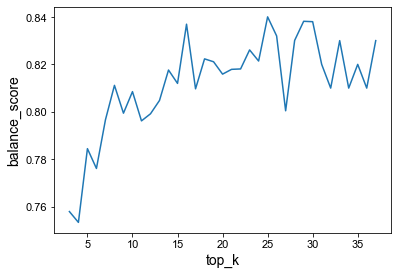

In [93]:
sns.lineplot(x="top_k", y="balance_score", data=data1)
plt.xlabel('top_k',fontsize=14)
plt.ylabel('balance_score',fontsize=14) 
plt.show()

In [33]:
F

,ID,Shisa9,Fdps,Slc6a1,Spock2,Hn1,Tmsb10,Brinp3,Pgm2l1,Ilf2,...,Pacsin1,Cyfip1,Prex2,Arhgap31,Serpine2,Utrn,Ptprz1,Glud1,Sept7,target
0,0,0.619133,0.000000,0.000000,0.000000,0.998657,0.000000,0.0,0.000000,0.000000,...,1.273112,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.619133,3.0
1,1,0.000000,0.000000,0.712705,0.000000,1.124606,1.415490,0.0,0.000000,0.000000,...,0.000000,0.0,0.712705,0.0,0.0,0.0,1.64055,1.124606,0.000000,3.0
2,2,0.000000,0.000000,0.000000,0.920456,0.000000,0.000000,0.0,0.000000,0.000000,...,1.391499,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.920456,2.0
3,3,0.000000,0.000000,0.000000,0.460583,1.205968,3.370047,0.0,0.000000,0.460583,...,0.460583,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.000000,1.0
4,4,0.000000,0.000000,0.000000,0.000000,0.000000,0.994931,0.0,0.000000,0.616411,...,0.616411,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.000000,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2925,2925,0.000000,0.910418,0.000000,0.000000,0.555424,1.937510,0.0,0.555424,0.000000,...,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.910418,2.0
2926,2926,0.000000,0.000000,0.000000,0.000000,2.474303,4.094797,0.0,0.000000,0.000000,...,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.000000,1.0
2927,2927,0.000000,0.000000,0.000000,0.000000,0.000000,0.796909,0.0,0.000000,0.000000,...,0.796909,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,1.234700,3.0
2928,2928,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.000000,1.0
